# London Geographies

Code to support Evans and Wilkens, "Nation, Ethnicity, and the Geography of British Fiction, 1880-1940." *Culural Analyics* (2018).

Every number, statistical comparison, figure, and map that's used in the article can be found in this notebook. That said, we've made no special attempt to match the order of the notebook to the order of presentation in the article. You may need to hunt around to find what you're looking for.

There are also many calculations and results in this notebook that aren't included in the article. These include notes and observations that may not reflect subsequent changes to the corpora and methods. The notebook documents research process; use it as you see fit. The only analytical claims we support are those made in the published article.

## Running this code

If you're reproducing the full results, you'll need a [Mapbox access token](https://www.mapbox.com/help/how-access-tokens-work/). Store it somewhere private and set its location in the first code block below.

Packages used are listed below. The only one that isn't part of a standard (full) Anaconda install is `cartopy` (needed for maps). It's available from Anaconda and can be installed via 

```
conda install cartopy
``` 

A full environment specification is available in the code repo with this notebook. To configure a virtual environment matching the one we used, simply locate the `environment.yml` file and run

```
conda env create -f environment.yml
```

The resulting virtual environment will be named `carto`; activate it with 

```
conda activate carto
```

Once you have the proper environment configured, you can run the full notebook from Jupyter Lab or from the command line:

```
jupyter nbconvert --ExecutePreprocessor.timeout=-1 \
--to notebook --execute <this notebook file.ipynb>
``` 

## Identify corpora

We'll work with four corpora (source details in article text):

* **Foreign**: Foreign authors in Britain. Mostly non-white colonial subjects.
* **Prominent**: Modernist-era writers, including many highly canonical white British authors.
* **London**: Books about London from all periods.
* **Hathi**: All fiction published in Britain (via Ted Underwood's genre research on [public domain volumes](https://analytics.hathitrust.org/genre) and [in-copyright volumes](https://github.com/tedunderwood/hathimetadata/tree/master/fiction)).

## Setup and packages

In [1]:
# Imports and parameters
%matplotlib inline
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from   matplotlib.patches import Ellipse, Rectangle
import seaborn as sns
import os
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from   cartopy.io.img_tiles import MapboxTiles
from   scipy import stats
import statsmodels.formula.api as sm
import statsmodels.stats.api as sms
from   statsmodels.stats.outliers_influence import summary_table
from   IPython.display import display
from   IPython.display import HTML
from   sklearn.metrics.pairwise import paired_euclidean_distances
from   sklearn.preprocessing import StandardScaler
import plotly.plotly as py
import plotly.graph_objs as go
from   sklearn.cluster import KMeans
from   sklearn.decomposition import PCA

ci = 0.95 # Set size of confidence interval. 95% = 0.95
splitdate = 1914 # For era comparisons

# Define colors for use throughout
colors = {
          'Hathi':     'darkblue', 
          'Foreign':   'darkred',
          'London':    'darkgreen',
          'Prominent': 'purple',
          'White':     'steelblue', 
          'Nonwhite':  'darkorange',
          'Fiction':   'darkcyan',
          'Nonfiction':'saddlebrown'
         }

# Directories for input and output
figDir     = os.path.join('figures', 'publication')
resultsDir = os.path.join('results', 'publication')
dataDir    = os.path.join(resultsDir, 'data')
os.makedirs(figDir, exist_ok=True)
os.makedirs(resultsDir, exist_ok=True)
os.makedirs(dataDir, exist_ok=True)

mapbox_key_file = '/Users/mwilkens/Google Drive/Private/mapbox-api-key.txt'

sns.set()
sns.set_context('talk')
plt.rcParams['figure.figsize'] = (12.0, 8.0)

### Defined location sets

We examine these toward the end of the notebook. Defining here for consistency. Odd capitalization due to automated regularization. Note two types of apostrophe:  ' != ’.

In [2]:
# Define place lists for targeted interest

cultural = frozenset([    
    'British Museum',
    'London Library',
    'South Kensington Museum',
    'National Gallery'
])

parks = frozenset([    
    'Hyde Park', 
    'Kew',
    'Kew Gardens',
    'Kensington Gardens',
    'Green Park',
    'St. James\'S Park',
    'St. James\' Park',
    'St Jame\'S Park',
    'St. James’S Park',
    'Regents Park',
    'Regent’S Park',
    'Regent\'S Park',
    'Regent Park'
])

political = frozenset([    
    'Hyde Park Corner', 
    'Westminster',
    'Downing Street'
])

river = frozenset([    
    'Thames',
    'River Thames',
    'Thames River',
    'Victoria Embankment',
    'Victoria Embankment Gardens',
    'Embankment Gardens',
    'Westminster Bridge',
    'Waterloo Bridge',
    'London Bridge',
    'Blackfriars Bridge',
    'Blackfriar\'S Bridge'
])

stations = frozenset([    
    'Waterloo Station',
    'Victoria Station',
    'Paddington Station',
    'Paddington',
    'Euston Station',
    'St. Pancras Station',
    'St. Pancras',
    'St Pancras'
])

misc = frozenset([    
    'Soho',
    'Bloomsbury',
    'Buckingham Palace',
    'Trafalgar Square',
    'City',
    'City Of London'
])

not_in_london = frozenset([    
    'Thames',
    'Thames River',
    'River Thames',
    'Kew Gardens'
])

soho = frozenset([    
    'Soho'
])

bloomsbury = frozenset([    
    'Bloomsbury'
])

bloomsburyparts = frozenset([    
    'Tottenham Court Road',
    'Euston Road',
    'Gray\'S Inn Road',
    'Gray’S Inn Road',
    'Russell Square'
])

rich = frozenset([    
    'Bond Street',
    'Chelsea',
    'Mayfair',
    'Belgravia',
    'Park Lane'
])

poor = frozenset([    
    'East End',
    'East End Of London',
    'Limehouse',
    'West India Dock Road',
    'East India Dock Road',
    'Whitechapel',
    'Mile End Road'
])


specified_places = cultural.union(parks, political, river, stations, misc, soho, bloomsbury, bloomsburyparts)

### Read in data and perform initial processing

In [3]:
# Read in data
data = pd.read_csv(os.path.join(dataDir, 'data.tsv.gz'), sep='\t', low_memory=False)
data['occurs_100k'] = data['occurs']*100000/data['wordcount']

# Group the data by corpus and generate subsets to be used below
corpus_grouped        = data.groupby('corpus')
corpus_gb_grouped     = data.loc[(data.country_short=='GB')].groupby('corpus')
corpus_nongb_grouped  = data.loc[(data.country_short!='GB')].groupby('corpus')
corpus_london_grouped = data.loc[(data.country_short == 'GB') &
                                 ((data.admin_2 == 'Greater London') |
                                 (data.text_string.isin(not_in_london)))].groupby('corpus')

# Build dataframe that's just the corpus with metadata, not geo.
# Much smaller than full dataset, useful for some quickies below
metadata = data[['htid', 'corpus','author', 'title', 'pub_date', 
                 'genre', 'gender', 'white', 'origin_area', 'origin_nation',
                 'wordcount'
                ]].drop_duplicates()
metadata_grouped = metadata.groupby('corpus')

print("Unique HTIDs across all corpora:", data.htid.nunique())
print("\nVolumes per corpus:", corpus_grouped.htid.nunique())

Unique HTIDs across all corpora: 10765

Volumes per corpus: corpus
Foreign        130
Hathi        10010
London         171
Prominent      576
Name: htid, dtype: int64


In [4]:
metadata_grouped.describe()

pub_date                                                           \
             count         mean        std     min      25%     50%     75%   
corpus                                                                        
Foreign      130.0  1920.153846  16.640038  1883.0  1908.25  1925.0  1934.0   
Hathi      10010.0  1907.605095  16.357689  1880.0  1894.00  1906.0  1921.0   
London       171.0  1910.807018  14.933309  1880.0  1899.00  1909.0  1922.5   
Prominent    576.0  1916.342014  15.516702  1880.0  1905.00  1919.0  1929.0   

                  wordcount                                                  \
              max     count           mean           std      min       25%   
corpus                                                                        
Foreign    1940.0     130.0   93394.515385  57145.075982   6195.0  52189.25   
Hathi      1940.0   10010.0  101074.109990  67049.730054    537.0  58102.00   
London     1939.0     171.0  109176.941520  65221.343144  14370.0  71552.00   
Prominent  1940.0     576.0  107277.675347  61945.222331   1285.0  71329.75   

                                          
               50%        75%        max  
corpus                                    
Foreign    88296.5  123673.00   363576.0  
Hathi      87400.0  126122.75  1304084.0  
London     93967.0  127212.50   466071.0  
Prominent  95561.0  130432.25   533458.0

In [5]:
# Output individual corpus listings for easy examination
for name, group in metadata_grouped:
    group.to_csv(os.path.join(resultsDir, 'corpus_listing_'+name+'.csv'), index=False)

## Plots of basic corpus shapes

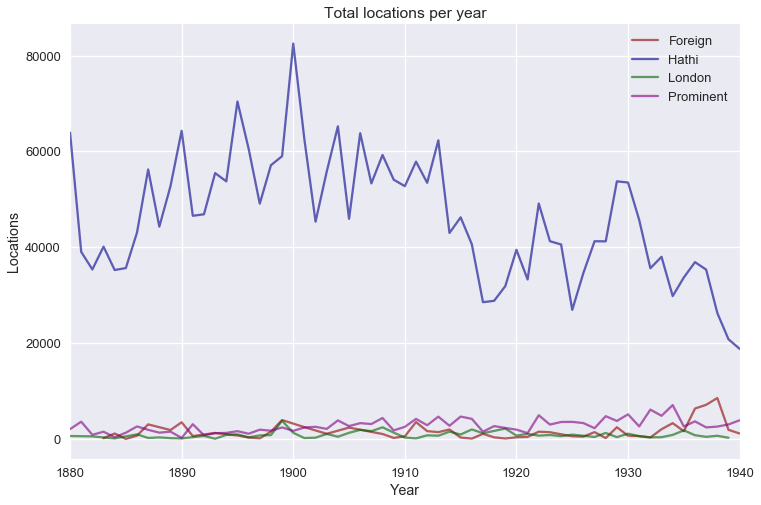

In [6]:
# Total locations per year
plt.figure()
ax = plt.axes()
for name, group in corpus_grouped:
    group.groupby('pub_date').occurs.sum().plot(color=colors[name], alpha=0.6, label=name)
plt.title("Total locations per year")
plt.legend()
plt.ylabel('Locations')
plt.xlabel('Year')
plt.savefig(os.path.join(figDir, 'locs-by-corpus.png'), dpi=300)

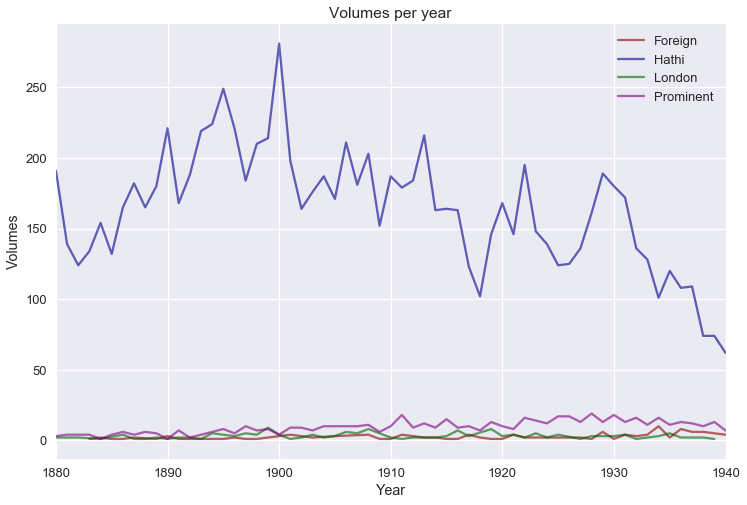

In [7]:
# Ditto, but for volumes per year
plt.figure()
ax = plt.axes()
for name, group in corpus_grouped:
    group.groupby('pub_date').htid.nunique().plot(color=colors[name], alpha=0.6, label=name)
plt.title("Volumes per year")
plt.legend()
plt.ylabel('Volumes')
plt.xlabel('Year')
plt.savefig(os.path.join(figDir, 'vols-by-corpus-line.png'), dpi=300)

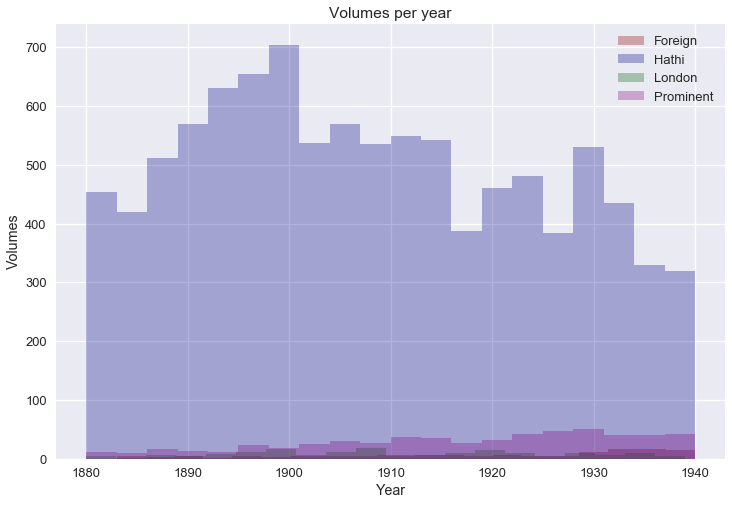

In [8]:
# Double ditto, but a histogram
pdh = data[['htid', 'corpus', 'pub_date']]
pdh.head()
pdh = pdh.drop_duplicates()
pdhg = pdh.groupby('corpus')
for name, group in pdhg:
    group.pub_date.plot.hist(bins=20, alpha=0.3, color=colors[name], label=name)
plt.title("Volumes per year")
plt.legend()
plt.xlabel("Year")
plt.ylabel("Volumes")
plt.savefig(os.path.join(figDir, 'vols-by-corpus.png'), dpi=300)

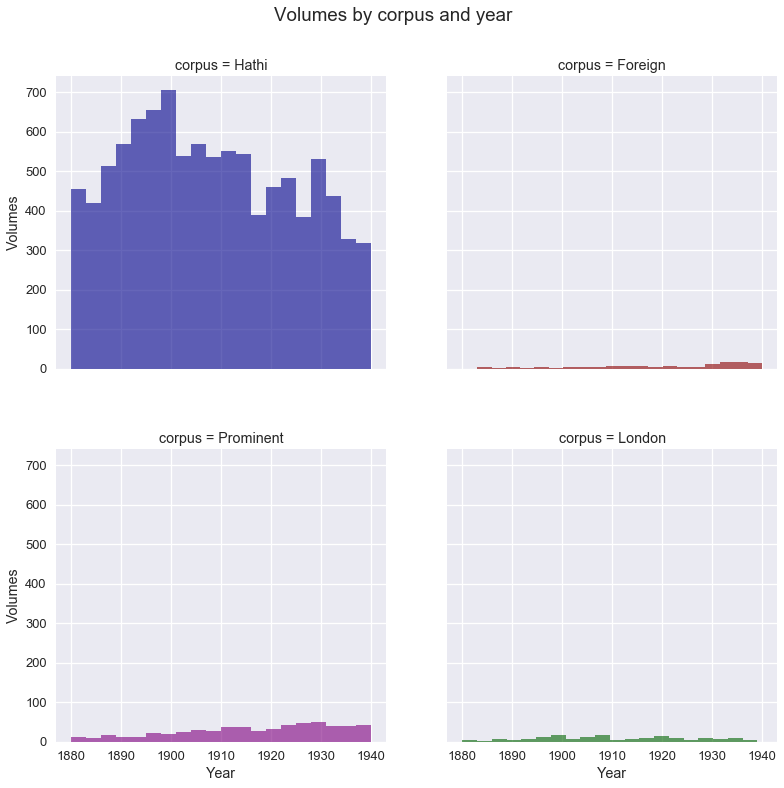

In [9]:
# All corpora, shared axis scales
g = sns.FacetGrid(pdh, col="corpus", hue="corpus", palette=colors, col_wrap=2)
g = g.map(plt.hist, "pub_date", bins=20, alpha = 0.6)
plt.subplots_adjust(top=0.9)
g.fig.suptitle("Volumes by corpus and year")
g.set_axis_labels("Year", "Volumes")
g.fig.set_size_inches(12,12)
plt.savefig(os.path.join(figDir, 'vols-by-corpus-multi.png'), dpi=300)

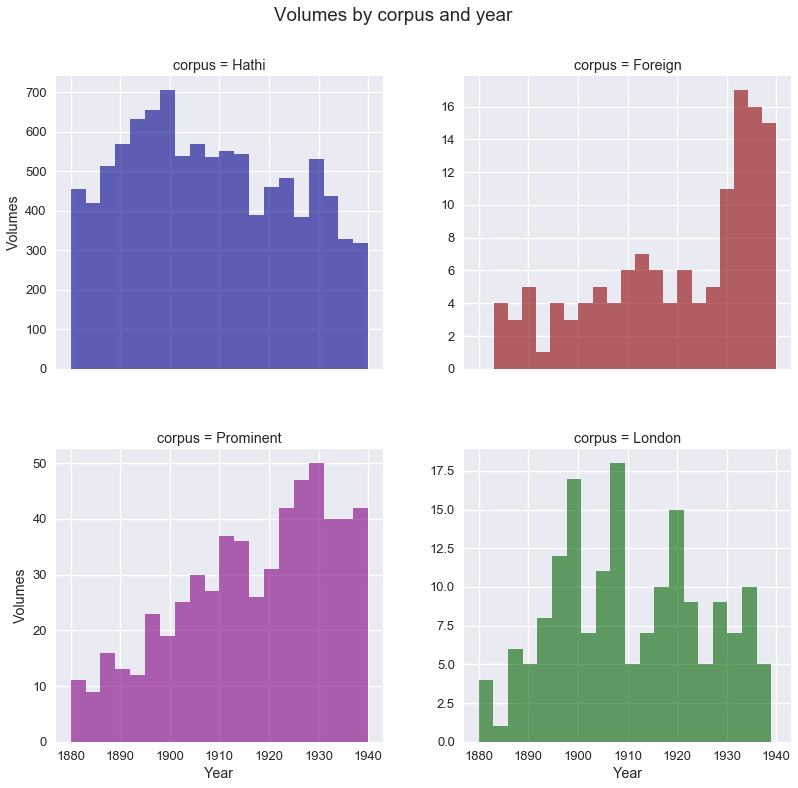

In [10]:
# All corpora, different y-axis scales
g = sns.FacetGrid(pdh, col="corpus", hue="corpus", palette=colors, col_wrap=2, sharey=False)
g = g.map(plt.hist, "pub_date", bins=20, alpha = 0.6)
plt.subplots_adjust(top=0.9)
g.fig.suptitle("Volumes by corpus and year")
g.set_axis_labels("Year", "Volumes")
g.fig.set_size_inches(12,12)
plt.savefig(os.path.join(figDir, 'vols-by-corpus-multi-alt.png'), dpi=300)

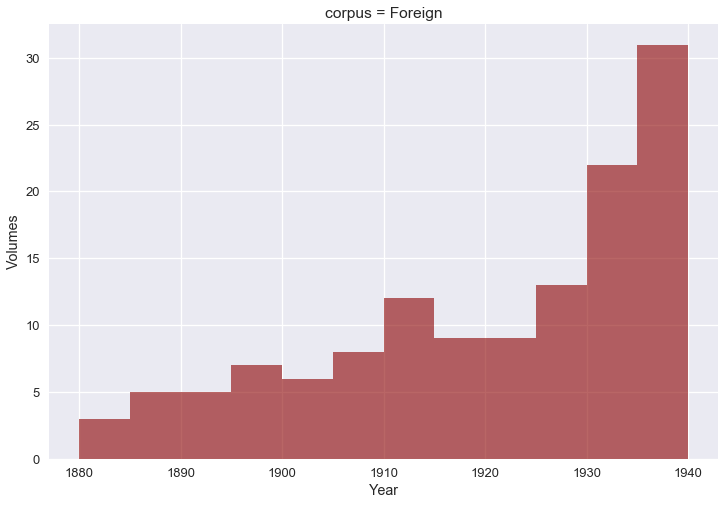

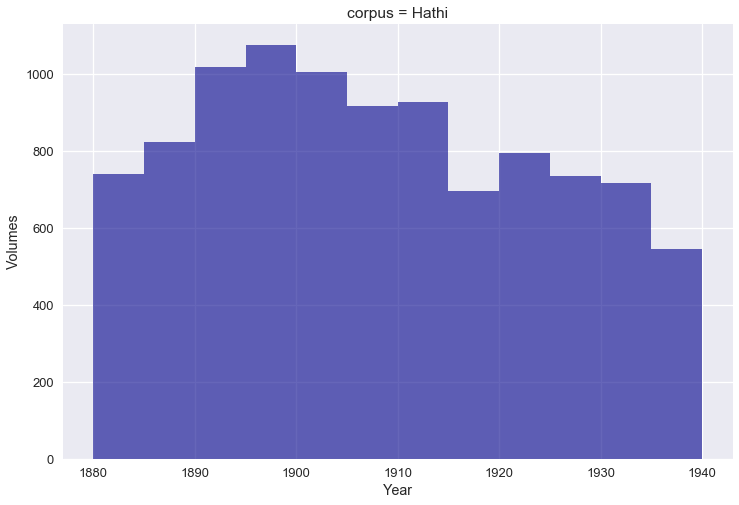

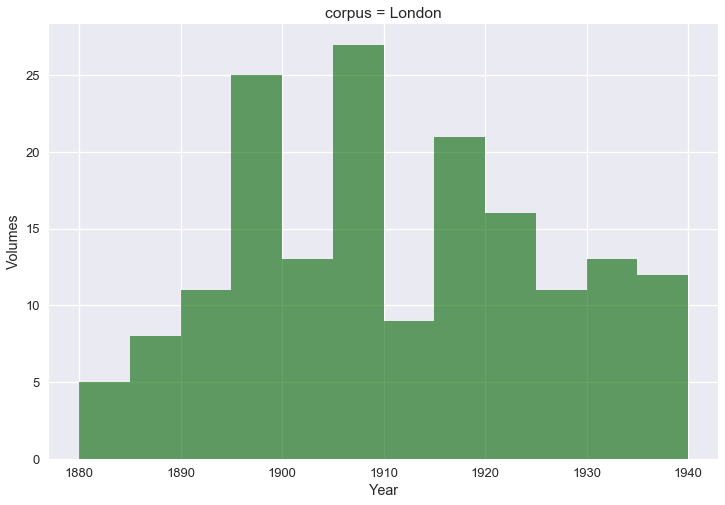

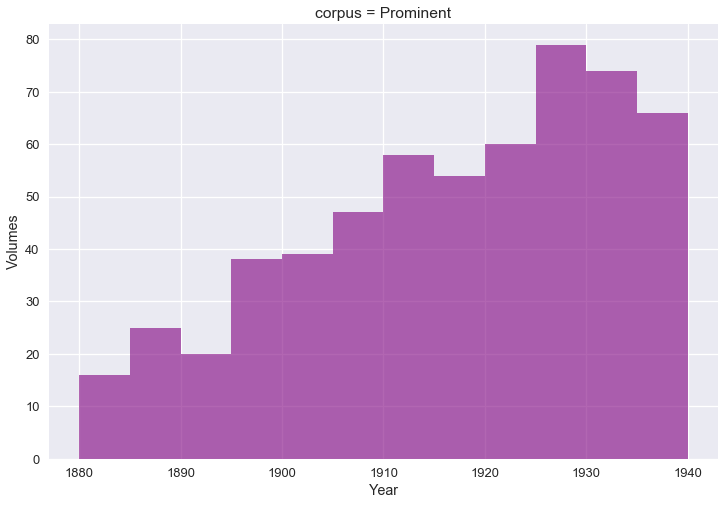

In [11]:
# Individual histograms per corpus
histbins = list(range(1880,1941,5))
for name, group in pdhg:
    plt.figure()
    ttl = "corpus = "+name
    fig = group.pub_date.hist(bins=histbins, color=colors[name], alpha=0.6)
    plt.xlabel("Year")
    plt.ylabel("Volumes")
    plt.title(ttl)
    plt.savefig(os.path.join(figDir, 'vols-'+name+'.png'), dpi=300)

## Statistical testing w/ confidence intervals

### Note on statistics

There are a few spots below where we calculate raw frequencies. These are for reference, especially so that we can tell when we're dealing with cases of literally one or two or a few individual metions of a place across a corpus. 

But for analysis in the publication, we always use location counts per 100,000 words in order to normalize volume length. The reasoning here is that long books aren't more important, systematically, than short books. Long books mention more places, but that doesn't make them more geographically intensive nor their geography more significant.

When we calculate averages across corpora or subsets thereof, we sum the per-100k rates and divide by the number of volumes. This means that geographically *intensive* volumes count more than non-intensive ones. For counting stats, this doesn't matter. But for ratios, it does. For example, if one book mentions 2,000 places in the UK per 100k words, of which 1,000 are in London, and another mentions 10 places, of which 1 is in London, the average ratio of London/UK we calculate is 1001/2010 = 49.8% and not (50% + 10%)/2 = 30%.

This decision to allow geo-intensive volumes to carry more weight can have a big effect in small corpora, but it matters even in larger ones. There are a lot of books that simply don't mention many places. In those books, it's easy to mention, say, "Britain" once. If that's the only place mention, that book is, by our numbers, 100% about the UK, 0% about the rest of the world, and 0% about London. That DOES NOT MEAN, we argue, the same thing as a book that's deeply about Britain, and so it shouldn't be counted as if it were.

In [12]:
# Functions for confidence intervals and significance testing
def sig_label(pvalue):
    sig = ''
    if (np.array(pvalue) < 0.05).any():
        sig = '#'
    if (np.array(pvalue) < 0.01).any():
        sig = '##'
    if (np.array(pvalue) < 0.001).any():
        sig = '###'
    return(sig)

def compare_groups(df, column, weight, ci, filename, precision):
    done = []
    results = []
    for name, group in df:
        done.append(name)
        if weight is None:
            g1 = sms.DescrStatsW(group[column])
        else:
            g1 = sms.DescrStatsW(group[column], group[weight])
        g1_mean = g1.mean
        g1_low, g1_high = g1.tconfint_mean(alpha=1-ci)
        for name_target, group_target in df:
            if name_target not in done:
                if weight is None:
                    g2 = sms.DescrStatsW(group_target[column])
                    pval = sms.ttest_ind(group[column], group_target[column])[1]
                else:
                    g2 = sms.DescrStatsW(group_target[column],
                                         group_target[weight])
                    pval = sms.ttest_ind(group[column], group_target[column], 
                                         weights=(group[weight], group_target[weight]))[1]
                g2_mean = g2.mean
                g2_low, g2_high = g2.tconfint_mean(alpha=1-ci)
                sig = sig_label(pval)
                results.append((name, g1_low, g1_mean, g1_high, 
                                name_target, g2_low, g2_mean, g2_high,
                                pval, sig))
    labels = ['Group 1', 'Low 1', 'MEAN 1', 'High 1', 
              'Group 2', 'Low 2', 'MEAN 2', 'High 2', 
              'p-value', 'sig']
    df = pd.DataFrame.from_records(results, columns=labels)
    pd.set_option('precision', precision)
    df.to_csv(os.path.join(resultsDir, filename+'.tsv'), sep='\t', index=False)
    return(df)

### Publication dates, unweighted

In [13]:
print("Mean publication date")

result = compare_groups(metadata_grouped, 'pub_date', None, ci, 'pub_date_mean_by_corpus', 1)
result

### USE FOR PUBLICATION ###
Mean publication date


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,1917.3,1920.2,1923.0,Hathi,1907.3,1907.6,1907.9,4.2e-18,###
1,Foreign,1917.3,1920.2,1923.0,London,1908.6,1910.8,1913.1,5.5e-07,###
2,Foreign,1917.3,1920.2,1923.0,Prominent,1915.1,1916.3,1917.6,1.3e-02,#
3,Hathi,1907.3,1907.6,1907.9,London,1908.6,1910.8,1913.1,1.1e-02,#
4,Hathi,1907.3,1907.6,1907.9,Prominent,1915.1,1916.3,1917.6,1.3e-35,###
5,London,1908.6,1910.8,1913.1,Prominent,1915.1,1916.3,1917.6,4.0e-05,###


### Using weighted values

In many cases, we'll proceed by calculating a per-volume value, then running stats across all volumes, considering each volume as an independent observation. To weight volumes by geo-intensivity (or other metric), so that we don't swamp good data with low-info cases when we take an average of avergages (bad!), we can generate weights as the fraction by which each volume is over/under the (sub)corpus average.

Note that it's important for the weights to be done this way (with values centering around 1), and not just as raw counts (with values possibly very high), because the latter produces artificially narrow confidence bands.

### Publication dates, weighted

In [14]:
# Occurrence-weighted pub dates for comparison to volume-weighted ones above
print("Average pub date, weighted by occurrences")

# Build weighted dataframe
output = []
for name, group in corpus_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        pub_date = vol.pub_date.mean()
        output.append((name, pub_date, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'pub_date', 'weight']

# Group and run tests
df = df.groupby('corpus')
result = compare_groups(df, 'pub_date', 'weight', ci, 'pub_date_mean_occurrence_weighted_by_corpus', 1)
result

Average pub date, weighted by occurrences


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,1914.5,1917.7,1920.8,Hathi,1907.6,1907.9,1908.2,1.1e-11,###
1,Foreign,1914.5,1917.7,1920.8,London,1908.7,1910.9,1913.1,3.6e-04,###
2,Foreign,1914.5,1917.7,1920.8,Prominent,1914.3,1915.6,1916.9,1.9e-01,
3,Hathi,1907.6,1907.9,1908.2,London,1908.7,1910.9,1913.1,1.7e-02,#
4,Hathi,1907.6,1907.9,1908.2,Prominent,1914.3,1915.6,1916.9,2.9e-28,###
5,London,1908.7,1910.9,1913.1,Prominent,1914.3,1915.6,1916.9,5.7e-04,###


In [15]:
# Total occurrences per corpus
print(corpus_grouped.occurs.sum())

corpus
Foreign        80042
Hathi        2818951
London         47750
Prominent     169597
Name: occurs, dtype: int64


In [16]:
# Avg occurrences per volume per corpus
print('Average raw occurrences per volume')
print(round((corpus_grouped.occurs.sum() / corpus_grouped.htid.nunique()),1))

Average raw occurrences per volume
corpus
Foreign      615.7
Hathi        281.6
London       279.2
Prominent    294.4
dtype: float64


In [17]:
# Avg volume length per corpus
print("Average words per volume")

for name, group in corpus_grouped:
    wordspervol = group.groupby('htid').wordcount.mean()
    totalwords  = wordspervol.sum()
    print(name,'  \t', int(totalwords/group.htid.nunique()))
data_by_vol = data.groupby('htid')
print("\nTotal\t\t", int(data_by_vol.wordcount.mean().sum()/data.htid.nunique()))

Average words per volume
Foreign   	 93394
Hathi   	 101074
London   	 109176
Prominent   	 107277

Total		 101598


### Occurrence counts per 100k words

#### All locations

In [18]:
# Mean occurrence count per 100k words by corpus
print("Mean occurrence count per 100k words by corpus")

# Build unweighted dataframe
output = []
for name, group in corpus_grouped:
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        occurs_100k = vol.occurs_100k.sum()
        output.append((name, occurs_100k))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'occurs_100k']

# Group and run tests
df = df.groupby('corpus')
result = compare_groups(df, 'occurs_100k', None, ci, 'occurs_100k_by_corpus', 1)
result

### USE FOR PUBLICATION ###
Mean occurrence count per 100k words by corpus


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,535.9,617.1,698.3,Hathi,276.7,280.6,284.4,1.2e-76,###
1,Foreign,535.9,617.1,698.3,London,249.5,273.1,296.6,3.0e-17,###
2,Foreign,535.9,617.1,698.3,Prominent,254.6,267.2,279.7,2.5e-43,###
3,Hathi,276.7,280.6,284.4,London,249.5,273.1,296.6,6.2e-01,
4,Hathi,276.7,280.6,284.4,Prominent,254.6,267.2,279.7,1.1e-01,
5,London,249.5,273.1,296.6,Prominent,254.6,267.2,279.7,6.6e-01,


#### Just GB locations

In [19]:
# GB occurs/100k words by corpus
print("Mean GB (including 'Britain', etc.) occurrence count per 100k words by corpus")

# Build unweighted dataframe
output = []
for name, group in corpus_gb_grouped:
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        occurs_100k = vol.occurs_100k.sum()
        output.append((name, occurs_100k))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'occurs_100k']

# Group and run tests
df = df.groupby('corpus')
result = compare_groups(df, 'occurs_100k', None, ci, 'occurs_100k_gb_by_corpus', 1)
result

### USE FOR PUBLICATION ###
Mean GB (including 'Britain', etc.) occurrence count per 100k words by corpus


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,87.9,113.8,139.8,Hathi,78.9,80.6,82.3,2.5e-05,###
1,Foreign,87.9,113.8,139.8,London,138.4,154.8,171.3,6.2e-03,##
2,Foreign,87.9,113.8,139.8,Prominent,94.5,100.7,106.9,1.5e-01,
3,Hathi,78.9,80.6,82.3,London,138.4,154.8,171.3,2.5e-28,###
4,Hathi,78.9,80.6,82.3,Prominent,94.5,100.7,106.9,6.0e-08,###
5,London,138.4,154.8,171.3,Prominent,94.5,100.7,106.9,4.3e-13,###


#### Just London locations

In [20]:
# London occurs/100k words by corpus
print("Mean London (including 'London', etc.) occurrence count per 100k words by corpus")

# Build unweighted dataframe
output = []
for name, group in corpus_london_grouped:
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        occurs_100k = vol.occurs_100k.sum()
        output.append((name, occurs_100k))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'occurs_100k']

# Group and run tests
df = df.groupby('corpus')
result = compare_groups(df, 'occurs_100k', None, ci, 'occurs_100k_london_by_corpus', 1)
result

### USE FOR PUBLICATION ###
Mean London (including 'London', etc.) occurrence count per 100k words by corpus


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,33.9,52.1,70.2,Hathi,32.4,33.3,34.2,7.4e-06,###
1,Foreign,33.9,52.1,70.2,London,92.5,106.1,119.7,2.6e-06,###
2,Foreign,33.9,52.1,70.2,Prominent,44.1,47.8,51.6,4.7e-01,
3,Hathi,32.4,33.3,34.2,London,92.5,106.1,119.7,1.7e-95,###
4,Hathi,32.4,33.3,34.2,Prominent,44.1,47.8,51.6,3.3e-14,###
5,London,92.5,106.1,119.7,Prominent,44.1,47.8,51.6,1.5e-27,###


### Subcorpus demographics

A simple counting breakdown of author gender, ethnicity, and origin area in the corpora where we have that info (Foreign and Prominent).

In [21]:
# Summary stats by gender/race/origin in 'Foreign' and 'Prominent'
for name, group in metadata_grouped:
    if name in ['Foreign', 'Prominent']:
        print('\n###', name, '###\n')
        print('Total volumes:', group.htid.nunique())
        print()
        print(group.groupby('gender').htid.nunique())
        print()
        print(group.groupby('white').htid.nunique())
        print()
        print(group.groupby('origin_area').htid.nunique())
        print()
        print(group.groupby('origin_nation').htid.nunique())
        print()


### Foreign ###

Total volumes: 130

gender
Female    32
Male      97
Name: htid, dtype: int64

white
Nonwhite    88
White       42
Name: htid, dtype: int64

origin_area
Australasia            5
Britain                3
Caribbean             28
East Asia              5
North Africa           2
North America          5
South Asia            50
Sub-Saharan Africa    32
Name: htid, dtype: int64

origin_nation
                           1
Australia                  5
Barbados Or Montserrat    12
Canada                     4
Dominica                   4
Egypt                      1
England                    3
Guyana                     1
India                     50
Jamaica                    3
Japan                      5
Kenya                      1
Nigeria                    2
South Africa              28
Toro (Uganda)              1
Trinidad                   6
Us                         1
West Africa                1
Name: htid, dtype: int64


### Prominent ###

Total volumes: 576

g

## List top locations per corpus

All lists written to CSV for examination by hand.

In [22]:
# Per 100k words and raw
for name, group in corpus_grouped:
    top_raw     = pd.DataFrame(group.groupby('text_string').occurs.sum())
    top_strings = group.groupby('text_string').occurs_100k.sum()
    top_strings = pd.DataFrame(round(top_strings/group.htid.nunique(),2))
    top_strings = top_strings.sort_values(by='occurs_100k', ascending=False).head(150)
    top_strings = top_strings.merge(top_raw, left_index=True, right_index=True)
    top_strings.to_csv(os.path.join(resultsDir, 'top_locations_'+name+'.csv'))

In [23]:
# Ditto, but before and after 1914
for name, group in corpus_grouped:
    pre  = group.loc[(group.pub_date <  splitdate)]
    post = group.loc[(group.pub_date >= splitdate)]
    # Pre
    top_raw     = pd.DataFrame(pre.groupby('text_string').occurs.sum())
    top_strings = pre.groupby('text_string').occurs_100k.sum()
    top_strings = pd.DataFrame(round(top_strings/pre.htid.nunique(),2))
    top_strings = top_strings.sort_values(by='occurs_100k', ascending=False).head(150)
    top_strings = top_strings.merge(top_raw, left_index=True, right_index=True)
    top_strings.to_csv(os.path.join(resultsDir, 'top_locations_'+name+'_pre'+str(splitdate)+'.csv'))
    # Post
    top_raw     = pd.DataFrame(post.groupby('text_string').occurs.sum())
    top_strings = post.groupby('text_string').occurs_100k.sum()
    top_strings = pd.DataFrame(round(top_strings/post.htid.nunique(),2))
    top_strings = top_strings.sort_values(by='occurs_100k', ascending=False).head(150)
    top_strings = top_strings.merge(top_raw, left_index=True, right_index=True)
    top_strings.to_csv(os.path.join(resultsDir, 'top_locations_'+name+'_post'+str(splitdate)+'.csv'))

In [24]:
# Ditto for white/nonwhite within Foreign corpus
ethnicity = corpus_grouped.get_group('Foreign').groupby('white')
for name, group in ethnicity:
    top_raw     = pd.DataFrame(group.groupby('text_string').occurs.sum())
    top_strings = group.groupby('text_string').occurs_100k.sum()
    top_strings = pd.DataFrame(round(top_strings/group.htid.nunique(),2))
    top_strings = top_strings.sort_values(by='occurs_100k', ascending=False).head(150)
    top_strings = top_strings.merge(top_raw, left_index=True, right_index=True)
    top_strings.to_csv(os.path.join(resultsDir, 'top_locations_Foreign_'+name+'.csv'))

In [25]:
# Top London locations per 100k words and raw
for name, group in corpus_london_grouped:
    top_raw     = pd.DataFrame(group.groupby('text_string').occurs.sum())
    top_strings = group.groupby('text_string').occurs_100k.sum()
    top_strings = pd.DataFrame(round(top_strings/group.htid.nunique(),2))
    top_strings = top_strings.sort_values(by='occurs_100k', ascending=False).head(150)
    top_strings = top_strings.merge(top_raw, left_index=True, right_index=True)
    top_strings.to_csv(os.path.join(resultsDir, 'top_london_locations_'+name+'.csv'))

In [26]:
# Top London, but before and after 1914
for name, group in corpus_london_grouped:
    pre  = group.loc[(group.pub_date <  splitdate)]
    post = group.loc[(group.pub_date >= splitdate)]
    # Pre
    top_raw     = pd.DataFrame(pre.groupby('text_string').occurs.sum())
    top_strings = pre.groupby('text_string').occurs_100k.sum()
    top_strings = pd.DataFrame(round(top_strings/pre.htid.nunique(),2))
    top_strings = top_strings.sort_values(by='occurs_100k', ascending=False).head(150)
    top_strings = top_strings.merge(top_raw, left_index=True, right_index=True)
    top_strings.to_csv(os.path.join(resultsDir, 'top_london_locations_'+name+'_pre'+str(splitdate)+'.csv'))
    # Post
    top_raw     = pd.DataFrame(post.groupby('text_string').occurs.sum())
    top_strings = post.groupby('text_string').occurs_100k.sum()
    top_strings = pd.DataFrame(round(top_strings/post.htid.nunique(),2))
    top_strings = top_strings.sort_values(by='occurs_100k', ascending=False).head(150)
    top_strings = top_strings.merge(top_raw, left_index=True, right_index=True)
    top_strings.to_csv(os.path.join(resultsDir, 'top_london_locations_'+name+'_post'+str(splitdate)+'.csv'))

In [27]:
# Ditto for white/nonwhite within Foreign corpus
ethnicity = corpus_london_grouped.get_group('Foreign').groupby('white')
for name, group in ethnicity:
    top_raw     = pd.DataFrame(group.groupby('text_string').occurs.sum())
    top_strings = group.groupby('text_string').occurs_100k.sum()
    top_strings = pd.DataFrame(round(top_strings/group.htid.nunique(),2))
    top_strings = top_strings.sort_values(by='occurs_100k', ascending=False).head(150)
    top_strings = top_strings.merge(top_raw, left_index=True, right_index=True)
    top_strings.to_csv(os.path.join(resultsDir, 'top_london_locations_Foreign_'+name+'.csv'))

In [28]:
# Top countries by corpus
for name, group in corpus_grouped:
    top_raw     = pd.DataFrame(group.groupby('country_long').occurs.sum())
    top_strings = group.groupby('country_long').occurs_100k.sum()
    top_strings = pd.DataFrame(round(top_strings/group.htid.nunique(),2))
    top_strings = top_strings.sort_values(by='occurs_100k', ascending=False).head(150)
    top_strings = top_strings.merge(top_raw, left_index=True, right_index=True)
    top_strings.to_csv(os.path.join(resultsDir, 'top_countries_'+name+'.csv'))

In [29]:
# List top countries before and after 1914
for name, group in corpus_grouped:
    pre  = group.loc[(group.pub_date <  splitdate)]
    post = group.loc[(group.pub_date >= splitdate)]
    # Pre
    top_raw     = pd.DataFrame(pre.groupby('country_long').occurs.sum())
    top_strings = pre.groupby('country_long').occurs_100k.sum()
    top_strings = pd.DataFrame(round(top_strings/pre.htid.nunique(),2))
    top_strings = top_strings.sort_values(by='occurs_100k', ascending=False).head(150)
    top_strings = top_strings.merge(top_raw, left_index=True, right_index=True)
    top_strings.to_csv(os.path.join(resultsDir, 'top_countries_'+name+'_pre'+str(splitdate)+'.csv'))
    # Post
    top_raw     = pd.DataFrame(post.groupby('country_long').occurs.sum())
    top_strings = post.groupby('country_long').occurs_100k.sum()
    top_strings = pd.DataFrame(round(top_strings/post.htid.nunique(),2))
    top_strings = top_strings.sort_values(by='occurs_100k', ascending=False).head(150)
    top_strings = top_strings.merge(top_raw, left_index=True, right_index=True)
    top_strings.to_csv(os.path.join(resultsDir, 'top_countries_'+name+'_post'+str(splitdate)+'.csv'))

## Calculate ratios per corpus

### Fraction international

Here, the fraction of all location occurrences that are NOT in the UK. In a few cases below, we calculate for reference the inverse number, fraction that ARE in the UK. But international is the main thing for consistency of comparison.

In [30]:
# Total GB occurrences per corpus
print("Raw GB occurrences by corpus")
corpus_gb_grouped.occurs.sum()

Raw GB occurrences by corpus


corpus
Foreign       13355
Hathi        811221
London        26333
Prominent     64155
Name: occurs, dtype: int64

In [31]:
# Fraction GB domestic per corpus
print("Raw GB fraction by corpus")
pd.set_option('precision', 3)
corpus_gb_grouped.occurs.sum() / corpus_grouped.occurs.sum()

Raw GB fraction by corpus


corpus
Foreign      0.167
Hathi        0.288
London       0.551
Prominent    0.378
Name: occurs, dtype: float64

In [32]:
# Fraction int'l per corpus
print("Raw international fraction by corpus")
1-(corpus_gb_grouped.occurs.sum() / corpus_grouped.occurs.sum())

Raw international fraction by corpus


corpus
Foreign      0.833
Hathi        0.712
London       0.449
Prominent    0.622
Name: occurs, dtype: float64

In [33]:
# Fraction GB domestic and int'l by corpus
print("\nFraction domestic GB by corpus (for reference; use international fractions instead)")

# Build weighted dataframe
output = []
for name, group in corpus_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        pub_date = vol.pub_date.values[0]
        ethnicity = vol.white.values[0]
        genre = vol.genre.values[0]
        genre_class = 'Fiction'
        if genre.startswith('Fic') == False:
            genre_class = 'Nonfiction'
        era = 'late'
        if pub_date < splitdate:
            era = 'early'
        gb_frac = vol.loc[(vol.country_short=='GB')].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, htid, pub_date, ethnicity, era, genre_class, gb_frac, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'htid', 'pub_date', 'ethnicity', 'era', 'genre', 'gb_frac', 'weight']
df['intl_frac'] = 1 - df.gb_frac

# Group and run tests
dfg = df.groupby('corpus')
intl_fracg = dfg # save for reuse
result = compare_groups(dfg, 'gb_frac', 'weight', ci, 'fraction_gb_domestic_by_corpus', 3)
display(result)

# Ditto, but fraction international
print("\nFraction international by corpus")

result = compare_groups(dfg, 'intl_frac', 'weight', ci, 'fraction_intl_by_corpus', 3)
display(result)

early = df.loc[(df.era == 'early')].groupby('corpus')
late  = df.loc[(df.era == 'late')].groupby('corpus')

print("\nFraction international, 1880-1913")

result = compare_groups(early, 'intl_frac', 'weight', ci, 'fraction_intl_1880_1913_by_corpus', 3)
display(result)

print("\nFraction international, 1914-1940")

result = compare_groups(late, 'intl_frac', 'weight', ci, 'fraction_intl_1914_1940_by_corpus', 3)
display(result)

print("\nFraction international by ethnicity in Foreign corpus")
result = compare_groups(dfg.get_group('Foreign').groupby('ethnicity'), 'intl_frac',
                        'weight', ci, 'fraction_intl_by_ethnicity_in_foreign', 3)
display(result)

print("\nFraction international by genre in Foreign corpus")
result = compare_groups(dfg.get_group('Foreign').groupby('genre'), 'intl_frac',
                        'weight', ci, 'fraction_intl_by_ethnicity_in_foreign', 3)
display(result)

print("\nFraction international within corpora by era")
for name, group in dfg:
    result = compare_groups(group.groupby('era'), 'intl_frac',
                            'weight', ci, 'fraction_intl_by_era_'+name, 3)
    display(name, result)

### USE FOR PUBLICATION ###

Fraction domestic GB by corpus (for reference; use international fractions instead)


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.149,0.177,0.206,Hathi,0.281,0.285,0.290,4.279e-08,###
1,Foreign,0.149,0.177,0.206,London,0.541,0.567,0.593,1.383e-57,###
2,Foreign,0.149,0.177,0.206,Prominent,0.357,0.374,0.390,3.304e-24,###
3,Hathi,0.281,0.285,0.290,London,0.541,0.567,0.593,2.172e-59,###
4,Hathi,0.281,0.285,0.290,Prominent,0.357,0.374,0.390,2.964e-20,###
5,London,0.541,0.567,0.593,Prominent,0.357,0.374,0.390,1.140e-28,###



Fraction international by corpus


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.794,0.823,0.851,Hathi,0.710,0.715,0.719,4.279e-08,###
1,Foreign,0.794,0.823,0.851,London,0.407,0.433,0.459,1.383e-57,###
2,Foreign,0.794,0.823,0.851,Prominent,0.610,0.626,0.643,3.304e-24,###
3,Hathi,0.710,0.715,0.719,London,0.407,0.433,0.459,2.172e-59,###
4,Hathi,0.710,0.715,0.719,Prominent,0.610,0.626,0.643,2.964e-20,###
5,London,0.407,0.433,0.459,Prominent,0.610,0.626,0.643,1.140e-28,###



Fraction international, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.684,0.734,0.784,Hathi,0.697,0.703,0.708,2.925e-01,
1,Foreign,0.684,0.734,0.784,London,0.387,0.425,0.464,9.485e-18,###
2,Foreign,0.684,0.734,0.784,Prominent,0.572,0.596,0.620,2.192e-06,###
3,Hathi,0.697,0.703,0.708,London,0.387,0.425,0.464,7.462e-33,###
4,Hathi,0.697,0.703,0.708,Prominent,0.572,0.596,0.620,1.364e-13,###
5,London,0.387,0.425,0.464,Prominent,0.572,0.596,0.620,1.342e-12,###



Fraction international, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.865,0.889,0.912,Hathi,0.728,0.735,0.742,2.639e-09,###
1,Foreign,0.865,0.889,0.912,London,0.410,0.443,0.475,9.306e-49,###
2,Foreign,0.865,0.889,0.912,Prominent,0.629,0.650,0.672,1.285e-21,###
3,Hathi,0.728,0.735,0.742,London,0.410,0.443,0.475,1.030e-29,###
4,Hathi,0.728,0.735,0.742,Prominent,0.629,0.650,0.672,2.533e-11,###
5,London,0.410,0.443,0.475,Prominent,0.629,0.650,0.672,1.536e-16,###



Fraction international by ethnicity in Foreign corpus


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.779,0.814,0.85,White,0.798,0.843,0.889,0.355,



Fraction international by genre in Foreign corpus


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Fiction,0.732,0.791,0.851,Nonfiction,0.801,0.833,0.865,0.203,



Fraction international within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.684,0.734,0.784,late,0.865,0.889,0.912,1.346e-08,###


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.697,0.703,0.708,late,0.728,0.735,0.742,1.779e-12,###


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.387,0.425,0.464,late,0.41,0.443,0.475,0.507,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.572,0.596,0.62,late,0.629,0.65,0.672,0.001,##


### Prominent volumes by international fraction

Full listing of fraction international in Prominent corpus is saved to disk (`'intl_frac_by_vol_Prominent.tsv'`). Here are the Prominent books with international fraction closest to the Prominent weighted mean:

In [34]:
# Functions for generating lists of books and authors near corpus means
def vol_means(df, target, context, corpus, extracols=[]):
    '''
    Display volumes with value of target quantity near the mean for corpus.
    '''
    p = df.get_group(corpus)
    p = p.merge(metadata[metadata.corpus==corpus], how='left', left_on='htid', right_on='htid')
    p = p[['htid', target, 'weight', 'author', 'title', 'pub_date_y', 
       'genre_y', 'gender', 'white', 'origin_area', 'wordcount']+extracols].\
        sort_values(target, ascending=False)
    p.to_csv(os.path.join(resultsDir, target+'_by_vol_'+corpus+'.tsv'), sep='\t')
    p.htid = p.htid.apply(lambda x: '<a target="_blank", \
                          href="https://babel.hathitrust.org/cgi/pt?id={0}">{0}</a>'.\
                          format(x))
    old_width = pd.get_option('display.max_colwidth')
    pd.set_option('display.max_colwidth', -1)
    mean_target = sum(p[target]*p.weight)/p.weight.sum()
    print("Weighted mean of %s in %s:"%(target, corpus), round(mean_target, 4))
    closest = p.index.get_loc(np.abs(p[target]-mean_target).argmin())
    display(HTML(p.iloc[range(closest-context, closest+context)].to_html(escape=False)))
    pd.set_option('display.max_colwidth', old_width)
    return p

def auth_means(df, target, context, corpus):
    '''
    Display authors with value of target quantity near the mean for corpus.
    '''
    p = df.get_group(corpus)
    p = p.merge(metadata[metadata.corpus==corpus], how='left', left_on='author', right_on='author')
    p = p[[target, 'weight', 'author', 'pub_date', 'gender', 'white', 'origin_area', 'wordcount']].\
        sort_values(target, ascending=False)
    p = p.groupby('author')
    output = []
    for auth, rec in p:
        ethnicity = rec.white.values[0]
        weight = rec.weight.mean()
        target_value = rec[target].mean()
        wc = rec.wordcount.sum()
        vols = rec.wordcount.count()
        pub_date_avg = rec.pub_date.mean()
        output.append((auth, target_value, weight, pub_date_avg, vols, wc, ethnicity))
    p = pd.DataFrame.from_records(output)
    p.columns = ['author', target, 'weight', 'pub_date_avg', 'books', 'wordcount', 'ethnicity']
    p = p.sort_values(target, ascending=False)
    p.to_csv(os.path.join(resultsDir, target+'_by_auth_'+corpus+'.tsv'), sep='\t')
    mean_target = sum(p[target]*p.weight)/p.weight.sum()
    print("Weighted mean of %s in %s:"%(target, corpus), round(mean_target, 4))
    closest = p.index.get_loc(np.abs(p[target]-mean_target).argmin())
    display(p.iloc[range(closest-context, closest+context)])
    return p

def examine_htid(htid, corpus, topn):
    '''
    Display topn locations and selected metadata in a volume. 
    '''
    temp = data[['text_string', 'occurs', 'formatted_address', 'country_long', 'admin_1_long', 'locality']].\
        loc[(data.corpus==corpus) & (data.htid==htid)].\
        sort_values(by='occurs', ascending=False)
    au = metadata[(metadata.corpus==corpus) & (metadata.htid==htid)].author.min()
    ti = metadata[(metadata.corpus==corpus) & (metadata.htid==htid)].title.min()
    print("Total locations in \"%s\" by %s:"%(ti, au), temp.occurs.sum())
    display(temp.head(topn))
    return temp

In [35]:
result = vol_means(intl_fracg, 'intl_frac', 10, 'Prominent')

Weighted mean of intl_frac in Prominent: 0.6264


,htid,intl_frac,weight,author,title,pub_date_y,genre_y,gender,white,origin_area,wordcount
31,coo1.ark:/13960/t9v12m24d,0.638,0.633,"Chesterton, G. K.","The Man Who Knew Too Much, and Other Stories",1922,Fiction-Stories,Male,White,Britain,135334
141,mdp.39015004165125,0.637,0.469,"Compton-Burnett, Ivy",Dolores,1911,Fiction-Novel,Female,White,Britain,90140
28,coo1.ark:/13960/t5db8kz2x,0.636,0.457,"Sinclair, May",The Life and Death of Harriett Frean,1922,Fiction-Novel,Female,White,Britain,27030
237,mdp.39015032477062,0.636,0.627,"Huxley, Aldous",Eyeless in Gaza,1936,Fiction-Novel,Male,White,Britain,182198
528,uc1.b4973388,0.636,1.377,"Lawrence, D. H.",The Boy in the Bush,1924,Fiction-Novel,Male,White,Britain,273939
372,pst.000032609554,0.636,0.989,"Kipling, Rudyard",The Light that Failed,1890,Fiction-Novel,Male,White,South Asia,89330
352,pst.000008520463,0.635,2.606,"Smith, Stevie",Over the Frontier,1938,Fiction-Novel,Female,White,Britain,77128
181,mdp.39015011040246,0.633,1.844,"Wells, H. G.",Joan and Peter: The Story of an Education,1918,Fiction-Novel,Male,White,Britain,251722
532,uc2.ark:/13960/fk8pc2tq9r,0.629,0.791,"James, Henry",The Wings of the Dove,1902,Fiction-Novel,Male,White,Us,227202
396,uc1.$b244159,0.629,0.182,"Powys, Theodore Francis",Mark Only,1924,Fiction-Novel,Male,White,Britain,72085


### Prominent authors by international fraction

In [37]:
# Build weighted dataframe
output = []
for name, group in corpus_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = group.groupby('author')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        ethnicity = vol.white.values[0]
        gb_frac = vol.loc[(vol.country_short=='GB')].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, htid, ethnicity, gb_frac, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'author', 'ethnicity', 'gb_frac', 'weight']
df['intl_frac'] = 1 - df.gb_frac

# Group and run tests
intl_frac_authg = df.groupby('corpus')
result = auth_means(intl_frac_authg, 'intl_frac', 10, 'Prominent')

# Examine Woolf and Joyce
display(result[result.author.isin(['Woolf, Virginia', 'Joyce, James'])])

# Start building features data for geo-typicality calculation
geotyp = result[['author', 'intl_frac']]

Weighted mean of intl_frac in Prominent: 0.6264


,author,intl_frac,weight,pub_date_avg,books,wordcount,ethnicity
54,"Macaulay, Rose",0.689,22.940,1923.188,16,1579123,White
6,"Beckett, Samuel",0.681,1.517,1935.500,2,133049,White
10,"Bentley, E. C.",0.675,1.076,1913.000,1,86640,White
44,"James, Henry",0.674,10.917,1897.800,15,2284521,White
76,"Sassoon, Siegfried",0.672,3.183,1933.000,2,155483,White
41,"Huxley, Aldous",0.659,11.420,1926.692,13,1329804,White
35,"Hall, Radclyffe",0.653,1.096,1928.000,1,195659,White
11,"Bowen, Elizabeth",0.651,8.858,1930.778,9,804859,White
1,"Allen, Grant",0.647,8.529,1897.200,5,414878,White
0,"Aldington, Richard",0.643,11.384,1933.667,9,1128464,White


,author,intl_frac,weight,pub_date_avg,books,wordcount,ethnicity
47,"Joyce, James",0.864,3.794,1922.75,4,765878,White
97,"Woolf, Virginia",0.369,7.937,1924.40,10,1205859,White


### Quick histogram of fiction/nonfiction in Foreign corpus

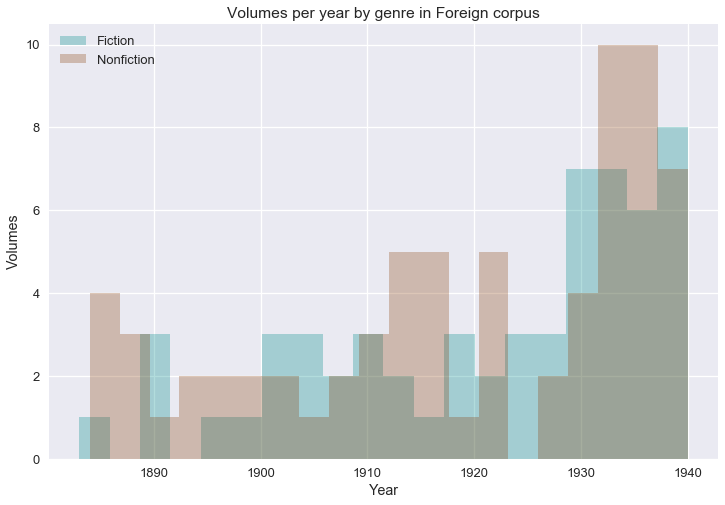

In [38]:
for name, group in dfg.get_group("Foreign").groupby('genre'):
    group.pub_date.plot.hist(bins=20, alpha=0.3, color=colors[name], label=name)
plt.title("Volumes per year by genre in Foreign corpus")
plt.legend()
plt.xlabel("Year")
plt.ylabel("Volumes")
plt.savefig(os.path.join(figDir, 'vols-by-genre-in-foreign.png'), dpi=300)

### Fraction London

Now, the fraction of all UK locations (including 'Britain', etc.) that are in (modern day) London. Note that this includes many instances of 'London' itself. We examine specific locations within London later.

In [39]:
# Fraction of GB locations that are in London
print("\nFraction London/GB by corpus")

# Build weighted dataframe
output = []
for name, group in corpus_gb_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        pub_date = vol.pub_date.values[0]
        ethnicity = vol.white.values[0]
        genre = vol.genre.values[0]
        genre_class = 'Fiction'
        if genre.startswith('Fic') == False:
            genre_class = 'Nonfiction'
        era = 'late'
        if pub_date < splitdate:
            era = 'early'
        london_frac = vol.loc[((vol.admin_2=='Greater London') | (vol.text_string.isin(not_in_london)))].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, pub_date, ethnicity, era, genre_class, london_frac, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'pub_date', 'ethnicity', 'era', 'genre', 'london_frac', 'weight']

# Group and run tests
dfg = df.groupby('corpus')
result = compare_groups(dfg, 'london_frac', 'weight', ci, 'fraction_london_gb_by_corpus', 3)
display(result)

print("\nFraction London/GB by corpus and era")
early = df.loc[(df.era == 'early')].groupby('corpus')
late  = df.loc[(df.era == 'late')].groupby('corpus')

print("\nFraction London/GB, 1880-1913")
result = compare_groups(early, 'london_frac', 'weight', ci, 
                        'fraction_london_gb_1880_1913_by_corpus', 3)
display(result)

print("\nFraction London/GB, 1914-1940")
result = compare_groups(late, 'london_frac', 'weight', ci, 
                        'fraction_london_gb_1914_1940_by_corpus', 3)
display(result)

print("Fraction London/GB by ethnicity in Foreign corpus")
result = compare_groups(dfg.get_group('Foreign').groupby('ethnicity'), 'london_frac',
                        'weight', ci, 'fraction_london_gb_by_ethnicity_in_foreign', 3)
display(result)

print("Fraction London/GB by genre in Foreign corpus")
result = compare_groups(dfg.get_group('Foreign').groupby('genre'), 'london_frac',
                        'weight', ci, 'fraction_london_gb_by_genre_in_foreign', 3)
display(result)

print("Fraction London/GB within corpora by era")
for name, group in dfg:
    result = compare_groups(group.groupby('era'), 'london_frac',
                            'weight', ci, 'fraction_london_gb_by_era_'+name, 3)
    display(name, result)

### USE FOR PUBLICATION ###

Fraction London/GB by corpus


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.381,0.425,0.468,Hathi,0.397,0.402,0.407,2.853e-01,
1,Foreign,0.381,0.425,0.468,London,0.658,0.685,0.713,4.009e-22,###
2,Foreign,0.381,0.425,0.468,Prominent,0.446,0.464,0.482,7.527e-02,
3,Hathi,0.397,0.402,0.407,London,0.658,0.685,0.713,1.523e-55,###
4,Hathi,0.397,0.402,0.407,Prominent,0.446,0.464,0.482,6.336e-10,###
5,London,0.658,0.685,0.713,Prominent,0.446,0.464,0.482,1.240e-30,###



Fraction London/GB by corpus and era

Fraction London/GB, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.408,0.463,0.519,Hathi,0.392,0.397,0.403,1.260e-02,#
1,Foreign,0.408,0.463,0.519,London,0.665,0.700,0.735,3.793e-12,###
2,Foreign,0.408,0.463,0.519,Prominent,0.415,0.441,0.467,4.375e-01,
3,Hathi,0.392,0.397,0.403,London,0.665,0.700,0.735,5.404e-36,###
4,Hathi,0.392,0.397,0.403,Prominent,0.415,0.441,0.467,2.630e-03,##
5,London,0.665,0.700,0.735,Prominent,0.415,0.441,0.467,5.953e-23,###



Fraction London/GB, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.285,0.355,0.425,Hathi,0.403,0.411,0.419,1.024e-01,
1,Foreign,0.285,0.355,0.425,London,0.622,0.666,0.710,1.219e-12,###
2,Foreign,0.285,0.355,0.425,Prominent,0.460,0.485,0.509,2.780e-04,###
3,Hathi,0.403,0.411,0.419,London,0.622,0.666,0.710,3.074e-21,###
4,Hathi,0.403,0.411,0.419,Prominent,0.460,0.485,0.509,9.494e-08,###
5,London,0.622,0.666,0.710,Prominent,0.460,0.485,0.509,1.698e-10,###


Fraction London/GB by ethnicity in Foreign corpus


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.378,0.43,0.482,White,0.322,0.409,0.496,0.675,


Fraction London/GB by genre in Foreign corpus


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Fiction,0.376,0.446,0.516,Nonfiction,0.36,0.415,0.471,0.528,


Fraction London/GB within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.408,0.463,0.519,late,0.285,0.355,0.425,0.018,#


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.392,0.397,0.403,late,0.403,0.411,0.419,0.005,##


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.665,0.7,0.735,late,0.622,0.666,0.71,0.229,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.415,0.441,0.467,late,0.46,0.485,0.509,0.018,#


## Plot London and international fractions over time

### London fractions

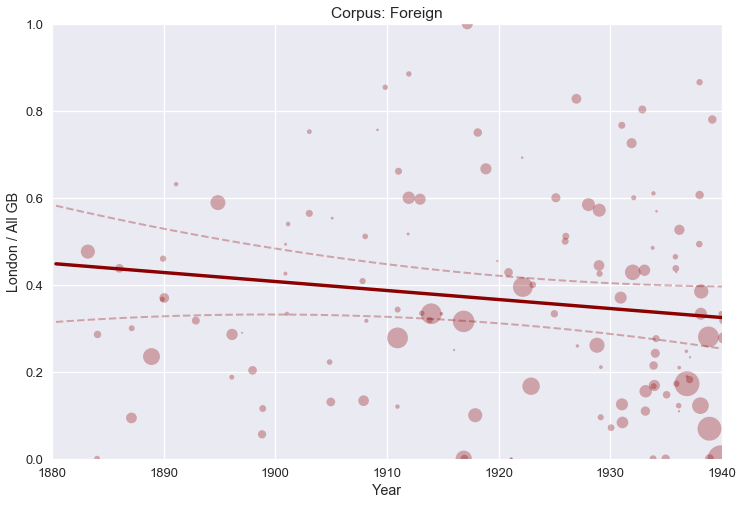

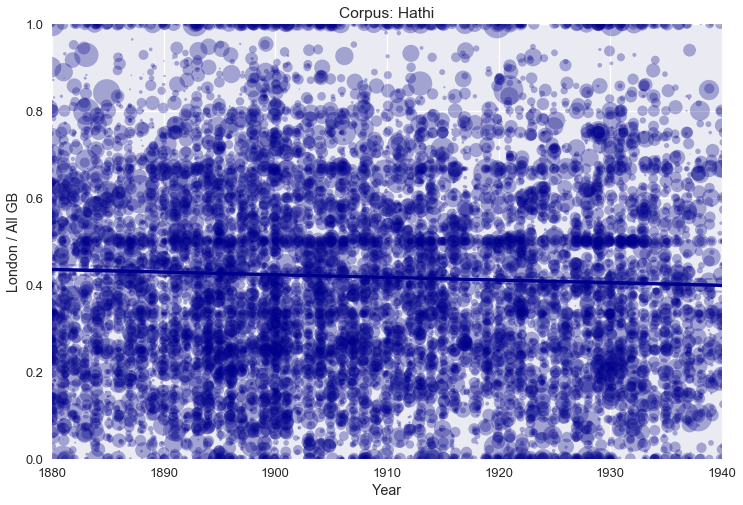

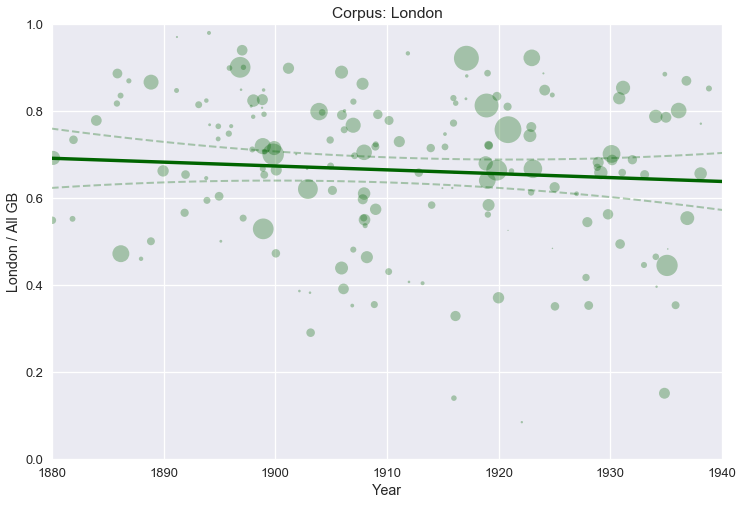

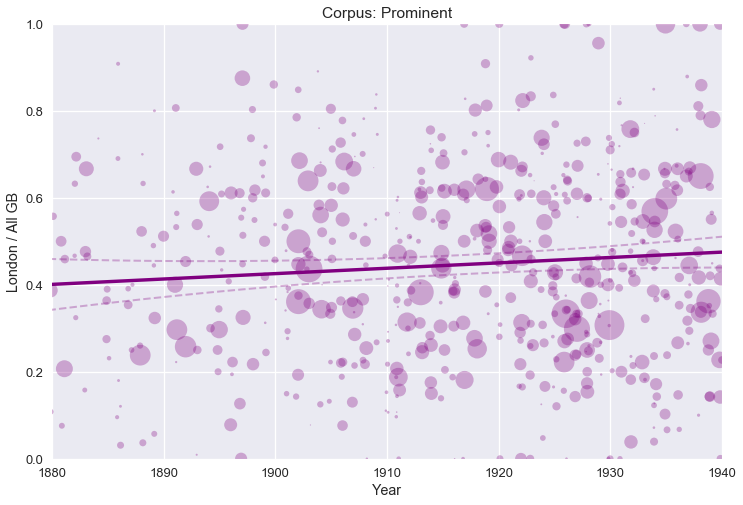

In [40]:
# Fraction London/all by volume and by year and by corpus

# Build weighted dataframe
output = []
for name, group in corpus_gb_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        pub_date = vol.pub_date.values[0]
        ethnicity = vol.white.values[0]
        era = 'late'
        if pub_date < splitdate:
            era = 'early'
        london_frac = vol.loc[((vol.admin_2=='Greater London') | (vol.text_string.isin(not_in_london)))].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, pub_date, ethnicity, era, london_frac, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'pub_date', 'ethnicity', 'era', 'london_frac', 'weight']
dfg = df.groupby('corpus')

for name, group in dfg:
    temp = group.copy().sort_values('pub_date')
    # For weighted model, note inverse weight used. Freaky, differs from descrstatsw.
    wls_fit = sm.wls("london_frac ~ pub_date", data=temp, weights=1/group.weight).fit()
    st, tdata, ss2 = summary_table(wls_fit, alpha=0.05)
    predict_mean_ci_low, predict_mean_ci_upp = tdata[:,4:6].T
    temp['wls'] = wls_fit.predict()
    temp['mci_low'] = predict_mean_ci_low
    temp['mci_high'] = predict_mean_ci_upp
    
    ax = sns.regplot(x='pub_date', y='london_frac', data=temp, x_jitter=0.2, color=colors[name],\
                     scatter_kws={'alpha':0.3, 's':df.weight*100}, fit_reg=False)
    sns.regplot(x='pub_date', y='wls', data=temp, color=colors[name], scatter=False, fit_reg=True, ci=None)
    sns.regplot(x='pub_date', y='mci_low', data=temp, color=colors[name], scatter=False, fit_reg=True, 
                order=2, ci=None, line_kws={'alpha':0.3, 'linestyle':'dashed', 'linewidth':2})
    sns.regplot(x='pub_date', y='mci_high', data=temp, color=colors[name], scatter=False, fit_reg=True, 
                order=2, ci=None, line_kws={'alpha':0.3, 'linestyle':'dashed', 'linewidth':2})
    ax.set(xlim=(1880,1940))
    ax.set(ylim=(0, 1))
    ax.set_title('Corpus: '+name)
    ax.set_xlabel('Year')
    ax.set_ylabel('London / All GB')
    plt.savefig(os.path.join(figDir, 'frac-london-gb-'+name+'.png'), dpi=300)
    plt.show()

### International fractions

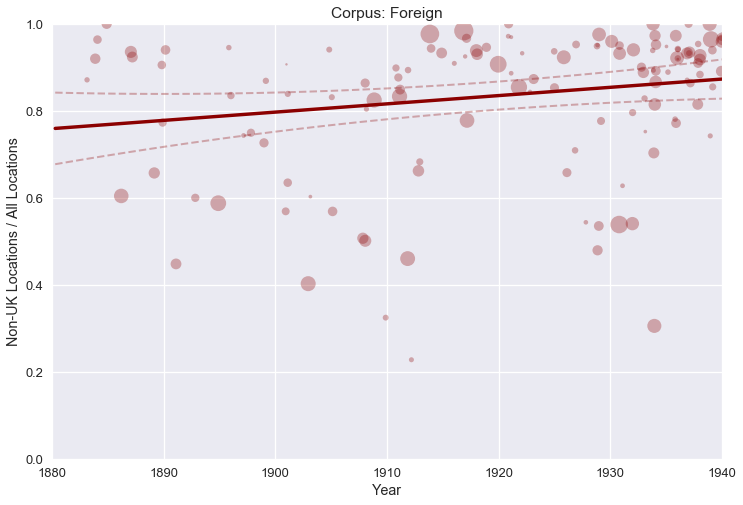

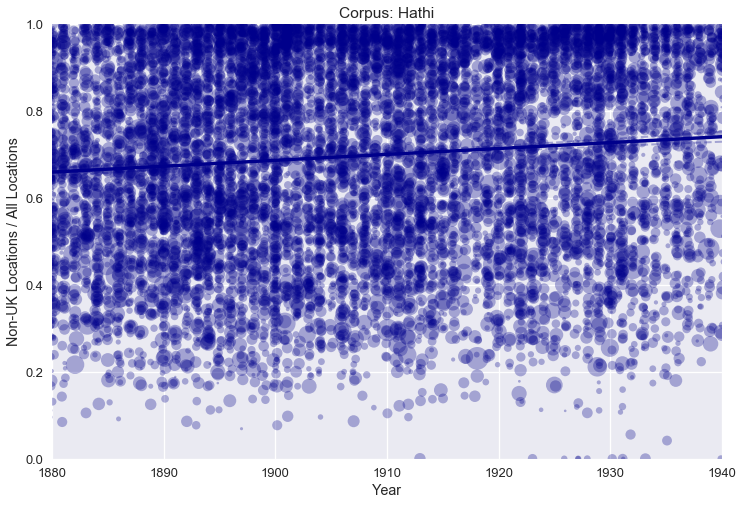

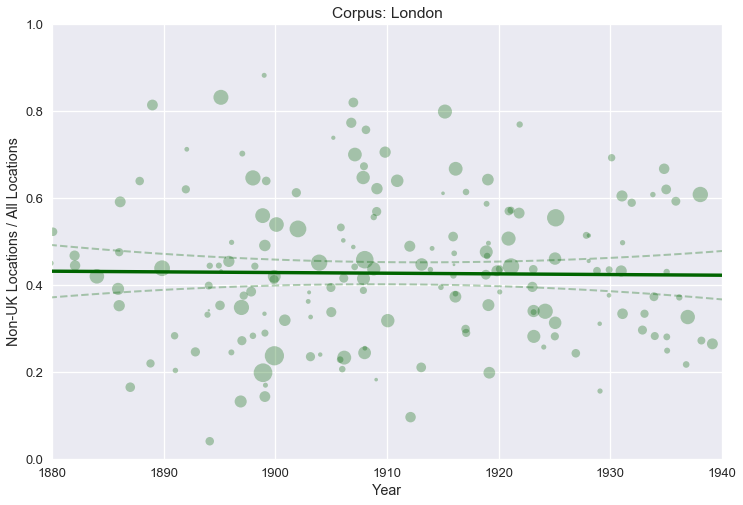

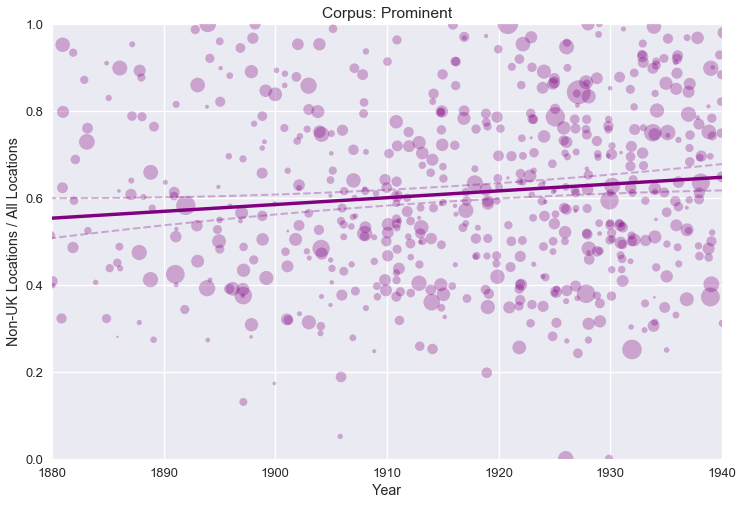

In [41]:
# Fraction non-UK/all by vol/year/corpus

# Build weighted dataframe
output = []
for name, group in corpus_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        pub_date = vol.pub_date.values[0]
        ethnicity = vol.white.values[0]
        genre = vol.genre.values[0]
        genre_class = 'Fiction'
        if genre.startswith('Fic') == False:
            genre_class = 'Nonfiction'
        era = 'late'
        if pub_date < splitdate:
            era = 'early'
        gb_frac = vol.loc[(vol.country_short=='GB')].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, pub_date, ethnicity, era, genre_class, gb_frac, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'pub_date', 'ethnicity', 'genre', 'era', 'gb_frac', 'weight']
df['intl_frac'] = 1 - df.gb_frac
dfg = df.groupby('corpus')

for name, group in dfg:
    temp = group.copy().sort_values('pub_date')
    # For weighted model, note inverse weight used. Freaky, differs from descrstatsw.
    wls_fit = sm.wls("intl_frac ~ pub_date", data=temp, weights=1/group.weight).fit()
    st, tdata, ss2 = summary_table(wls_fit, alpha=0.05)
    predict_mean_ci_low, predict_mean_ci_upp = tdata[:,4:6].T
    temp['wls'] = wls_fit.predict()
    temp['mci_low'] = predict_mean_ci_low
    temp['mci_high'] = predict_mean_ci_upp
    
    ax = sns.regplot(x='pub_date', y='intl_frac', data=temp, x_jitter=0.2, color=colors[name],\
                     scatter_kws={'alpha':0.3, 's':df.weight*100}, fit_reg=False)
    sns.regplot(x='pub_date', y='wls', data=temp, color=colors[name], scatter=False, fit_reg=True, ci=None)
    sns.regplot(x='pub_date', y='mci_low', data=temp, color=colors[name], scatter=False, fit_reg=True, 
                order=2, ci=None, line_kws={'alpha':0.3, 'linestyle':'dashed', 'linewidth':2})
    sns.regplot(x='pub_date', y='mci_high', data=temp, color=colors[name], scatter=False, fit_reg=True, 
                order=2, ci=None, line_kws={'alpha':0.3, 'linestyle':'dashed', 'linewidth':2})
    ax.set(xlim=(1880,1940))
    ax.set(ylim=(0, 1))
    ax.set_title('Corpus: '+name)
    ax.set_xlabel('Year')
    ax.set_ylabel('Non-UK Locations / All Locations')
    plt.savefig(os.path.join(figDir, 'frac-nongb-world-'+name+'.png'), dpi=300)
    plt.show()

### Ireland fraction

Check fraction Ireland over time, to make sure our international shift isn't just an Irish shift

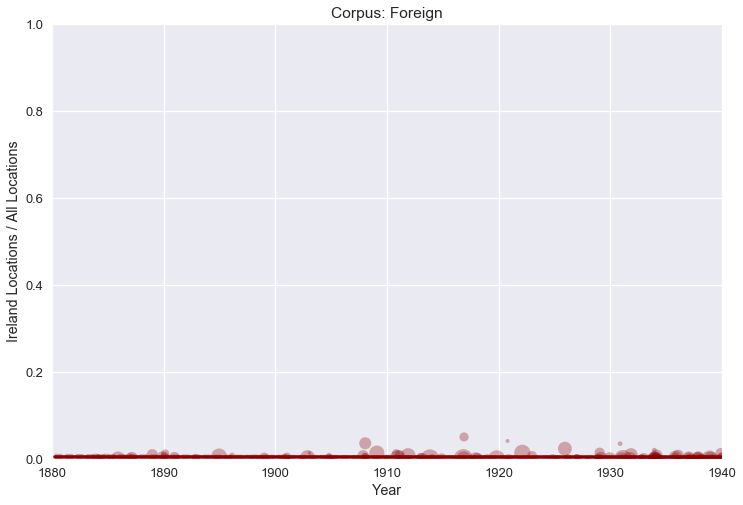

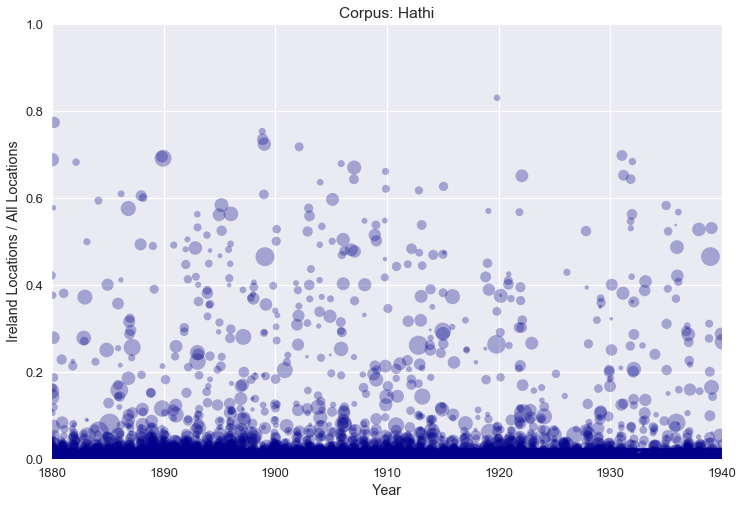

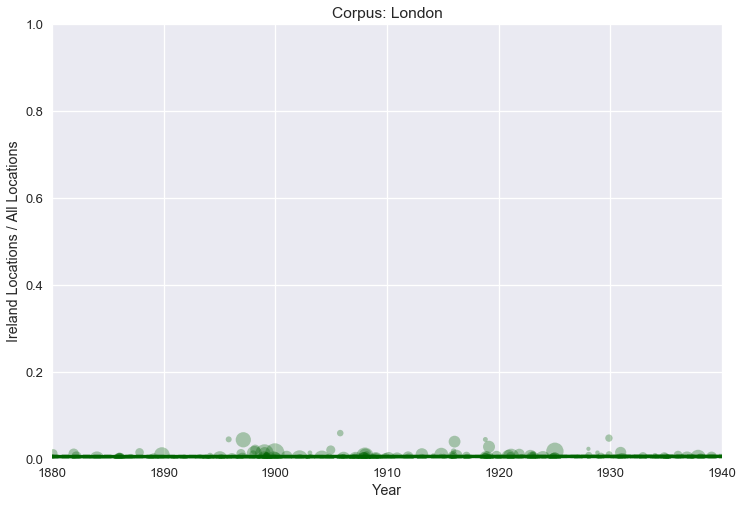

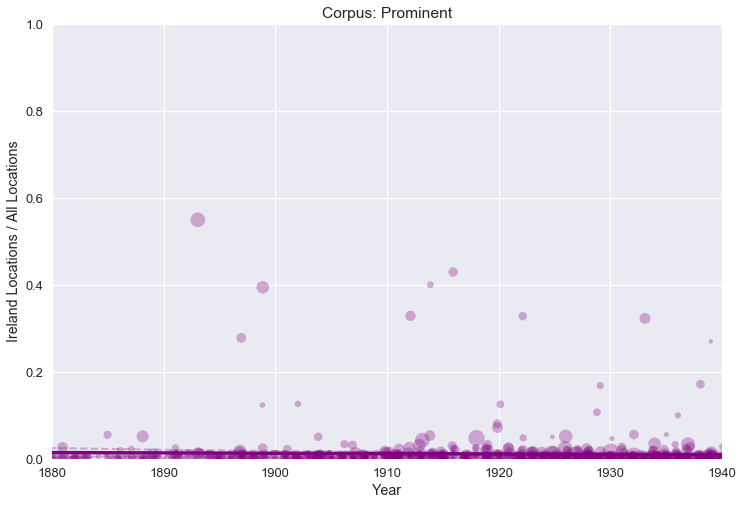

In [42]:
# Fraction Ireland/all by vol/year/corpus

# Build weighted dataframe
output = []
for name, group in corpus_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        pub_date = vol.pub_date.values[0]
        ethnicity = vol.white.values[0]
        genre = vol.genre.values[0]
        genre_class = 'Fiction'
        if genre.startswith('Fic') == False:
            genre_class = 'Nonfiction'
        era = 'late'
        if pub_date < splitdate:
            era = 'early'
        ie_frac = vol.loc[(vol.country_short=='IE')].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, pub_date, ethnicity, era, genre_class, ie_frac, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'pub_date', 'ethnicity', 'genre', 'era', 'ie_frac', 'weight']
dfg = df.groupby('corpus')

for name, group in dfg:
    temp = group.copy().sort_values('pub_date')
    # For weighted model, note inverse weight used. Freaky, differs from descrstatsw.
    wls_fit = sm.wls("ie_frac ~ pub_date", data=temp, weights=1/group.weight).fit()
    st, tdata, ss2 = summary_table(wls_fit, alpha=0.05)
    predict_mean_ci_low, predict_mean_ci_upp = tdata[:,4:6].T
    temp['wls'] = wls_fit.predict()
    temp['mci_low'] = predict_mean_ci_low
    temp['mci_high'] = predict_mean_ci_upp
    
    ax = sns.regplot(x='pub_date', y='ie_frac', data=temp, x_jitter=0.2, color=colors[name],\
                     scatter_kws={'alpha':0.3, 's':df.weight*100}, fit_reg=False)
    sns.regplot(x='pub_date', y='wls', data=temp, color=colors[name], scatter=False, fit_reg=True, ci=None)
    sns.regplot(x='pub_date', y='mci_low', data=temp, color=colors[name], scatter=False, fit_reg=True, 
                order=2, ci=None, line_kws={'alpha':0.3, 'linestyle':'dashed', 'linewidth':2})
    sns.regplot(x='pub_date', y='mci_high', data=temp, color=colors[name], scatter=False, fit_reg=True, 
                order=2, ci=None, line_kws={'alpha':0.3, 'linestyle':'dashed', 'linewidth':2})
    ax.set(xlim=(1880,1940))
    ax.set(ylim=(0, 1))
    ax.set_title('Corpus: '+name)
    ax.set_xlabel('Year')
    ax.set_ylabel('Ireland Locations / All Locations')
    plt.savefig(os.path.join(figDir, 'frac-ie-world-'+name+'.png'), dpi=300)
    plt.show()

## Geo intensivity and specificity in the corpora over time

### Basic intensivity

First, the stats. Then, visualizations.

In [43]:
# Simple geo intensivity per volume
print("Occurrences per 100k words before and after 1914 by corpus")

# Build unweighted dataframe
output = []
for name, group in corpus_grouped:
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        occurs_100k = vol.occurs_100k.sum()
        pub_date = vol.pub_date.values[0]
        ethnicity = vol.white.values[0]
        genre = vol.genre.values[0]
        genre_class = 'Fiction'
        if genre.startswith('Fic') == False:
            genre_class = 'Nonfiction'
        era = 'late'
        if pub_date < splitdate:
            era = 'early'
        output.append((name, ethnicity, pub_date, era, genre_class, occurs_100k))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'ethnicity', 'pub_date', 'era', 'genre', 'occurs_100k']

# Group and run tests
dfg = df.groupby('corpus')
early = df.loc[(df.era=='early')].groupby('corpus')
late = df.loc[(df.era=='late')].groupby('corpus')

print("\nBefore 1914 (1880-1913)")
result = compare_groups(early, 'occurs_100k', None, ci, 
                        'occurs_100k_1880_1913_by_corpus', 1)
display(result)

print("\n1914-1940")
result = compare_groups(late, 'occurs_100k', None, ci, 
                        'occurs_100k_1914_1940_by_corpus', 1)
display(result)

print("\nBy ethnicity in Foreign")
result = compare_groups(dfg.get_group('Foreign').groupby('ethnicity'), 'occurs_100k',
                        None, ci, 'occurs_100k_by_ethnicity_in_foreign', 3)
display(result)

print("\nBy genre in Foreign")
result = compare_groups(dfg.get_group('Foreign').groupby('genre'), 'occurs_100k',
                        None, ci, 'occurs_100k_by_genre_in_foreign', 3)
display(result)

print("\nForeign fiction vs. other corpora")
dffiction = df[df.genre == 'Fiction']
result = compare_groups(dffiction.groupby('corpus'), 'occurs_100k',
                        None, ci, 'occurs_100k_by_genre_in_foreign', 3)
display(result)


print("Within corpora by era")
for name, group in dfg:
    result = compare_groups(group.groupby('era'), 'occurs_100k',
                            None, ci, 'occurs_100k_by_era_'+name, 3)
    display(name, result)
    
print("For reference: Foreign corpus composition by ethnicity, era, and fiction/nonfiction")
dfg.get_group('Foreign').groupby(['ethnicity', 'era', 'genre']).pub_date.count()

### USE  FOR PUBLICATION ###
Occurrences per 100k words before and after 1914 by corpus

Before 1914 (1880-1913)


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,623.8,781.0,938.3,Hathi,274.7,279.4,284.1,1.5e-63,###
1,Foreign,623.8,781.0,938.3,London,238.1,272.1,306.1,8.0e-15,###
2,Foreign,623.8,781.0,938.3,Prominent,268.9,288.3,307.8,1.7e-27,###
3,Hathi,274.7,279.4,284.1,London,238.1,272.1,306.1,7.1e-01,
4,Hathi,274.7,279.4,284.1,Prominent,268.9,288.3,307.8,4.8e-01,
5,London,238.1,272.1,306.1,Prominent,268.9,288.3,307.8,3.9e-01,



1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,443.3,533.3,623.2,Hathi,275.7,282.5,289.4,1.1e-25,###
1,Foreign,443.3,533.3,623.2,London,241.9,274.3,306.7,9.5e-07,###
2,Foreign,443.3,533.3,623.2,Prominent,236.4,252.7,269.0,2.5e-21,###
3,Hathi,275.7,282.5,289.4,London,241.9,274.3,306.7,7.4e-01,
4,Hathi,275.7,282.5,289.4,Prominent,236.4,252.7,269.0,1.1e-02,#
5,London,241.9,274.3,306.7,Prominent,236.4,252.7,269.0,2.6e-01,



By ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,539.436,646.053,752.671,White,437.404,556.551,675.698,0.31,



By genre in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Fiction,279.35,345.087,410.825,Nonfiction,728.065,843.207,958.349,7.349e-11,###



Foreign fiction vs. other corpora


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,279.350,345.087,410.825,Hathi,276.665,280.551,284.437,1.288e-02,#
1,Foreign,279.350,345.087,410.825,London,249.509,273.076,296.643,1.072e-02,#
2,Foreign,279.350,345.087,410.825,Prominent,254.632,267.183,279.734,5.853e-04,###
3,Hathi,276.665,280.551,284.437,London,249.509,273.076,296.643,6.240e-01,
4,Hathi,276.665,280.551,284.437,Prominent,254.632,267.183,279.734,1.118e-01,
5,London,249.509,273.076,296.643,Prominent,254.632,267.183,279.734,6.605e-01,


Within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,623.755,781.021,938.288,late,443.348,533.29,623.231,0.004,##


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,274.729,279.421,284.113,late,275.679,282.516,289.353,0.452,


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,238.092,272.115,306.138,late,241.936,274.305,306.674,0.928,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,268.89,288.334,307.777,late,236.382,252.712,269.042,0.006,##


For reference: Foreign corpus composition by ethnicity, era, and fiction/nonfiction


ethnicity  era    genre     
Nonwhite   early  Fiction       12
                  Nonfiction    22
           late   Fiction       24
                  Nonfiction    30
White      early  Fiction        6
                  Nonfiction     4
           late   Fiction       17
                  Nonfiction    15
Name: pub_date, dtype: int64

### Prominent volumes by intensity

In [44]:
# Build unweighted dataframe
output = []
for name, group in corpus_grouped:
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        occurs_100k = vol.occurs_100k.sum()
        pub_date = vol.pub_date.values[0]
        weight = 1
        genre = vol.genre.values[0]
        output.append((name, htid, pub_date, occurs_100k, weight, genre))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'htid', 'pub_date', 'occurs_100k', 'weight', 'genre']

# Group and run tests
intensg = df.groupby('corpus')
result = vol_means(intensg, 'occurs_100k', 10, 'Prominent')

Weighted mean of occurs_100k in Prominent: 267.1833


,htid,occurs_100k,weight,author,title,pub_date_y,genre_y,gender,white,origin_area,wordcount
154,mdp.39015005775112,279.182,1,"Waugh, Evelyn",Decline and Fall,1928,Fiction-Novel,Male,White,Britain,77369
313,mdp.49015001000182,278.222,1,"Rhys, Jean",Voyage in the Dark,1934,Fiction-Novel,Female,White,Caribbean,60024
68,inu.32000000357600,276.038,1,"Greene, Graham",It's a Battlefield,1934,Fiction-Novel,Male,White,Britain,80786
527,uc1.b4938307,274.931,1,"Hardy, Thomas",Two on a Tower,1882,Fiction-Novel,Male,White,Britain,132397
530,uc1.c003356752,272.159,1,"Ford, Ford Madox",The Simple Life Limited,1911,Fiction-Novel,Male,White,Britain,140359
126,mdp.39015002715129,271.962,1,"Richardson, Dorothy",Revolving Lights,1923,Fiction-Novel,Female,White,Britain,75746
400,uc1.$b244479,271.476,1,"Richardson, Dorothy",Oberland,1927,Fiction-Novel,Female,White,Britain,46413
500,uc1.b3865720,270.629,1,"Waugh, Evelyn",Vile Bodies,1930,Fiction-Novel,Male,White,Britain,79075
59,inu.30000048891463,269.743,1,"Rolfe, Frederick",In His Own Image,1901,Fiction-Stories,Male,White,Britain,123080
160,mdp.39015008044854,268.122,1,"Compton-Burnett, Ivy",Daughters and Sons,1937,Fiction-Novel,Female,White,Britain,117111


### Prominent authors by intensity

In [46]:
# Build weighted dataframe
output = []
for name, group in corpus_grouped:
    byvol = group.groupby('author')
    for htid, vol in byvol:
        weight = vol.htid.nunique()
        ethnicity = vol.white.values[0]
        intensity = vol.occurs_100k.sum()/vol.htid.nunique()
        output.append((name, htid, ethnicity, intensity, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'author', 'ethnicity', 'occurs_100k', 'weight']

# Group and run tests
intensity_authg = df.groupby('corpus')
result = auth_means(intensity_authg, 'occurs_100k', 10, 'Prominent')
# Examine Woolf and Joyce
display(result[result.author.isin(['Woolf, Virginia', 'Joyce, James'])])
# Add intensity to geotyp frame
geotyp = geotyp.merge(result[['author', 'occurs_100k']], how='left', on='author')

Weighted mean of occurs_100k in Prominent: 267.1833


,author,occurs_100k,weight,pub_date_avg,books,wordcount,ethnicity
8,"Bennett, Arnold",300.943,40.0,1912.825,40,4292264,White
21,"Delafield, E. M.",300.911,1.0,1930.000,1,57492,White
35,"Hall, Radclyffe",292.856,1.0,1928.000,1,195659,White
46,"Jerome, Jerome K.",291.967,1.0,1889.000,1,80146,White
26,"Forster, E. M.",291.205,8.0,1913.375,8,754279,White
40,"Household, Geoffrey",287.556,1.0,1939.000,1,69204,White
10,"Bentley, E. C.",287.396,1.0,1913.000,1,86640,White
72,"Rhys, Jean",281.519,3.0,1934.667,3,173364,White
58,"Maugham, William Somerset",279.062,22.0,1919.455,22,2277960,White
15,"Chesterton, G. K.",274.637,17.0,1919.529,17,1348440,White


,author,occurs_100k,weight,pub_date_avg,books,wordcount,ethnicity
47,"Joyce, James",253.422,4.0,1922.75,4,765878,White
97,"Woolf, Virginia",212.066,10.0,1924.40,10,1205859,White


### Intensivity visuals

#### Intensivity as basic line chart

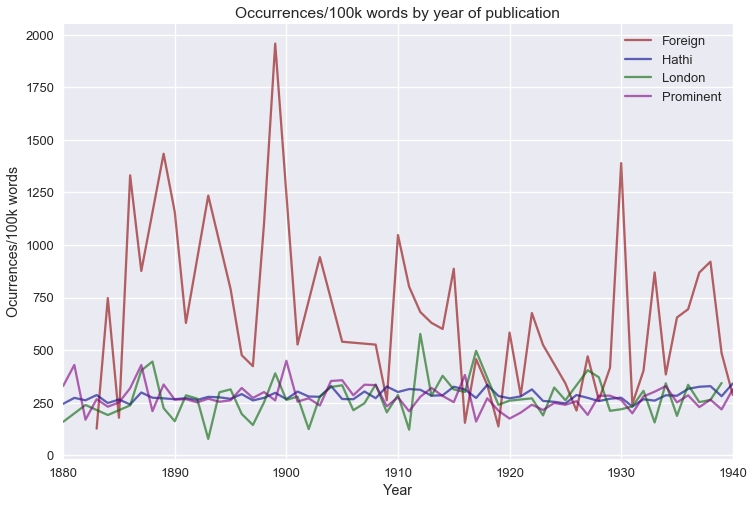

In [47]:
# Intensivity lines
plt.figure()
ax = plt.axes()
for name, group in corpus_grouped:
    gbp = group.groupby('pub_date')
    gbp.occurs_100k.sum().divide(gbp.htid.nunique()).plot(color=colors[name], alpha=0.6, label=name)
plt.title("Occurrences/100k words by year of publication")
plt.legend()
plt.ylabel('Ocurrences/100k words')
plt.xlabel('Year')
plt.savefig(os.path.join(figDir, 'intens-by-corpus-line.png'), dpi=300)

#### As scatter plots by volume with fits

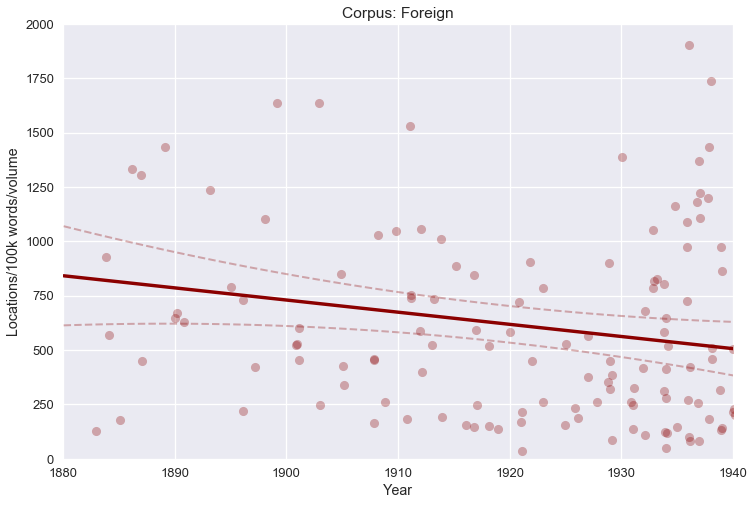

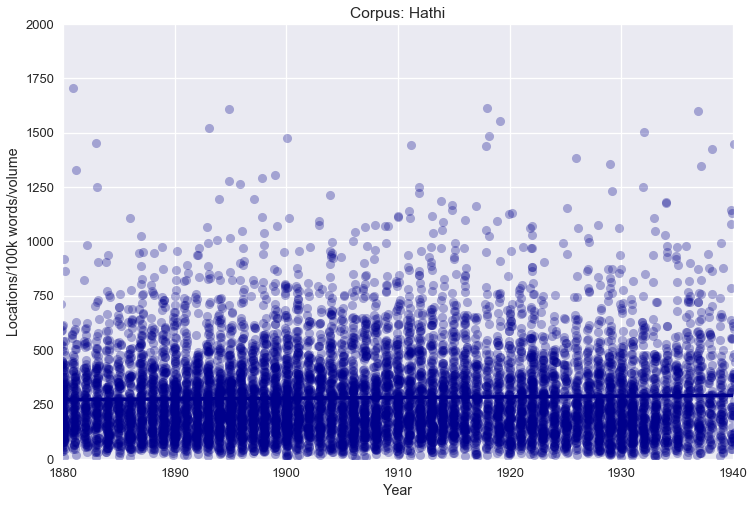

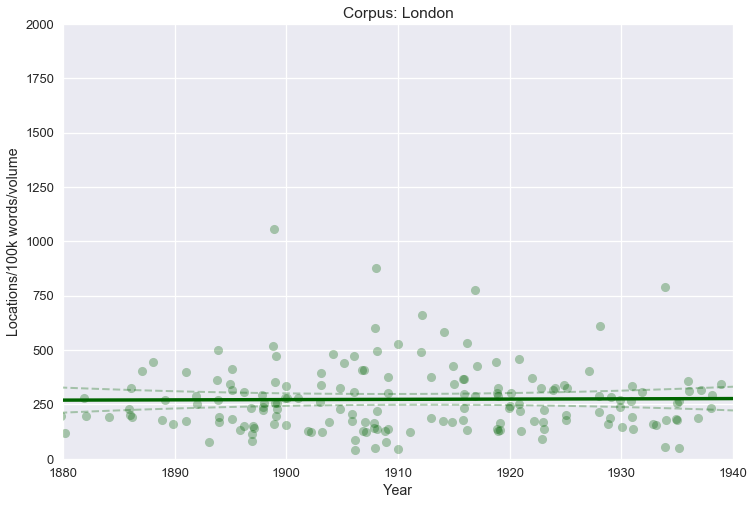

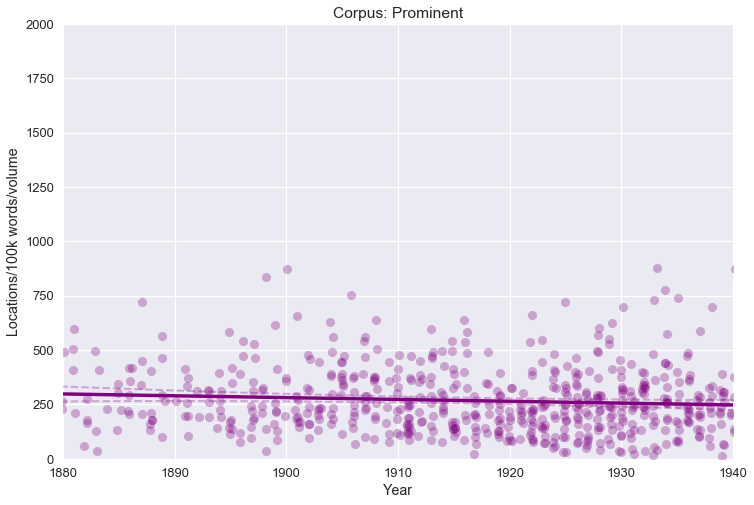

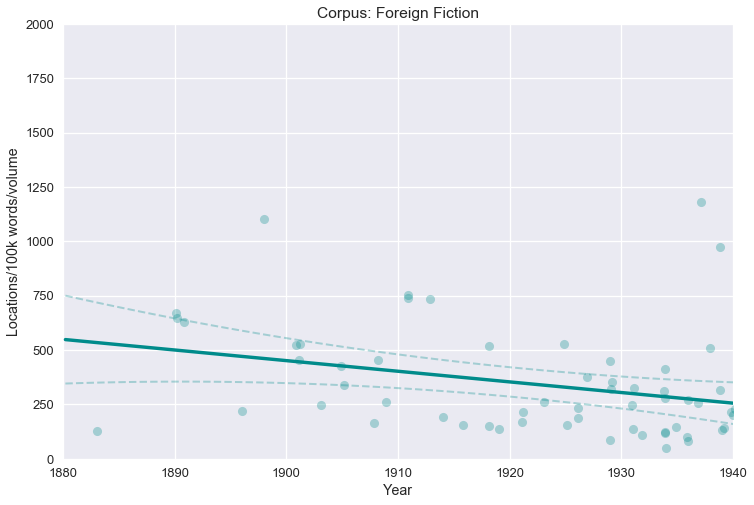

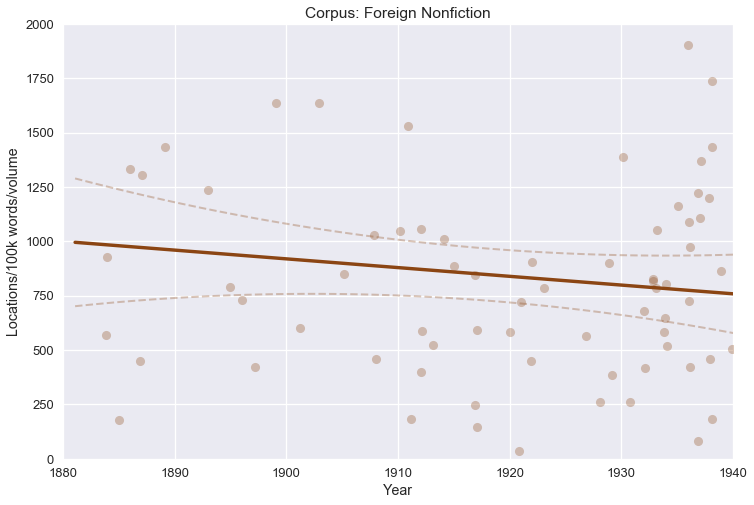

In [48]:
# Reuse the dataframe from stats above. Be careful if moving these things around.
for name, group in dfg:
    temp = group.copy()
    # For weighted model, note inverse weight used. Freaky, differs from descrstatsw.
    wls_fit = sm.wls("occurs_100k ~ pub_date", data=temp).fit()
    st, tdata, ss2 = summary_table(wls_fit, alpha=0.05)
    predict_mean_ci_low, predict_mean_ci_upp = tdata[:,4:6].T
    temp['wls'] = wls_fit.predict()
    temp['mci_low'] = predict_mean_ci_low
    temp['mci_high'] = predict_mean_ci_upp
    
    ax = sns.regplot(x='pub_date', y='occurs_100k', data=temp, x_jitter=0.2, color=colors[name],\
                     scatter_kws={'alpha':0.3}, fit_reg=False)
    sns.regplot(x='pub_date', y='wls', data=temp, color=colors[name], scatter=False, fit_reg=True, ci=None)
    sns.regplot(x='pub_date', y='mci_low', data=temp, color=colors[name], scatter=False, fit_reg=True, 
                order=2, ci=None, line_kws={'alpha':0.3, 'linestyle':'dashed', 'linewidth':2})
    sns.regplot(x='pub_date', y='mci_high', data=temp, color=colors[name], scatter=False, fit_reg=True, 
                order=2, ci=None, line_kws={'alpha':0.3, 'linestyle':'dashed', 'linewidth':2})
    ax.set(xlim=(1880,1940))
    ax.set(ylim=(0, 2000))
    ax.set_title('Corpus: '+name)
    ax.set_xlabel('Year')
    ax.set_ylabel('Locations/100k words/volume')
    plt.savefig(os.path.join(figDir, 'locs-per-vol-indiv-'+name+'.png'), dpi=300)
    plt.show()

# Plot trends by genre in Foreign
for name, group in dfg.get_group('Foreign').groupby('genre'):
    temp = group.copy()
    # For weighted model, note inverse weight used. Freaky, differs from descrstatsw.
    wls_fit = sm.wls("occurs_100k ~ pub_date", data=temp).fit()
    st, tdata, ss2 = summary_table(wls_fit, alpha=0.05)
    predict_mean_ci_low, predict_mean_ci_upp = tdata[:,4:6].T
    temp['wls'] = wls_fit.predict()
    temp['mci_low'] = predict_mean_ci_low
    temp['mci_high'] = predict_mean_ci_upp
    
    ax = sns.regplot(x='pub_date', y='occurs_100k', data=temp, x_jitter=0.2, color=colors[name],\
                     scatter_kws={'alpha':0.3}, fit_reg=False)
    sns.regplot(x='pub_date', y='wls', data=temp, color=colors[name], scatter=False, fit_reg=True, ci=None)
    sns.regplot(x='pub_date', y='mci_low', data=temp, color=colors[name], scatter=False, fit_reg=True, 
                order=2, ci=None, line_kws={'alpha':0.3, 'linestyle':'dashed', 'linewidth':2})
    sns.regplot(x='pub_date', y='mci_high', data=temp, color=colors[name], scatter=False, fit_reg=True, 
                order=2, ci=None, line_kws={'alpha':0.3, 'linestyle':'dashed', 'linewidth':2})
    ax.set(xlim=(1880,1940))
    ax.set(ylim=(0, 2000))
    ax.set_title('Corpus: Foreign '+name)
    ax.set_xlabel('Year')
    ax.set_ylabel('Locations/100k words/volume')
    plt.savefig(os.path.join(figDir, 'locs-per-vol-indiv-'+name+'_in foreign.png'), dpi=300)
    plt.show()

### Specificity

Fraction of location occurrences below different levels of geographic specificity.

In [50]:
# Fraction by location type, GB only
print("Fraction of GB locations that are specific BELOW the CITY level")

# Build weighted dataframe
# Calculate fraction specific below locality level
# Weight by volume's geo intensivity (as usual)

# What counts as non-specific
nonspec = ('administrative_area_level_1',
           'administrative_area_level_2',
           'administrative_area_level_3',
           'administrative_area_level_4',
           'administrative_area_level_5',
           'country',
           'continent',
           'locality',
           'natural_feature'
          )

output = []
for name, group in corpus_gb_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        pub_date = vol.pub_date.values[0]
        ethnicity = vol.white.values[0]
        genre = vol.genre.values[0]
        genre_class = 'Fiction'
        if genre.startswith('Fic') == False:
            genre_class = 'Nonfiction'
        era = 'late'
        if pub_date < splitdate:
            era = 'early'
        spec_frac = vol.loc[(~vol.location_type.isin(nonspec))].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, pub_date, ethnicity, era, genre_class, spec_frac, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'pub_date', 'ethnicity', 'era', 'genre', 'spec_frac', 'weight']

# Group and run tests
dfg = df.groupby('corpus')
early = df.loc[(df.era=='early')].groupby('corpus')
late = df.loc[(df.era=='late')].groupby('corpus')

result = compare_groups(dfg, 'spec_frac', 'weight', ci, 
                        'fraction_below_city_level_gb_by_corpus', 3)
display(result)

print("\nFraction of GB locations that are specific BELOW the CITY level, 1880-1913")
result = compare_groups(early, 'spec_frac', 'weight', ci, 
                        'fraction_below_city_level_gb_1880_1913_by_corpus', 3)
display(result)

print("\nFraction of GB locations that are specific BELOW the CITY level, 1914-1940")
result = compare_groups(late, 'spec_frac', 'weight', ci, 
                        'fraction_below_city_level_gb_1914_1940_by_corpus', 3)
display(result)

print("\nFraction of GB locations that are specific BELOW the CITY level, by ETHNICITY in Foreign")
result = compare_groups(dfg.get_group('Foreign').groupby('ethnicity'), 'spec_frac',
                        'weight', ci, 'fraction_below_city_level_gb_by_ethnicity_in_foreign', 3)
display(result)

print("\nFraction of GB locations that are specific BELOW the CITY level, by GENRE in Foreign")
result = compare_groups(dfg.get_group('Foreign').groupby('genre'), 'spec_frac',
                        'weight', ci, 'fraction_below_city_level_gb_by_genre_in_foreign', 3)
display(result)

print("\nFraction of GB locations that are specific BELOW the CITY level, within corpora by ERA")
for name, group in dfg:
    result = compare_groups(group.groupby('era'), 'spec_frac',
                            'weight', ci, 'fraction_below_city_level_gb_by_era_'+name, 3)
    display(name, result)

### USE  FOR PUBLICATION ###
Fraction of GB locations that are specific BELOW the city level


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.155,0.174,0.193,Hathi,0.216,0.219,0.222,1.627e-03,##
1,Foreign,0.155,0.174,0.193,London,0.372,0.402,0.433,6.642e-26,###
2,Foreign,0.155,0.174,0.193,Prominent,0.257,0.271,0.284,4.558e-10,###
3,Hathi,0.216,0.219,0.222,London,0.372,0.402,0.433,2.833e-50,###
4,Hathi,0.216,0.219,0.222,Prominent,0.257,0.271,0.284,2.766e-14,###
5,London,0.372,0.402,0.433,Prominent,0.257,0.271,0.284,1.362e-17,###



Fraction of GB locations that are specific BELOW the city level, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.161,0.182,0.202,Hathi,0.212,0.216,0.220,4.807e-02,#
1,Foreign,0.161,0.182,0.202,London,0.354,0.398,0.443,4.417e-14,###
2,Foreign,0.161,0.182,0.202,Prominent,0.249,0.269,0.288,8.614e-06,###
3,Hathi,0.212,0.216,0.220,London,0.354,0.398,0.443,7.379e-30,###
4,Hathi,0.212,0.216,0.220,Prominent,0.249,0.269,0.288,5.099e-08,###
5,London,0.354,0.398,0.443,Prominent,0.249,0.269,0.288,3.719e-09,###



Fraction of GB locations that are specific BELOW the city level, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.122,0.161,0.199,Hathi,0.219,0.224,0.230,9.528e-03,##
1,Foreign,0.122,0.161,0.199,London,0.368,0.408,0.448,1.547e-13,###
2,Foreign,0.122,0.161,0.199,Prominent,0.254,0.273,0.291,1.333e-05,###
3,Hathi,0.219,0.224,0.230,London,0.368,0.408,0.448,2.287e-21,###
4,Hathi,0.219,0.224,0.230,Prominent,0.254,0.273,0.291,9.212e-07,###
5,London,0.368,0.408,0.448,Prominent,0.254,0.273,0.291,5.971e-10,###



Fraction of GB locations that are specific BELOW the city level, by ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.161,0.183,0.205,White,0.114,0.148,0.183,0.106,



Fraction of GB locations that are specific BELOW the city level, by genre in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Fiction,0.163,0.201,0.239,Nonfiction,0.141,0.163,0.184,0.061,



Fraction of GB locations that are specific BELOW the city level, within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.161,0.182,0.202,late,0.122,0.161,0.199,0.287,


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.212,0.216,0.22,late,0.219,0.224,0.23,0.013,#


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.354,0.398,0.443,late,0.368,0.408,0.448,0.749,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.249,0.269,0.288,late,0.254,0.273,0.291,0.762,


### Prominent volumes by specificity (GB locations below city level)

In [51]:
print("Specificity within GB, below CITY level ...")
output = []
for name, group in corpus_gb_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    for volid, vol in group.groupby('htid'):
        weight = vol.occurs_100k.sum()/avg_occurs
        pub_date = vol.pub_date.values[0]
        ethnicity = vol.white.values[0]
        genre = vol.genre.values[0]
        spec_frac = vol.loc[(~vol.location_type.isin(nonspec))].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, volid, pub_date, ethnicity, genre, spec_frac, weight))
n = pd.DataFrame.from_records(output)
n.columns = ['corpus', 'htid', 'pub_date', 'ethnicity', 'genre', 'spec_gb_subcity', 'weight']

# Group and run tests
ng = n.groupby('corpus')
result = vol_means(ng, 'spec_gb_subcity', 10, 'Prominent')

Specificity within GB, below city level ...
Weighted mean of spec_gb_subcity in Prominent: 0.2707


,htid,spec_gb_subcity,weight,author,title,pub_date_y,genre_y,gender,white,origin_area,wordcount
202,mdp.39015018991433,0.277,0.878,"Powys, John Cowper",Maiden Castle,1936,Fiction-Novel,Male,White,Britain,302110
218,mdp.39015030719705,0.276,1.190,"Wells, H. G.",Twelve Stories and a Dream,1903,Fiction-Stories,Male,White,Britain,87655
407,uc1.$b386778,0.276,1.275,"Wells, H. G.","The Food of the Gods, and how it Came to Earth",1904,Fiction-Novel,Male,White,Britain,90359
308,mdp.49015000993858,0.275,0.659,"Maugham, William Somerset",Christmas Holiday,1939,Fiction-Novel,Male,White,Britain,103999
346,pst.000005348527,0.275,0.626,"Conrad, Joseph",The Inheritors: An Extravagant Story,1901,Fiction-Novel,Male,White,Europe,80949
376,pst.000045968389,0.274,2.995,"Stevenson, Robert Louis",The Strange Case of Dr. Jekyll and Mr. Hyde,1886,Fiction-Novel,Male,White,Britain,37468
382,uc1.$b104376,0.273,0.102,"Powys, Theodore Francis",Unclay,1932,Fiction-Novel,Male,White,Britain,107352
192,mdp.39015014510633,0.273,0.311,"Mansfield, Katherine","Something Childish, and Other Stories",1924,Fiction-Stories,Female,White,Australasia,70261
431,uc1.32106001997508,0.273,0.336,"Lewis, Wyndham",The Revenge for Love,1937,Fiction-Novel,Male,White,Other,162718
513,uc1.b4095606,0.271,0.810,"Ford, Ford Madox",A Man Could Stand Up--A Novel,1926,Fiction-Novel,Male,White,Britain,85853


### Prominent authors by specificity (GB locations below city level)

In [52]:
print("Specificity within GB, below CITY level ...")
output = []
for name, group in corpus_gb_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    for volid, vol in group.groupby('author'):
        weight = vol.occurs_100k.sum()/avg_occurs
        ethnicity = vol.white.values[0]
        spec_frac = vol.loc[(~vol.location_type.isin(nonspec))].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, volid, ethnicity, spec_frac, weight))
n = pd.DataFrame.from_records(output)
n.columns = ['corpus', 'author', 'ethnicity', 'spec_gb_subcity', 'weight']

# Group and run tests
ng = n.groupby('corpus')
result = auth_means(ng, 'spec_gb_subcity', 10, 'Prominent')
# Examine Woolf and Joyce
result[result.author.isin(['Woolf, Virginia', 'Joyce, James'])]

Specificity within GB, below city level ...
Weighted mean of spec_gb_subcity in Prominent: 0.2707


,author,spec_gb_subcity,weight,pub_date_avg,books,wordcount,ethnicity
61,"Munro, Hector Hugh",0.299,5.553,1910.667,6,321293,White
70,"Priestley, J. B.",0.297,2.649,1929.500,2,542737,White
95,"Williams, Charles",0.293,2.938,1931.333,3,269757,White
72,"Richardson, Dorothy",0.291,12.506,1921.300,10,702486,White
91,"West, Rebecca",0.286,2.919,1928.000,5,609336,White
58,"Maugham, William Somerset",0.284,18.153,1919.455,22,2277960,White
23,"Douglas, Norman [George]",0.279,1.184,1916.250,4,349347,White
64,"Orwell, George",0.278,3.802,1936.000,4,437617,White
44,"James, Henry",0.276,9.445,1897.800,15,2284521,White
13,"Burnett, Frances Hodgston",0.274,1.652,1898.500,2,171937,White


,author,spec_gb_subcity,weight,pub_date_avg,books,wordcount,ethnicity
96,"Woolf, Virginia",0.431,13.292,1924.40,10,1205859,White
47,"Joyce, James",0.249,1.369,1922.75,4,765878,White


#### Note about Joyce specifcity

Recall that this is sub-city-level detail WITHIN MODERN BRITAIN (NOT IRELAND). All Joyce's detail about Dublin isn't part of this measure. We capture it elsewhere, but it's not rolled in here.

### Specificity continued (world, below city level)

In [53]:
# Fraction by location type, world (including GB)
print("Fraction of ALL (world, including GB) locations that are specific BELOW the CITY level")

# Build weighted dataframe
# Calculate fraction specific below locality level
# Weight by volume's geo intensivity (as usual)

output = []
for name, group in corpus_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        pub_date = vol.pub_date.values[0]
        ethnicity = vol.white.values[0]
        genre = vol.genre.values[0]
        genre_class = 'Fiction'
        if genre.startswith('Fic') == False:
            genre_class = 'Nonfiction'
        era = 'late'
        if pub_date < splitdate:
            era = 'early'
        spec_frac = vol.loc[(~vol.location_type.isin(nonspec))].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, pub_date, ethnicity, era, genre_class, spec_frac, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'pub_date', 'ethnicity', 'era', 'genre', 'spec_frac', 'weight']

# Group and run tests
dfg = df.groupby('corpus')
early = df.loc[(df.era=='early')].groupby('corpus')
late = df.loc[(df.era=='late')].groupby('corpus')

result = compare_groups(dfg, 'spec_frac', 'weight', ci, 
                        'fraction_below_city_level_all_by_corpus', 3)
display(result)

print("\nFraction of ALL locations that are specific BELOW the CITY level, 1880-1913")
result = compare_groups(early, 'spec_frac', 'weight', ci, 
                        'fraction_below_city_level_all_1880_1913_by_corpus', 3)
display(result)

print("\nFraction of ALL locations that are specific BELOW the CITY level, 1914-1940")
result = compare_groups(late, 'spec_frac', 'weight', ci, 
                        'fraction_below_city_level_all_1914_1940_by_corpus', 3)
display(result)

print("\nFraction of ALL locations that are specific BELOW the CITY level, by ETHNICITY in Foreign")
result = compare_groups(dfg.get_group('Foreign').groupby('ethnicity'), 'spec_frac',
                        'weight', ci, 'fraction_below_city_level_all_by_ethnicity_in_foreign', 3)
display(result)

print("\nFraction of ALL locations that are specific BELOW the CITY level, by GENRE in Foreign")
result = compare_groups(dfg.get_group('Foreign').groupby('genre'), 'spec_frac',
                        'weight', ci, 'fraction_below_city_level_all_by_genre_in_foreign', 3)
display(result)

print("\nFraction of ALL locations that are specific BELOW the CITY level, within corpora by ERA")
for name, group in dfg:
    result = compare_groups(group.groupby('era'), 'spec_frac',
                            'weight', ci, 'fraction_below_city_level_all_by_era_'+name, 3)
    display(name, result)

### USE  FOR PUBLICATION ###
Fraction of all (world, including GB) locations that are specific BELOW the city level


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.170,0.184,0.198,Hathi,0.242,0.245,0.247,4.631e-08,###
1,Foreign,0.170,0.184,0.198,London,0.350,0.375,0.399,3.440e-28,###
2,Foreign,0.170,0.184,0.198,Prominent,0.254,0.265,0.275,3.514e-12,###
3,Hathi,0.242,0.245,0.247,London,0.350,0.375,0.399,2.979e-39,###
4,Hathi,0.242,0.245,0.247,Prominent,0.254,0.265,0.275,3.144e-04,###
5,London,0.350,0.375,0.399,Prominent,0.254,0.265,0.275,4.795e-20,###



Fraction of all locations that are specific BELOW the city level, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.143,0.161,0.180,Hathi,0.248,0.251,0.254,1.721e-07,###
1,Foreign,0.143,0.161,0.180,London,0.335,0.373,0.411,2.225e-13,###
2,Foreign,0.143,0.161,0.180,Prominent,0.268,0.284,0.301,8.253e-11,###
3,Hathi,0.248,0.251,0.254,London,0.335,0.373,0.411,5.358e-20,###
4,Hathi,0.248,0.251,0.254,Prominent,0.268,0.284,0.301,5.444e-05,###
5,London,0.335,0.373,0.411,Prominent,0.268,0.284,0.301,1.241e-06,###



Fraction of all locations that are specific BELOW the city level, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.180,0.201,0.221,Hathi,0.230,0.234,0.238,2.085e-02,#
1,Foreign,0.180,0.201,0.221,London,0.348,0.377,0.406,2.198e-18,###
2,Foreign,0.180,0.201,0.221,Prominent,0.237,0.249,0.262,6.976e-04,###
3,Hathi,0.230,0.234,0.238,London,0.348,0.377,0.406,3.092e-22,###
4,Hathi,0.230,0.234,0.238,Prominent,0.237,0.249,0.262,4.048e-02,#
5,London,0.348,0.377,0.406,Prominent,0.237,0.249,0.262,3.326e-16,###



Fraction of all locations that are specific BELOW the city level, by ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.156,0.172,0.188,White,0.183,0.212,0.241,0.01,#



Fraction of all locations that are specific BELOW the city level, by genre in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Fiction,0.176,0.207,0.237,Nonfiction,0.16,0.176,0.192,0.062,



Fraction of all locations that are specific BELOW the city level, within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.143,0.161,0.18,late,0.18,0.201,0.221,0.006,##


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.248,0.251,0.254,late,0.23,0.234,0.238,2.123e-10,###


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.335,0.373,0.411,late,0.348,0.377,0.406,0.876,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.268,0.284,0.301,late,0.237,0.249,0.262,7.446e-04,###


### Prominent volumes by specificity (world, below city level)

In [54]:
# Fraction by location type, world (including GB)
print("Specificity world-wide, below city level ...")
output = []
for name, group in corpus_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    for volid, vol in group.groupby('htid'):
        weight = vol.occurs_100k.sum()/avg_occurs
        pub_date = vol.pub_date.values[0]
        ethnicity = vol.white.values[0]
        genre = vol.genre.values[0]
        spec_frac = vol.loc[(~vol.location_type.isin(nonspec))].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, volid, pub_date, ethnicity, genre, spec_frac, weight))
n = pd.DataFrame.from_records(output)
n.columns = ['corpus', 'htid', 'pub_date', 'ethnicity', 'genre', 'spec_world_subcity', 'weight']

# Group and run tests
ng = n.groupby('corpus')
result = vol_means(ng, 'spec_world_subcity', 10, 'Prominent')

Specificity world-wide, below city level ...
Weighted mean of spec_world_subcity in Prominent: 0.2646


,htid,spec_world_subcity,weight,author,title,pub_date_y,genre_y,gender,white,origin_area,wordcount
348,pst.000005348527,0.272,0.698,"Conrad, Joseph",The Inheritors: An Extravagant Story,1901,Fiction-Novel,Male,White,Europe,80949
454,uc1.32106014473422,0.271,0.491,"Rider Haggard, H.",King Solomon's Mines,1885,Fiction-Novel,Male,White,Britain,98337
52,iau.31858005598952,0.271,1.769,"Bennett, Arnold",The Loot of Cities: Being the Adventures of a Millionaire in Search of Joy (A Fantasia),1905,Fiction-Stories,Male,White,Britain,61770
34,hvd.32044004999371,0.270,0.448,"Wells, H. G.",The History of Mr. Polly,1910,Fiction-Novel,Male,White,Britain,83627
481,uc1.b3759999,0.270,0.505,"Aldington, Richard",Very Heaven,1937,Fiction-Novel,Male,White,Britain,120693
57,inu.30000038183293,0.270,2.693,"Conan Doyle, Arthur",A Study in Scarlet,1887,Fiction-Novel,Male,White,Britain,102559
557,uiug.30112041400711,0.269,1.076,"Bentley, E. C.",Trent's Last Case,1913,Fiction-Novel,Male,White,Britain,86640
389,uc1.$b106204,0.267,0.788,"Maugham, William Somerset",The Mixture as Before,1940,Fiction-Novel,Male,White,Britain,90740
54,inu.30000007685427,0.266,0.763,"Waugh, Alec",The Loom of Youth,1917,Fiction-Novel,Male,White,Britain,132980
516,uc1.b4095604,0.265,1.338,"Ford, Ford Madox",Mr. Apollo: A Just Possible Story,1908,Fiction-Novel,Male,White,Britain,103497


### Prominent authors by specificity (world, below city level)

In [55]:
print("Specificity world-wide, below city level ...")
output = []
for name, group in corpus_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    for volid, vol in group.groupby('author'):
        weight = vol.occurs_100k.sum()/avg_occurs
        ethnicity = vol.white.values[0]
        spec_frac = vol.loc[(~vol.location_type.isin(nonspec))].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, volid, ethnicity, spec_frac, weight))
n = pd.DataFrame.from_records(output)
n.columns = ['corpus', 'author', 'ethnicity', 'spec_world_subcity', 'weight']

# Group and run tests
ng = n.groupby('corpus')
result = auth_means(ng, 'spec_world_subcity', 10, 'Prominent')
# Examine Woolf and Joyce
display(result[result.author.isin(['Woolf, Virginia', 'Joyce, James'])])
# Add data to geotyp
geotyp = geotyp.merge(result[['author', 'spec_world_subcity']], how='left', on='author')

Specificity world-wide, below city level ...
Weighted mean of spec_world_subcity in Prominent: 0.2646


,author,spec_world_subcity,weight,pub_date_avg,books,wordcount,ethnicity
68,"Powell, Anthony",0.289,0.896,1932.000,1,62270,White
65,"Orwell, George",0.285,3.411,1936.000,4,437617,White
63,"Myers, L. H.",0.285,4.036,1930.500,6,683667,White
70,"Powys, Theodore Francis",0.284,5.388,1928.529,17,1037683,White
33,"Greene, Graham",0.284,7.398,1935.375,8,758881,White
72,"Rhys, Jean",0.277,3.161,1934.667,3,173364,White
41,"Huxley, Aldous",0.276,11.420,1926.692,13,1329804,White
10,"Bentley, E. C.",0.269,1.076,1913.000,1,86640,White
88,"Waugh, Alec",0.266,0.763,1917.000,1,132980,White
85,"Trollope, Anthony",0.265,2.854,1881.500,2,519488,White


,author,spec_world_subcity,weight,pub_date_avg,books,wordcount,ethnicity
97,"Woolf, Virginia",0.314,7.937,1924.40,10,1205859,White
47,"Joyce, James",0.306,3.794,1922.75,4,765878,White


In [56]:
# Sub-country specificity for non-GB locations

# Different def of nonspecific here
nonspec = (
           'country',
           'continent',
           'natural_feature'
          )

# Build weighted dataframe
# Calculate fraction specific below country level
# Weight by volume's geo intensivity (as usual)

output = []
for name, group in corpus_nongb_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        pub_date = vol.pub_date.values[0]
        ethnicity = vol.white.values[0]
        genre = vol.genre.values[0]
        genre_class = 'Fiction'
        if genre.startswith('Fic') == False:
            genre_class = 'Nonfiction'
        era = 'late'
        if pub_date < splitdate:
            era = 'early'
        spec_frac = vol.loc[(~vol.location_type.isin(nonspec))].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, pub_date, ethnicity, era, genre_class, spec_frac, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'pub_date', 'ethnicity', 'era', 'genre', 'spec_frac', 'weight']

# Group and run tests
dfg = df.groupby('corpus')
early = df.loc[(df.era=='early')].groupby('corpus')
late = df.loc[(df.era=='late')].groupby('corpus')

print("\nFraction of non-GB locations that are specific BELOW the COUNTRY level")
result = compare_groups(dfg, 'spec_frac', 'weight', ci, 
                        'fraction_below_country_level_outside_gb_by_corpus', 3)
display(result)

print("\nFraction of non-GB locations that are specific BELOW the COUNTRY level, 1880-1913")
result = compare_groups(early, 'spec_frac', 'weight', ci, 
                        'fraction_below_country_level_outside_gb_1880_1913_by_corpus', 3)
display(result)

print("\nFraction of non-GB locations that are specific BELOW the COUNTRY level, 1914-1940")
result = compare_groups(late, 'spec_frac', 'weight', ci, 
                        'fraction_below_country_level_outside_gb_all_1914_1940_by_corpus', 3)
display(result)

print("\nFraction of non-GB locations that are specific BELOW the COUNTRY level, by ETHNICITY in Foreign")
result = compare_groups(dfg.get_group('Foreign').groupby('ethnicity'), 'spec_frac',
                        'weight', ci, 'fraction_below_country_level_outside_gb_by_ethnicity_in_foreign', 3)
display(result)

print("\nFraction of non-GB locations that are specific BELOW the COUNTRY level, by GENRE in Foreign")
result = compare_groups(dfg.get_group('Foreign').groupby('genre'), 'spec_frac',
                        'weight', ci, 'fraction_below_country_level_outside_gb_by_genre_in_foreign', 3)
display(result)

print("\nFraction of non-GB locations that are specific BELOW the COUNTRY level, within corpora by ERA")
for name, group in dfg:
    result = compare_groups(group.groupby('era'), 'spec_frac',
                            'weight', ci, 'fraction_below_country_level_outside_gb_by_era_'+name, 3)
    display(name, result)

### USE FOR PUBLICATION ###

Fraction of non-GB locations that are specific BELOW the COUNTRY level


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.471,0.503,0.536,Hathi,0.681,0.684,0.687,7.939e-40,###
1,Foreign,0.471,0.503,0.536,London,0.666,0.689,0.711,4.483e-19,###
2,Foreign,0.471,0.503,0.536,Prominent,0.656,0.668,0.680,2.799e-25,###
3,Hathi,0.681,0.684,0.687,London,0.666,0.689,0.711,6.981e-01,
4,Hathi,0.681,0.684,0.687,Prominent,0.656,0.668,0.680,1.423e-02,#
5,London,0.666,0.689,0.711,Prominent,0.656,0.668,0.680,1.098e-01,



Fraction of non-GB locations that are specific BELOW the country level, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.418,0.464,0.509,Hathi,0.692,0.695,0.699,2.017e-27,###
1,Foreign,0.418,0.464,0.509,London,0.650,0.684,0.718,2.779e-12,###
2,Foreign,0.418,0.464,0.509,Prominent,0.681,0.699,0.717,2.359e-22,###
3,Hathi,0.692,0.695,0.699,London,0.650,0.684,0.718,4.642e-01,
4,Hathi,0.692,0.695,0.699,Prominent,0.681,0.699,0.717,7.199e-01,
5,London,0.650,0.684,0.718,Prominent,0.681,0.699,0.717,4.067e-01,



Fraction of non-GB locations that are specific BELOW the country level, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.484,0.528,0.573,Hathi,0.660,0.665,0.670,3.666e-14,###
1,Foreign,0.484,0.528,0.573,London,0.666,0.694,0.722,3.999e-09,###
2,Foreign,0.484,0.528,0.573,Prominent,0.629,0.646,0.662,1.148e-08,###
3,Hathi,0.660,0.665,0.670,London,0.666,0.694,0.722,1.126e-01,
4,Hathi,0.660,0.665,0.670,Prominent,0.629,0.646,0.662,2.989e-02,#
5,London,0.666,0.694,0.722,Prominent,0.629,0.646,0.662,9.251e-03,##



Fraction of non-GB locations that are specific BELOW the country level, by ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.453,0.493,0.532,White,0.469,0.529,0.589,0.313,



Fraction of non-GB locations that are specific BELOW the country level, by genre in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Fiction,0.518,0.583,0.649,Nonfiction,0.441,0.478,0.514,0.005,##



Fraction of non-GB locations that are specific BELOW the country level, within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.418,0.464,0.509,late,0.484,0.528,0.573,0.056,


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.692,0.695,0.699,late,0.66,0.665,0.67,1.178e-21,###


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.65,0.684,0.718,late,0.666,0.694,0.722,0.66,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.681,0.699,0.717,late,0.629,0.646,0.662,1.992e-05,###


### Prominent volumes by specificity (non-GB, below country level)

In [57]:
# Sub-country specificity for non-GB locations
print("Specificity outside GB, below COUNTRY level ...")

# Different def of nonspecific here
nonspec = (
           'country',
           'continent',
           'natural_feature'
          )

# Build weighted dataframe
# Calculate fraction specific below country level
# Weight by volume's geo intensivity (as usual)

output = []
for name, group in corpus_nongb_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = group.groupby('htid')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        pub_date = vol.pub_date.values[0]
        ethnicity = vol.white.values[0]
        genre = vol.genre.values[0]
        spec_frac = vol.loc[(~vol.location_type.isin(nonspec))].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, htid, pub_date, ethnicity, genre, spec_frac, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'htid', 'pub_date', 'ethnicity', 'genre', 'spec_nongb_subcountry', 'weight']

# Group and run tests
dfg = df.groupby('corpus')
result = vol_means(dfg, 'spec_nongb_subcountry', 10, 'Prominent')

Specificity outside GB, below country level ...
Weighted mean of spec_nongb_subcountry in Prominent: 0.6678


,htid,spec_nongb_subcountry,weight,author,title,pub_date_y,genre_y,gender,white,origin_area,wordcount
545,uc2.ark:/13960/t7vm4dr7d,0.674,0.758,"Ford, Ford Madox",Mr. Fleight,1913,Fiction-Novel,Male,White,Britain,106036
155,mdp.39015005971810,0.674,0.520,"Lehmann, Rosamond",The Weather in the Streets: A Novel,1936,Fiction-Novel,Female,White,Britain,161319
547,uc2.ark:/13960/t8rb78c05,0.674,1.646,"Buchan, John",Prester John,1910,Fiction-Novel,Male,White,Britain,87515
256,mdp.39015053044510,0.672,0.971,"Wells, H. G.",The Sea Lady: A Tissue of Moonshine,1902,Fiction-Novel,Male,White,Britain,71163
97,inu.39000004311127,0.672,1.804,"Kipling, Rudyard",Life's Handicap,1891,Fiction-Stories,Male,White,South Asia,137961
75,inu.32000004673150,0.672,0.702,"Hardy, Thomas",The Trumpet-Major,1880,Fiction-Novel,Male,White,Britain,157838
107,mdp.39015001145211,0.671,1.926,"Maugham, William Somerset",Cosmopolitans,1936,Fiction-Stories,Male,White,Britain,72356
123,mdp.39015002714957,0.671,0.796,"Richardson, Dorothy",The Tunnel,1919,Fiction-Novel,Female,White,Britain,118224
524,uc1.b4717712,0.670,0.618,"Wells, H. G.",Tales of Space and Time,1899,Fiction-Stories,Male,White,Britain,84716
178,mdp.39015010701871,0.670,0.714,"Chesterton, G. K.",The Secret of Father Brown,1927,Fiction-Novel,Male,White,Britain,75866


In [58]:
output = []
for name, group in corpus_nongb_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = group.groupby('author')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        ethnicity = vol.white.values[0]
        spec_frac = vol.loc[(~vol.location_type.isin(nonspec))].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, htid, ethnicity, spec_frac, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'author', 'ethnicity', 'spec_nongb_subcountry', 'weight']

# Group and run tests
dfg = df.groupby('corpus')
result = auth_means(dfg, 'spec_nongb_subcountry', 10, 'Prominent')
# Examine Woolf and Joyce
display(result[result.author.isin(['Woolf, Virginia', 'Joyce, James'])])
# Add data to geotyp
geotyp = geotyp.merge(result[['author', 'spec_nongb_subcountry']], how='left', on='author')

Weighted mean of spec_nongb_subcountry in Prominent: 0.6678


,author,spec_nongb_subcountry,weight,pub_date_avg,books,wordcount,ethnicity
31,"Graves, Robert",0.695,7.535,1934.000,2,409424,White
56,"Mansfield, Katherine",0.691,3.013,1921.667,6,378856,White
11,"Bowen, Elizabeth",0.690,9.170,1930.778,9,804859,White
15,"Chesterton, G. K.",0.687,15.033,1919.529,17,1348440,White
92,"West, Rebecca",0.686,4.148,1928.000,5,609336,White
1,"Allen, Grant",0.684,8.772,1897.200,5,414878,White
41,"Huxley, Aldous",0.678,11.969,1926.692,13,1329804,White
94,"White, T. H.",0.677,0.168,1939.000,1,109578,White
19,"Conan Doyle, Arthur",0.677,8.538,1896.857,7,967086,White
2,"Anstey, F.",0.676,0.171,1882.000,1,118228,White


,author,spec_nongb_subcountry,weight,pub_date_avg,books,wordcount,ethnicity
47,"Joyce, James",0.744,5.215,1922.75,4,765878,White
97,"Woolf, Virginia",0.401,4.658,1924.40,10,1205859,White


## Geo-typical volumes and authors

Use selected features to find books and authors in Prominent corpus that are closest to average, geographically speaking. The features:

* Intensity (occurs/100k words)
* GB/total locations %
* London/GB locations %
* City specificity: Locations specific below city level/total locations
* Country specificity: Locations specific below country level outside GB/total locations outside GB

In [60]:
# Add the last feature, London/GB fraction
# Build weighted dataframe
output = []
for name, group in corpus_gb_grouped:
    group_occurs = group.occurs_100k.sum()
    group_vols   = group.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = group.groupby('author')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        ethnicity = vol.white.values[0]
        london_frac = vol.loc[((vol.admin_2=='Greater London') | (vol.text_string.isin(not_in_london)))].occurs_100k.sum()/vol.occurs_100k.sum()
        output.append((name, htid, ethnicity, london_frac, weight))
df = pd.DataFrame.from_records(output)
df.columns = ['corpus', 'author', 'ethnicity', 'london_frac', 'weight']
dfg = df.groupby('corpus')
result = auth_means(dfg, 'london_frac', 10, 'Prominent')
# Examine Woolf and Joyce
display(result[result.author.isin(['Woolf, Virginia', 'Joyce, James'])])
# Add data to geotyp
geotyp = geotyp.merge(result[['author', 'london_frac', 'books']], how='left', on='author')

Weighted mean of london_frac in Prominent: 0.464


,author,london_frac,weight,pub_date_avg,books,wordcount,ethnicity
70,"Priestley, J. B.",0.494,2.649,1929.500,2,542737,White
52,"Lewis, Wyndham",0.490,2.411,1928.667,6,906827,White
90,"Wells, H. G.",0.489,72.159,1916.291,55,5514792,White
18,"Compton-Burnett, Ivy",0.486,1.413,1930.000,8,777546,White
88,"Waugh, Evelyn",0.486,8.810,1933.000,6,465478,White
98,"de la Mare, Walter",0.480,0.411,1921.000,1,181100,White
50,"Lehmann, Rosamond",0.478,2.552,1931.250,4,452758,White
77,"Schreiner, Olive",0.476,0.162,1883.000,1,129109,White
21,"Delafield, E. M.",0.475,1.382,1930.000,1,57492,White
45,"Jefferies, Richard",0.467,0.108,1882.000,1,137627,White


,author,london_frac,weight,pub_date_avg,books,wordcount,ethnicity
96,"Woolf, Virginia",0.584,13.292,1924.40,10,1205859,White
47,"Joyce, James",0.352,1.369,1922.75,4,765878,White


In [61]:
geotyp.fillna(value=0, inplace=True)
geotyp.head()

,author,intl_frac,occurs_100k,spec_world_subcity,spec_nongb_subcountry,london_frac,books
0,"Milne, A. A.",1.000,39.421,0.571,0.643,0.000,0.0
1,"Weyman, Stanley J.",0.987,260.915,0.141,0.801,0.667,1.0
2,"Graves, Robert",0.939,674.224,0.181,0.695,0.128,2.0
3,"Grahame, Kenneth",0.937,89.561,0.492,0.898,0.000,1.0
4,"Pater, Walter",0.935,375.057,0.189,0.642,0.264,2.0


In [62]:
geotyp.loc[geotyp.author=='Milne, A.A.', 'books'] = metadata[(metadata.author=='Milne, A.A.')&(metadata.corpus=='Prominent')].htid.nunique()
geotyp.head()

,author,intl_frac,occurs_100k,spec_world_subcity,spec_nongb_subcountry,london_frac,books
0,"Milne, A. A.",1.000,39.421,0.571,0.643,0.000,0.0
1,"Weyman, Stanley J.",0.987,260.915,0.141,0.801,0.667,1.0
2,"Graves, Robert",0.939,674.224,0.181,0.695,0.128,2.0
3,"Grahame, Kenneth",0.937,89.561,0.492,0.898,0.000,1.0
4,"Pater, Walter",0.935,375.057,0.189,0.642,0.264,2.0


-3.06508631112e-16 1.0
(102, 5)


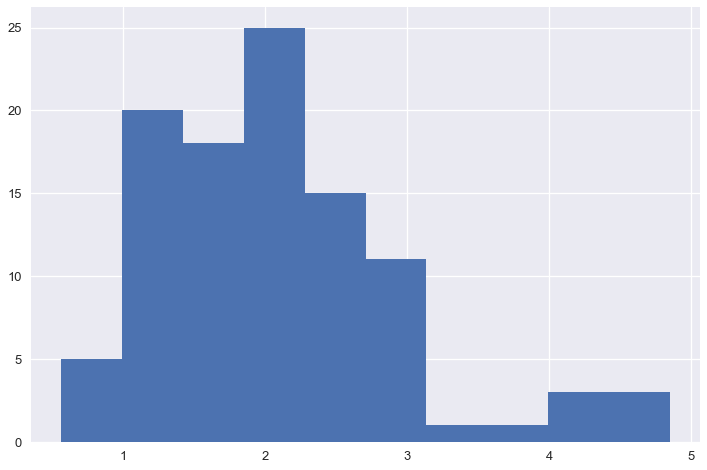

In [63]:
geotyp = geotyp.sort_values('author')
author_list = geotyp.author.tolist()
bookcounts = geotyp.books.tolist()
bookcounts = [int(i) for i in bookcounts]
most_books = max(bookcounts)
typdata = geotyp.iloc[:,1:6].as_matrix()

scaler = StandardScaler()
typ_scaled = scaler.fit_transform(typdata)
print(np.mean(typ_scaled), np.std(typ_scaled))
print(typ_scaled.shape)

distances = paired_euclidean_distances(typ_scaled, np.zeros(typ_scaled.shape))
fig = plt.hist(distances)

In [64]:
typ = pd.Series.from_array(distances, index=author_list)
print("Geotypical Prominent authors, from most typical to least")
typ.sort_values()

Geotypical Prominent authors, from most typical to least


Greene, Graham                       0.566
Huxley, Aldous                       0.578
West, Rebecca                        0.650
Chesterton, G. K.                    0.709
Wilde, Oscar                         0.790
James, Henry                         1.008
Bowen, Elizabeth                     1.019
Aldington, Richard                   1.076
Munro, Hector Hugh                   1.085
Waugh, Evelyn                        1.099
Maugham, William Somerset            1.110
Lawrence, D. H.                      1.133
Firbank, [Arthur Annesley] Ronald    1.142
Bentley, E. C.                       1.188
Conan Doyle, Arthur                  1.200
Wells, H. G.                         1.210
Galsworthy, John                     1.224
Lehmann, Rosamond                    1.253
Conrad, Joseph                       1.253
Stevenson, Robert Louis              1.276
Priestley, J. B.                     1.312
Orwell, George                       1.320
Bennett, Arnold                      1.355
Sinclair, M

In [65]:
typ_results = geotyp.join(pd.DataFrame(typ, columns=['distance']), how='left', on='author').sort_values('distance')
typ_results.head()

,author,intl_frac,occurs_100k,spec_world_subcity,spec_nongb_subcountry,london_frac,books,distance
54,"Greene, Graham",0.593,247.075,0.284,0.738,0.506,8.0,0.566
41,"Huxley, Aldous",0.659,234.712,0.276,0.678,0.530,13.0,0.578
33,"West, Rebecca",0.703,198.092,0.261,0.686,0.424,5.0,0.650
65,"Chesterton, G. K.",0.541,274.637,0.316,0.687,0.511,17.0,0.709
48,"Wilde, Oscar",0.625,266.173,0.265,0.652,0.559,3.0,0.790


In [66]:
typ_results.describe()

,intl_frac,occurs_100k,spec_world_subcity,spec_nongb_subcountry,london_frac,books,distance
count,102.000,102.000,102.000,102.000,102.000,102.000,102.000
mean,0.621,246.478,0.283,0.691,0.441,5.637,2.063
std,0.180,121.691,0.112,0.121,0.174,8.489,0.867
min,0.190,37.141,0.000,0.390,0.000,0.000,0.566
25%,0.487,164.830,0.211,0.620,0.327,1.000,1.508
50%,0.618,235.925,0.258,0.690,0.467,2.000,2.021
75%,0.771,310.625,0.315,0.774,0.559,6.000,2.479
max,1.000,674.224,0.761,1.000,0.811,55.000,4.852


In [67]:
typ_results[typ_results.author.isin(['Woolf, Virginia', 'Joyce, James'])]

,author,intl_frac,occurs_100k,spec_world_subcity,spec_nongb_subcountry,london_frac,books,distance
9,"Joyce, James",0.864,253.422,0.306,0.744,0.352,4.0,1.530
96,"Woolf, Virginia",0.369,212.066,0.314,0.401,0.584,10.0,2.934


In [68]:
# clustering
# Use the best combo of clusters and dimensions
num_clusters = 4
km = KMeans(n_clusters=num_clusters, random_state=0)
km.fit(typ_scaled)
clusters = km.labels_.tolist()

[1, 1, 2, 2, 0]

In [69]:
# Same data, but z-scores rather than raw numbers
#  Note that distance is raw, not z-score
typ_zscores = pd.concat(
    [
        pd.DataFrame(typ_scaled), 
        pd.DataFrame(distances), 
        pd.DataFrame(bookcounts), 
        pd.DataFrame(clusters)
    ], 
    axis=1
)
typ_zscores.columns = [
    'intl_frac', 
    'occurs_100k', 
    'world_subcity', 
    'nongb_subcountry', 
    'london_frac', 
    'distance', 
    'books',
    'cluster'
]
typ_zscores.index = author_list
typ_zscores.sort_values('distance', inplace=True)
typ_zscores.head(n=10)

,intl_frac,occurs_100k,world_subcity,nongb_subcountry,london_frac,distance,books,cluster
"Greene, Graham",-0.153,0.005,0.008,0.395,0.375,0.566,8,2
"Huxley, Aldous",0.211,-0.097,-0.063,-0.106,0.514,0.578,13,0
"West, Rebecca",0.458,-0.400,-0.203,-0.038,-0.099,0.650,5,0
"Chesterton, G. K.",-0.446,0.233,0.290,-0.030,0.405,0.709,17,2
"Wilde, Oscar",0.025,0.163,-0.170,-0.326,0.680,0.790,3,0
"James, Henry",0.295,-0.430,-0.317,0.601,0.532,1.008,15,2
"Bowen, Elizabeth",0.166,0.136,-0.469,-0.009,0.879,1.019,9,0
"Aldington, Richard",0.124,0.755,-0.608,-0.267,0.362,1.076,9,1
"Munro, Hector Hugh",0.414,0.490,-0.577,-0.362,0.550,1.085,6,0
"Waugh, Evelyn",-0.347,0.730,-0.247,-0.652,0.261,1.099,6,0


In [70]:
typ_zscores.loc[['Woolf, Virginia', 'Joyce, James', 'Richardson, Dorothy']]

,intl_frac,occurs_100k,world_subcity,nongb_subcountry,london_frac,distance,books,cluster
"Woolf, Virginia",-1.404,-0.284,0.273,-2.410,0.824,2.934,10,0
"Joyce, James",1.354,0.057,0.204,0.444,-0.515,1.530,4,1
"Richardson, Dorothy",-0.856,-0.083,0.060,-0.820,1.700,2.075,10,2


In [71]:
# Most and least London-centric
#  Authors by London/GB fraction z-score
typ_zscores.london_frac.sort_values(ascending=False)

du Maurier, Daphne           2.133
Carroll, Lewis               2.071
Beckett, Samuel              1.886
Richardson, Dorothy          1.700
Williams, Charles            1.673
Anstey, F.                   1.462
Hornung, E. W.               1.379
Warner, Sylvia               1.357
Rhys, Jean                   1.329
Moore, George                1.305
Weyman, Stanley J.           1.302
MacDonald, George            1.302
Powys, Theodore Francis      1.228
Gissing, George              1.085
Barrie, J. M.                1.071
Green, Henry                 0.911
Bowen, Elizabeth             0.879
Grossmith, George            0.871
Orwell, George               0.863
Sinclair, May                0.839
Woolf, Virginia              0.824
Sayers, Dorothy              0.724
Galsworthy, John             0.716
Mackenzie, Compton           0.712
Maugham, William Somerset    0.685
Wilde, Oscar                 0.680
Disraeli, Benjamin           0.671
Bennett, Arnold              0.635
Nesbit, Edith       

### Fraction specific listed places

#### Define sets

See way up at top of notebook for set definitions.

In [72]:
# Make a dictionary of sets for batch processing
place_groups = {
    'cultural':cultural,
    'parks':parks,
    'political':political,
    'river':river,
    'stations':stations,
    'misc':misc,
    'soho':soho,
    'bloomsbury':bloomsbury,
    'bloomsbury_parts':bloomsburyparts,
    'rich':rich,
    'poor':poor,
    'all_specified':specified_places
}

with open(os.path.join(resultsDir, 'list_of_specified_places.txt'), 'w') as f:
    for key in place_groups:
        f.write(key)
        f.write('\n-----')
        for item in sorted(place_groups[key]):
            f.write('\n')
            f.write(item)
        f.write('\n\n')

#### Output results

In [73]:
for key, placeset in place_groups.items():
    print("\n##################################################")
    print("##################################################")
    print("Fraction of London locations in set '%s':" % key)
    for i in placeset:
        print('\t',i)

    output = []
    for name, group in corpus_london_grouped:
        group_occurs = group.occurs_100k.sum()
        group_vols   = group.htid.nunique()
        avg_occurs   = group_occurs/group_vols
        byvol = group.groupby('htid')
        for htid, vol in byvol:
            weight = vol.occurs_100k.sum()/avg_occurs
            pub_date = vol.pub_date.values[0]
            ethnicity = vol.white.values[0]
            era = 'late'
            if pub_date < splitdate:
                era = 'early'
            spec_frac = vol.loc[(vol.text_string.isin(placeset))].occurs_100k.sum() /\
                        vol.occurs_100k.sum()
            output.append((name, pub_date, ethnicity, era, spec_frac, weight))
    df = pd.DataFrame.from_records(output)
    df.columns = ['corpus', 'pub_date', 'ethnicity', 'era', 'spec_frac', 'weight']

    # Group and run tests
    dfg = df.groupby('corpus')
    early = df.loc[(df.era=='early')].groupby('corpus')
    late = df.loc[(df.era=='late')].groupby('corpus')

    print("\nAll corpora, all dates")
    result = compare_groups(dfg, 'spec_frac', 'weight', ci, 
                            'fraction_london_places_'+key+'_by_corpus', 3)
    display(result)

    print("\nAll corpora, 1880-1913")
    result = compare_groups(early, 'spec_frac', 'weight', ci, 
                            'fraction_london_places_'+key+'_1880_1913_by_corpus', 3)
    display(result)

    print("\nAll corpora, 1914-1940")
    result = compare_groups(late, 'spec_frac', 'weight', ci, 
                            'fraction_london_places_'+key+'_1914_1940_by_corpus', 3)
    display(result)

    print("\nWithin corpora by era")
    for name, group in dfg:
        result = compare_groups(group.groupby('era'), 'spec_frac',
                                'weight', ci, 'fraction_london_places_'+key+'_by_era_'+name, 3)
        display(name, result)

    print("\nBy ethnicity in Foreign")
    result = compare_groups(dfg.get_group('Foreign').groupby('ethnicity'), 'spec_frac',
                            'weight', ci, 'fraction_london_places_'+key+'by_ethnicity_in_foreign', 3)
    display(result)

### USE FOR PUBLICATION ###

##################################################
##################################################
Fraction of London locations in set 'cultural':
	 British Museum
	 National Gallery
	 London Library
	 South Kensington Museum

All corpora, all dates


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,2.733e-03,0.005,0.008,Hathi,1.803e-03,0.002,0.002,1.094e-02,#
1,Foreign,2.733e-03,0.005,0.008,London,8.900e-04,0.002,0.003,3.144e-03,##
2,Foreign,2.733e-03,0.005,0.008,Prominent,2.477e-03,0.004,0.006,5.780e-01,
3,Hathi,1.803e-03,0.002,0.002,London,8.900e-04,0.002,0.003,7.528e-01,
4,Hathi,1.803e-03,0.002,0.002,Prominent,2.477e-03,0.004,0.006,5.850e-04,###
5,London,8.900e-04,0.002,0.003,Prominent,2.477e-03,0.004,0.006,1.298e-01,



All corpora, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,4.267e-03,0.007,0.009,Hathi,1.688e-03,0.002,0.002,8.494e-03,##
1,Foreign,4.267e-03,0.007,0.009,London,5.864e-04,0.001,0.002,1.783e-05,###
2,Foreign,4.267e-03,0.007,0.009,Prominent,1.730e-03,0.003,0.004,3.760e-04,###
3,Hathi,1.688e-03,0.002,0.002,London,5.864e-04,0.001,0.002,6.740e-01,
4,Hathi,1.688e-03,0.002,0.002,Prominent,1.730e-03,0.003,0.004,5.322e-01,
5,London,5.864e-04,0.001,0.002,Prominent,1.730e-03,0.003,0.004,1.201e-01,



All corpora, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,-4.698e-03,0.002,0.010,Hathi,1.753e-03,0.002,0.002,8.449e-01,
1,Foreign,-4.698e-03,0.002,0.010,London,4.969e-04,0.002,0.004,9.332e-01,
2,Foreign,-4.698e-03,0.002,0.010,Prominent,2.388e-03,0.006,0.009,5.266e-01,
3,Hathi,1.753e-03,0.002,0.002,London,4.969e-04,0.002,0.004,9.253e-01,
4,Hathi,1.753e-03,0.002,0.002,Prominent,2.388e-03,0.006,0.009,4.233e-06,###
5,London,4.969e-04,0.002,0.004,Prominent,2.388e-03,0.006,0.009,3.176e-01,



Within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.004,0.007,0.009,late,-0.005,0.002,0.01,0.151,


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.002,0.002,0.002,late,0.002,0.002,0.002,0.965,


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,5.864e-04,0.001,0.002,late,4.969e-04,0.002,0.004,0.367,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.002,0.003,0.004,late,0.002,0.006,0.009,0.121,



By ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.003,0.006,0.01,White,4.217e-04,0.002,0.004,0.208,



##################################################
##################################################
Fraction of London locations in set 'parks':
	 Regent'S Park
	 Hyde Park
	 Green Park
	 St. James'S Park
	 Kensington Gardens
	 St. James' Park
	 St Jame'S Park
	 St. James’S Park
	 Regents Park
	 Regent Park
	 Kew
	 Regent’S Park
	 Kew Gardens

All corpora, all dates


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.022,0.028,0.034,Hathi,0.016,0.017,0.018,0.011,#
1,Foreign,0.022,0.028,0.034,London,0.014,0.018,0.022,0.003,##
2,Foreign,0.022,0.028,0.034,Prominent,0.018,0.021,0.025,0.073,
3,Hathi,0.016,0.017,0.018,London,0.014,0.018,0.022,0.771,
4,Hathi,0.016,0.017,0.018,Prominent,0.018,0.021,0.025,0.021,#
5,London,0.014,0.018,0.022,Prominent,0.018,0.021,0.025,0.214,



All corpora, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.028,0.036,0.043,Hathi,0.014,0.015,0.016,7.366e-06,###
1,Foreign,0.028,0.036,0.043,London,0.012,0.016,0.021,1.688e-05,###
2,Foreign,0.028,0.036,0.043,Prominent,0.014,0.019,0.024,1.045e-03,##
3,Hathi,0.014,0.015,0.016,London,0.012,0.016,0.021,7.270e-01,
4,Hathi,0.014,0.015,0.016,Prominent,0.014,0.019,0.024,1.410e-01,
5,London,0.012,0.016,0.021,Prominent,0.014,0.019,0.024,5.762e-01,



All corpora, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.002,0.010,0.019,Hathi,0.017,0.019,0.022,0.373,
1,Foreign,0.002,0.010,0.019,London,0.012,0.019,0.026,0.121,
2,Foreign,0.002,0.010,0.019,Prominent,0.020,0.024,0.027,0.023,#
3,Hathi,0.017,0.019,0.022,London,0.012,0.019,0.026,0.980,
4,Hathi,0.017,0.019,0.022,Prominent,0.020,0.024,0.027,0.251,
5,London,0.012,0.019,0.026,Prominent,0.020,0.024,0.027,0.324,



Within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.028,0.036,0.043,late,0.002,0.01,0.019,1.502e-04,###


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.014,0.015,0.016,late,0.017,0.019,0.022,1.659e-05,###


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.012,0.016,0.021,late,0.012,0.019,0.026,0.482,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.014,0.019,0.024,late,0.02,0.024,0.027,0.146,



By ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.027,0.035,0.042,White,5.770e-04,0.009,0.017,3.048e-04,###



##################################################
##################################################
Fraction of London locations in set 'political':
	 Hyde Park Corner
	 Westminster
	 Downing Street

All corpora, all dates


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.006,0.012,0.018,Hathi,0.007,0.007,0.008,0.040,#
1,Foreign,0.006,0.012,0.018,London,0.005,0.007,0.010,0.118,
2,Foreign,0.006,0.012,0.018,Prominent,0.006,0.008,0.010,0.099,
3,Hathi,0.007,0.007,0.008,London,0.005,0.007,0.010,0.946,
4,Hathi,0.007,0.007,0.008,Prominent,0.006,0.008,0.010,0.518,
5,London,0.005,0.007,0.010,Prominent,0.006,0.008,0.010,0.638,



All corpora, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.008,0.011,0.014,Hathi,0.007,0.007,0.008,0.191,
1,Foreign,0.008,0.011,0.014,London,0.005,0.008,0.012,0.206,
2,Foreign,0.008,0.011,0.014,Prominent,0.006,0.009,0.012,0.417,
3,Hathi,0.007,0.007,0.008,London,0.005,0.008,0.012,0.775,
4,Hathi,0.007,0.007,0.008,Prominent,0.006,0.009,0.012,0.348,
5,London,0.005,0.008,0.012,Prominent,0.006,0.009,0.012,0.757,



All corpora, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,-0.006,0.015,0.035,Hathi,0.007,0.008,0.009,0.062,
1,Foreign,-0.006,0.015,0.035,London,0.004,0.006,0.009,0.273,
2,Foreign,-0.006,0.015,0.035,Prominent,0.006,0.008,0.010,0.125,
3,Hathi,0.007,0.008,0.009,London,0.004,0.006,0.009,0.564,
4,Hathi,0.007,0.008,0.009,Prominent,0.006,0.008,0.010,0.844,
5,London,0.004,0.006,0.009,Prominent,0.006,0.008,0.010,0.596,



Within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.008,0.011,0.014,late,-0.006,0.015,0.035,0.61,


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.007,0.007,0.008,late,0.007,0.008,0.009,0.291,


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.005,0.008,0.012,late,0.004,0.006,0.009,0.51,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.006,0.009,0.012,late,0.006,0.008,0.01,0.474,



By ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.008,0.011,0.014,White,-0.011,0.014,0.039,0.684,



##################################################
##################################################
Fraction of London locations in set 'river':
	 Thames
	 Victoria Embankment Gardens
	 London Bridge
	 Thames River
	 Blackfriars Bridge
	 Blackfriar'S Bridge
	 River Thames
	 Waterloo Bridge
	 Victoria Embankment
	 Westminster Bridge
	 Embankment Gardens

All corpora, all dates


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.013,0.018,0.023,Hathi,0.015,0.015,0.016,0.386,
1,Foreign,0.013,0.018,0.023,London,0.012,0.015,0.018,0.272,
2,Foreign,0.013,0.018,0.023,Prominent,0.011,0.013,0.015,0.076,
3,Hathi,0.015,0.015,0.016,London,0.012,0.015,0.018,0.938,
4,Hathi,0.015,0.015,0.016,Prominent,0.011,0.013,0.015,0.139,
5,London,0.012,0.015,0.018,Prominent,0.011,0.013,0.015,0.389,



All corpora, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.016,0.021,0.025,Hathi,0.014,0.015,0.016,0.192,
1,Foreign,0.016,0.021,0.025,London,0.012,0.016,0.020,0.092,
2,Foreign,0.016,0.021,0.025,Prominent,0.014,0.018,0.021,0.391,
3,Hathi,0.014,0.015,0.016,London,0.012,0.016,0.020,0.919,
4,Hathi,0.014,0.015,0.016,Prominent,0.014,0.018,0.021,0.313,
5,London,0.012,0.016,0.020,Prominent,0.014,0.018,0.021,0.533,



All corpora, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,-6.239e-04,0.013,0.026,Hathi,0.014,0.015,0.017,0.637,
1,Foreign,-6.239e-04,0.013,0.026,London,0.009,0.014,0.020,0.773,
2,Foreign,-6.239e-04,0.013,0.026,Prominent,0.006,0.009,0.012,0.527,
3,Hathi,1.418e-02,0.015,0.017,London,0.009,0.014,0.020,0.799,
4,Hathi,1.418e-02,0.015,0.017,Prominent,0.006,0.009,0.012,0.002,##
5,London,8.744e-03,0.014,0.020,Prominent,0.006,0.009,0.012,0.162,



Within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.016,0.021,0.025,late,-6.239e-04,0.013,0.026,0.13,


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.014,0.015,0.016,late,0.014,0.015,0.017,0.948,


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.012,0.016,0.02,late,0.009,0.014,0.02,0.684,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.014,0.018,0.021,late,0.006,0.009,0.012,6.249e-04,###



By ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.016,0.021,0.027,White,-3.475e-04,0.009,0.018,0.027,#



##################################################
##################################################
Fraction of London locations in set 'stations':
	 Euston Station
	 Paddington
	 Paddington Station
	 Victoria Station
	 St Pancras
	 St. Pancras
	 Waterloo Station
	 St. Pancras Station

All corpora, all dates


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.005,0.008,0.010,Hathi,0.006,0.007,0.008,8.204e-01,
1,Foreign,0.005,0.008,0.010,London,0.012,0.028,0.044,4.457e-02,#
2,Foreign,0.005,0.008,0.010,Prominent,0.008,0.010,0.011,2.098e-01,
3,Hathi,0.006,0.007,0.008,London,0.012,0.028,0.044,2.648e-14,###
4,Hathi,0.006,0.007,0.008,Prominent,0.008,0.010,0.011,3.500e-02,#
5,London,0.012,0.028,0.044,Prominent,0.008,0.010,0.011,1.712e-04,###



All corpora, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.006,0.009,0.012,Hathi,0.006,0.006,0.007,4.448e-01,
1,Foreign,0.006,0.009,0.012,London,0.012,0.040,0.067,4.893e-02,#
2,Foreign,0.006,0.009,0.012,Prominent,0.006,0.008,0.010,6.176e-01,
3,Hathi,0.006,0.006,0.007,London,0.012,0.040,0.067,6.054e-17,###
4,Hathi,0.006,0.006,0.007,Prominent,0.006,0.008,0.010,3.731e-01,
5,London,0.012,0.040,0.067,Prominent,0.006,0.008,0.010,4.174e-04,###



All corpora, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,-2.900e-04,0.004,0.008,Hathi,0.007,0.008,0.009,0.303,
1,Foreign,-2.900e-04,0.004,0.008,London,0.006,0.011,0.016,0.056,
2,Foreign,-2.900e-04,0.004,0.008,Prominent,0.009,0.011,0.013,0.027,#
3,Hathi,7.351e-03,0.008,0.009,London,0.006,0.011,0.016,0.339,
4,Hathi,7.351e-03,0.008,0.009,Prominent,0.009,0.011,0.013,0.045,#
5,London,6.189e-03,0.011,0.016,Prominent,0.009,0.011,0.013,0.967,



Within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.006,0.009,0.012,late,-2.900e-04,0.004,0.008,0.034,#


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.006,0.006,0.007,late,0.007,0.008,0.009,0.008,##


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.012,0.04,0.067,late,0.006,0.011,0.016,0.081,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.006,0.008,0.01,late,0.009,0.011,0.013,0.068,



By ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.006,0.009,0.012,White,-3.505e-04,0.005,0.009,0.137,



##################################################
##################################################
Fraction of London locations in set 'misc':
	 Buckingham Palace
	 City Of London
	 Soho
	 Bloomsbury
	 Trafalgar Square
	 City

All corpora, all dates


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.008,0.014,0.020,Hathi,0.011,0.011,0.012,4.303e-01,
1,Foreign,0.008,0.014,0.020,London,0.021,0.043,0.065,3.613e-02,#
2,Foreign,0.008,0.014,0.020,Prominent,0.020,0.023,0.026,9.489e-03,##
3,Hathi,0.011,0.011,0.012,London,0.021,0.043,0.065,3.093e-25,###
4,Hathi,0.011,0.011,0.012,Prominent,0.020,0.023,0.026,3.835e-14,###
5,London,0.021,0.043,0.065,Prominent,0.020,0.023,0.026,2.728e-03,##



All corpora, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.007,0.013,0.018,Hathi,0.008,0.009,0.010,3.469e-01,
1,Foreign,0.007,0.013,0.018,London,0.019,0.058,0.096,3.680e-02,#
2,Foreign,0.007,0.013,0.018,Prominent,0.014,0.018,0.022,1.336e-01,
3,Hathi,0.008,0.009,0.010,London,0.019,0.058,0.096,1.080e-29,###
4,Hathi,0.008,0.009,0.010,Prominent,0.014,0.018,0.022,3.717e-05,###
5,London,0.019,0.058,0.096,Prominent,0.014,0.018,0.022,1.696e-03,##



All corpora, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.002,0.017,0.032,Hathi,0.015,0.016,0.017,8.548e-01,
1,Foreign,0.002,0.017,0.032,London,0.017,0.023,0.030,3.591e-01,
2,Foreign,0.002,0.017,0.032,Prominent,0.022,0.027,0.031,1.423e-01,
3,Hathi,0.015,0.016,0.017,London,0.017,0.023,0.030,6.052e-02,
4,Hathi,0.015,0.016,0.017,Prominent,0.022,0.027,0.031,1.020e-07,###
5,London,0.017,0.023,0.030,Prominent,0.022,0.027,0.031,4.745e-01,



Within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.007,0.013,0.018,late,0.002,0.017,0.032,0.509,


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.008,0.009,0.01,late,0.015,0.016,0.017,8.739e-20,###


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.019,0.058,0.096,late,0.017,0.023,0.03,0.133,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.014,0.018,0.022,late,0.022,0.027,0.031,0.004,##



By ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.008,0.013,0.018,White,-2.079e-04,0.017,0.033,0.596,



##################################################
##################################################
Fraction of London locations in set 'soho':
	 Soho

All corpora, all dates


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,3.854e-04,0.002,0.003,Hathi,0.003,0.004,0.004,2.024e-01,
1,Foreign,3.854e-04,0.002,0.003,London,0.005,0.007,0.010,5.423e-04,###
2,Foreign,3.854e-04,0.002,0.003,Prominent,0.007,0.009,0.011,8.179e-04,###
3,Hathi,3.242e-03,0.004,0.004,London,0.005,0.007,0.010,6.747e-04,###
4,Hathi,3.242e-03,0.004,0.004,Prominent,0.007,0.009,0.011,1.026e-17,###
5,London,4.947e-03,0.007,0.010,Prominent,0.007,0.009,0.011,3.340e-01,



All corpora, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,-3.927e-04,0.001,0.003,Hathi,0.002,0.003,0.003,3.901e-01,
1,Foreign,-3.927e-04,0.001,0.003,London,0.003,0.006,0.009,9.792e-03,##
2,Foreign,-3.927e-04,0.001,0.003,Prominent,0.006,0.009,0.012,8.029e-03,##
3,Hathi,2.188e-03,0.003,0.003,London,0.003,0.006,0.009,1.072e-02,#
4,Hathi,2.188e-03,0.003,0.003,Prominent,0.006,0.009,0.012,7.778e-12,###
5,London,3.009e-03,0.006,0.009,Prominent,0.006,0.009,0.012,3.105e-01,



All corpora, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,1.891e-04,0.003,0.006,Hathi,0.005,0.005,0.006,4.109e-01,
1,Foreign,1.891e-04,0.003,0.006,London,0.005,0.009,0.013,4.772e-02,#
2,Foreign,1.891e-04,0.003,0.006,Prominent,0.007,0.010,0.012,9.028e-02,
3,Hathi,4.878e-03,0.005,0.006,London,0.005,0.009,0.013,5.072e-02,
4,Hathi,4.878e-03,0.005,0.006,Prominent,0.007,0.010,0.012,3.498e-05,###
5,London,5.274e-03,0.009,0.013,Prominent,0.007,0.010,0.012,8.941e-01,



Within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,-3.927e-04,0.001,0.003,late,1.891e-04,0.003,0.006,0.236,


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.002,0.003,0.003,late,0.005,0.005,0.006,1.002e-21,###


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.003,0.006,0.009,late,0.005,0.009,0.013,0.168,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.006,0.009,0.012,late,0.007,0.01,0.012,0.594,



By ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,-2.252e-04,0.001,0.003,White,-8.775e-05,0.003,0.006,0.322,



##################################################
##################################################
Fraction of London locations in set 'bloomsbury':
	 Bloomsbury

All corpora, all dates


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.001,0.004,0.007,Hathi,0.003,0.003,0.004,5.820e-01,
1,Foreign,0.001,0.004,0.007,London,0.007,0.029,0.051,7.570e-02,
2,Foreign,0.001,0.004,0.007,Prominent,0.004,0.005,0.006,5.790e-01,
3,Hathi,0.003,0.003,0.004,London,0.007,0.029,0.051,3.250e-26,###
4,Hathi,0.003,0.003,0.004,Prominent,0.004,0.005,0.006,4.581e-02,#
5,London,0.007,0.029,0.051,Prominent,0.004,0.005,0.006,2.016e-04,###



All corpora, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,-2.878e-04,0.002,0.005,Hathi,0.002,0.003,0.004,8.082e-01,
1,Foreign,-2.878e-04,0.002,0.005,London,0.006,0.044,0.083,4.866e-02,#
2,Foreign,-2.878e-04,0.002,0.005,Prominent,0.002,0.003,0.005,5.350e-01,
3,Hathi,2.329e-03,0.003,0.004,London,0.006,0.044,0.083,3.383e-27,###
4,Hathi,2.329e-03,0.003,0.004,Prominent,0.002,0.003,0.005,9.603e-01,
5,London,6.319e-03,0.044,0.083,Prominent,0.002,0.003,0.005,7.044e-04,###



All corpora, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,9.928e-04,0.009,0.017,Hathi,0.003,0.003,0.003,4.593e-03,##
1,Foreign,9.928e-04,0.009,0.017,London,0.003,0.007,0.012,6.463e-01,
2,Foreign,9.928e-04,0.009,0.017,Prominent,0.005,0.007,0.009,4.685e-01,
3,Hathi,2.604e-03,0.003,0.003,London,0.003,0.007,0.012,6.261e-03,##
4,Hathi,2.604e-03,0.003,0.003,Prominent,0.005,0.007,0.009,8.138e-07,###
5,London,2.576e-03,0.007,0.012,Prominent,0.005,0.007,0.009,8.889e-01,



Within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,-2.878e-04,0.002,0.005,late,9.928e-04,0.009,0.017,0.037,#


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.002,0.003,0.004,late,0.003,0.003,0.003,0.952,


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.006,0.044,0.083,late,0.003,0.007,0.012,0.101,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.002,0.003,0.005,late,0.005,0.007,0.009,0.003,##



By ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,-5.074e-04,0.002,0.005,White,0.002,0.01,0.019,0.023,#



##################################################
##################################################
Fraction of London locations in set 'bloomsbury_parts':
	 Gray’S Inn Road
	 Euston Road
	 Tottenham Court Road
	 Russell Square
	 Gray'S Inn Road

All corpora, all dates


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.003,0.005,0.007,Hathi,0.004,0.004,0.004,4.317e-01,
1,Foreign,0.003,0.005,0.007,London,0.005,0.009,0.013,1.180e-01,
2,Foreign,0.003,0.005,0.007,Prominent,0.007,0.008,0.010,9.102e-02,
3,Hathi,0.004,0.004,0.004,London,0.005,0.009,0.013,5.529e-06,###
4,Hathi,0.004,0.004,0.004,Prominent,0.007,0.008,0.010,1.008e-10,###
5,London,0.005,0.009,0.013,Prominent,0.007,0.008,0.010,5.758e-01,



All corpora, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.002,0.005,0.007,Hathi,0.003,0.003,0.004,3.730e-01,
1,Foreign,0.002,0.005,0.007,London,0.004,0.007,0.011,2.409e-01,
2,Foreign,0.002,0.005,0.007,Prominent,0.005,0.007,0.010,2.654e-01,
3,Hathi,0.003,0.003,0.004,London,0.004,0.007,0.011,3.941e-03,##
4,Hathi,0.003,0.003,0.004,Prominent,0.005,0.007,0.010,2.268e-05,###
5,London,0.004,0.007,0.011,Prominent,0.005,0.007,0.010,9.180e-01,



All corpora, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,-2.693e-04,0.005,0.011,Hathi,0.004,0.005,0.005,8.184e-01,
1,Foreign,-2.693e-04,0.005,0.011,London,0.003,0.012,0.020,3.428e-01,
2,Foreign,-2.693e-04,0.005,0.011,Prominent,0.007,0.009,0.011,3.252e-01,
3,Hathi,4.278e-03,0.005,0.005,London,0.003,0.012,0.020,8.852e-04,###
4,Hathi,4.278e-03,0.005,0.005,Prominent,0.007,0.009,0.011,4.733e-05,###
5,London,3.125e-03,0.012,0.020,Prominent,0.007,0.009,0.011,3.839e-01,



Within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.002,0.005,0.007,late,-2.693e-04,0.005,0.011,0.768,


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.003,0.003,0.004,late,0.004,0.005,0.005,1.945e-06,###


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.004,0.007,0.011,late,0.003,0.012,0.02,0.329,


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.005,0.007,0.01,late,0.007,0.009,0.011,0.314,



By ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.002,0.004,0.007,White,7.855e-05,0.006,0.013,0.466,



##################################################
##################################################
Fraction of London locations in set 'rich':
	 Chelsea
	 Belgravia
	 Bond Street
	 Park Lane
	 Mayfair

All corpora, all dates


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.005,0.007,0.010,Hathi,0.012,0.013,0.014,0.048,#
1,Foreign,0.005,0.007,0.010,London,0.011,0.014,0.018,0.004,##
2,Foreign,0.005,0.007,0.010,Prominent,0.012,0.014,0.017,0.003,##
3,Hathi,0.012,0.013,0.014,London,0.011,0.014,0.018,0.570,
4,Hathi,0.012,0.013,0.014,Prominent,0.012,0.014,0.017,0.307,
5,London,0.011,0.014,0.018,Prominent,0.012,0.014,0.017,0.995,



All corpora, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.005,0.008,0.011,Hathi,0.012,0.013,0.014,0.139,
1,Foreign,0.005,0.008,0.011,London,0.007,0.011,0.015,0.184,
2,Foreign,0.005,0.008,0.011,Prominent,0.008,0.011,0.014,0.187,
3,Hathi,0.012,0.013,0.014,London,0.007,0.011,0.015,0.512,
4,Hathi,0.012,0.013,0.014,Prominent,0.008,0.011,0.014,0.300,
5,London,0.007,0.011,0.015,Prominent,0.008,0.011,0.014,0.998,



All corpora, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,4.082e-04,0.006,0.011,Hathi,0.012,0.013,0.014,0.170,
1,Foreign,4.082e-04,0.006,0.011,London,0.012,0.019,0.027,0.018,#
2,Foreign,4.082e-04,0.006,0.011,Prominent,0.014,0.017,0.021,0.022,#
3,Hathi,1.181e-02,0.013,0.014,London,0.012,0.019,0.027,0.085,
4,Hathi,1.181e-02,0.013,0.014,Prominent,0.014,0.017,0.021,0.015,#
5,London,1.178e-02,0.019,0.027,Prominent,0.014,0.017,0.021,0.628,



Within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.005,0.008,0.011,late,4.082e-04,0.006,0.011,0.444,


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.012,0.013,0.014,late,0.012,0.013,0.014,0.649,


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.007,0.011,0.015,late,0.012,0.019,0.027,0.034,#


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.008,0.011,0.014,late,0.014,0.017,0.021,0.004,##



By ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.004,0.006,0.008,White,0.003,0.011,0.019,0.071,



##################################################
##################################################
Fraction of London locations in set 'poor':
	 Limehouse
	 East End
	 East India Dock Road
	 Mile End Road
	 East End Of London
	 West India Dock Road
	 Whitechapel

All corpora, all dates


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.001,0.004,0.007,Hathi,0.004,0.004,0.005,9.442e-01,
1,Foreign,0.001,0.004,0.007,London,0.009,0.017,0.025,1.126e-02,#
2,Foreign,0.001,0.004,0.007,Prominent,0.002,0.003,0.004,4.303e-01,
3,Hathi,0.004,0.004,0.005,London,0.009,0.017,0.025,2.243e-12,###
4,Hathi,0.004,0.004,0.005,Prominent,0.002,0.003,0.004,1.699e-01,
5,London,0.009,0.017,0.025,Prominent,0.002,0.003,0.004,2.093e-08,###



All corpora, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.001,0.004,0.007,Hathi,0.003,0.004,0.004,0.989,
1,Foreign,0.001,0.004,0.007,London,0.003,0.009,0.015,0.135,
2,Foreign,0.001,0.004,0.007,Prominent,0.002,0.003,0.004,0.481,
3,Hathi,0.003,0.004,0.004,London,0.003,0.009,0.015,0.026,#
4,Hathi,0.003,0.004,0.004,Prominent,0.002,0.003,0.004,0.516,
5,London,0.003,0.009,0.015,Prominent,0.002,0.003,0.004,0.003,##



All corpora, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,-0.003,0.005,0.013,Hathi,0.005,0.005,0.006,9.298e-01,
1,Foreign,-0.003,0.005,0.013,London,0.011,0.028,0.045,6.997e-02,
2,Foreign,-0.003,0.005,0.013,Prominent,0.001,0.003,0.005,5.559e-01,
3,Hathi,0.005,0.005,0.006,London,0.011,0.028,0.045,2.560e-15,###
4,Hathi,0.005,0.005,0.006,Prominent,0.001,0.003,0.005,8.879e-02,
5,London,0.011,0.028,0.045,Prominent,0.001,0.003,0.005,9.222e-08,###



Within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.001,0.004,0.007,late,-0.003,0.005,0.013,0.734,


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.003,0.004,0.004,late,0.005,0.005,0.006,0.002,##


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.003,0.009,0.015,late,0.011,0.028,0.045,0.019,#


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.002,0.003,0.004,late,0.001,0.003,0.005,0.841,



By ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.001,0.004,0.006,White,-0.004,0.006,0.015,0.618,



##################################################
##################################################
Fraction of London locations in set 'all_specified':
	 St. James'S Park
	 St. James' Park
	 St. James’S Park
	 Regents Park
	 Thames River
	 Paddington
	 St Pancras
	 Bloomsbury
	 Blackfriar'S Bridge
	 St. Pancras
	 Trafalgar Square
	 Victoria Embankment
	 National Gallery
	 Regent Park
	 Gray'S Inn Road
	 Westminster
	 Thames
	 Hyde Park Corner
	 Euston Station
	 Gray’S Inn Road
	 Waterloo Bridge
	 Westminster Bridge
	 Kew
	 Kew Gardens
	 City Of London
	 St Jame'S Park
	 Victoria Station
	 Soho
	 Downing Street
	 London Library
	 City
	 Waterloo Station
	 Russell Square
	 British Museum
	 Buckingham Palace
	 Regent'S Park
	 Victoria Embankment Gardens
	 South Kensington Museum
	 Hyde Park
	 Green Park
	 London Bridge
	 Kensington Gardens
	 Blackfriars Bridge
	 Paddington Station
	 River Thames
	 Embankment Gardens
	 Euston Road
	 Tottenham Court Road
	 Regent’S Park
	 St. Pancras St

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.078,0.090,0.103,Hathi,0.062,0.064,0.065,6.698e-04,###
1,Foreign,0.078,0.090,0.103,London,0.095,0.122,0.148,6.620e-02,
2,Foreign,0.078,0.090,0.103,Prominent,0.082,0.088,0.094,7.315e-01,
3,Hathi,0.062,0.064,0.065,London,0.095,0.122,0.148,3.881e-18,###
4,Hathi,0.062,0.064,0.065,Prominent,0.082,0.088,0.094,3.875e-11,###
5,London,0.095,0.122,0.148,Prominent,0.082,0.088,0.094,3.017e-04,###



All corpora, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.088,0.101,0.113,Hathi,0.056,0.058,0.06,3.571e-06,###
1,Foreign,0.088,0.101,0.113,London,0.102,0.146,0.19,7.131e-02,
2,Foreign,0.088,0.101,0.113,Prominent,0.074,0.082,0.09,2.392e-02,#
3,Hathi,0.056,0.058,0.060,London,0.102,0.146,0.19,1.142e-23,###
4,Hathi,0.056,0.058,0.060,Prominent,0.074,0.082,0.09,6.910e-06,###
5,London,0.102,0.146,0.190,Prominent,0.074,0.082,0.09,3.804e-05,###



All corpora, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,0.037,0.066,0.095,Hathi,0.071,0.074,0.076,6.038e-01,
1,Foreign,0.037,0.066,0.095,London,0.072,0.088,0.105,1.509e-01,
2,Foreign,0.037,0.066,0.095,Prominent,0.083,0.093,0.102,6.683e-02,
3,Hathi,0.071,0.074,0.076,London,0.072,0.088,0.105,1.526e-01,
4,Hathi,0.071,0.074,0.076,Prominent,0.083,0.093,0.102,2.363e-04,###
5,London,0.072,0.088,0.105,Prominent,0.083,0.093,0.102,6.838e-01,



Within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.088,0.101,0.113,late,0.037,0.066,0.095,0.01,##


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.056,0.058,0.06,late,0.071,0.074,0.076,2.501e-17,###


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.102,0.146,0.19,late,0.072,0.088,0.105,0.032,#


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,0.074,0.082,0.09,late,0.083,0.093,0.102,0.102,



By ethnicity in Foreign


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,0.087,0.1,0.113,White,0.032,0.062,0.092,0.008,##


## Centers of gravity

In [75]:
# Centers of gravity
print("London centers of gravity by corpus")

cog_ignore = frozenset([
    'Thames',
    'River Thames',
    'Thames River'
])

# Build weighted dataframe
output = []
for name, group in corpus_london_grouped:
    reduced  = group.loc[(group.formatted_address != 'London, UK')]
    group_occurs = reduced.occurs_100k.sum()
    group_vols   = reduced.htid.nunique()
    avg_occurs   = group_occurs/group_vols
    byvol = reduced.groupby('htid')
    for htid, vol in byvol:
        weight = vol.occurs_100k.sum()/avg_occurs
        pub_date = vol.pub_date.values[0]
        ethnicity = vol.white.values[0]
        genre = vol.genre.values[0]
        genre_class = 'Fiction'
        if genre.startswith('Fic') == False:
            genre_class = 'Nonfiction'
        era = 'late'
        if pub_date < splitdate:
            era = 'early'
        try:
            avg_lat = vol.loc[(~vol.text_string.isin(cog_ignore))].lat.multiply(vol.occurs_100k).sum() /\
                      vol.loc[(~vol.text_string.isin(cog_ignore))].occurs_100k.sum()
        except ZeroDivisionError:
            avg_lat = False
        try:
            avg_lon = vol.loc[(~vol.text_string.isin(cog_ignore))].lon.multiply(vol.occurs_100k).sum() /\
                      vol.loc[(~vol.text_string.isin(cog_ignore))].occurs_100k.sum()
        except ZeroDivisionError:
            avg_lon = False
        if avg_lat and avg_lon:
            output.append((name, pub_date, ethnicity, era, genre_class, avg_lat, avg_lon, weight))
cog = pd.DataFrame.from_records(output)
cog.columns = ['corpus', 'pub_date', 'ethnicity', 'era', 'genre', 'avg_lat', 'avg_lon', 'weight']

# Group and run tests
cogg = cog.groupby('corpus')
result = compare_groups(cogg, ['avg_lat', 'avg_lon'], 'weight', ci, 'cog_by_corpus', 3)
display(result)

cogg_early = cog.loc[(cog.era == 'early')].groupby('corpus')
cogg_late  = cog.loc[(cog.era == 'late')].groupby('corpus')
print("\nCenters of gravity, 1880-1913")
result = compare_groups(cogg_early, ['avg_lat', 'avg_lon'], 'weight', ci, 
                        'cog_1880_1913_by_corpus', 3)
display(result)

print("\ncenters of gravity, 1914-1940")
result = compare_groups(cogg_late, ['avg_lat', 'avg_lon'], 'weight', ci, 
                        'cog_1914_1940_by_corpus', 3)
display(result)

print("Centers of gravity by ethnicity in Foreign corpus")
result = compare_groups(cogg.get_group('Foreign').groupby('ethnicity'), ['avg_lat', 'avg_lon'],
                        'weight', ci, 'cog_by_ethnicity_in_foreign', 3)
display(result)

print("Centers of gravity by genre in Foreign corpus")
result = compare_groups(cogg.get_group('Foreign').groupby('genre'), ['avg_lat', 'avg_lon'],
                        'weight', ci, 'cog_by_genre_in_foreign', 3)
display(result)

print("Centers of gravity within corpora by era")
for name, group in cogg:
    result = compare_groups(group.groupby('era'), ['avg_lat', 'avg_lon'],
                            'weight', ci, 'cog_by_era_'+name, 3)
    display(name, result)

### USE FOR PUBLICATION ###
London centers of gravity by corpus


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,"[51.5004545697, -0.156264988646]","[51.5030301961, -0.150274496269]","[51.5056058226, -0.144284003891]",Hathi,"[51.5036929341, -0.145117293506]","[51.5041656122, -0.144037060128]","[51.5046382903, -0.142956826751]","[0.589749197497, 0.194991786129]",
1,Foreign,"[51.5004545697, -0.156264988646]","[51.5030301961, -0.150274496269]","[51.5056058226, -0.144284003891]",London,"[51.5087569977, -0.132950527846]","[51.5107435931, -0.12830521977]","[51.5127301885, -0.123659911694]","[5.3753539733e-06, 3.79450101768e-08]",###
2,Foreign,"[51.5004545697, -0.156264988646]","[51.5030301961, -0.150274496269]","[51.5056058226, -0.144284003891]",Prominent,"[51.4999454317, -0.158222131611]","[51.5016752108, -0.154680628396]","[51.50340499, -0.151139125181]","[0.519795481602, 0.311714105835]",
3,Hathi,"[51.5036929341, -0.145117293506]","[51.5041656122, -0.144037060128]","[51.5046382903, -0.142956826751]",London,"[51.5087569977, -0.132950527846]","[51.5107435931, -0.12830521977]","[51.5127301885, -0.123659911694]","[2.96331716902e-05, 1.24710836128e-05]",###
4,Hathi,"[51.5036929341, -0.145117293506]","[51.5041656122, -0.144037060128]","[51.5046382903, -0.142956826751]",Prominent,"[51.4999454317, -0.158222131611]","[51.5016752108, -0.154680628396]","[51.50340499, -0.151139125181]","[0.00820312637577, 6.66454891496e-07]",###
5,London,"[51.5087569977, -0.132950527846]","[51.5107435931, -0.12830521977]","[51.5127301885, -0.123659911694]",Prominent,"[51.4999454317, -0.158222131611]","[51.5016752108, -0.154680628396]","[51.50340499, -0.151139125181]","[3.2529265765e-08, 2.52764405483e-14]",###



Centers of gravity, 1880-1913


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,"[51.5004741705, -0.157159780477]","[51.5028631727, -0.151006734657]","[51.5052521748, -0.144853688838]",Hathi,"[51.5033326402, -0.144748091164]","[51.5039104078, -0.143317270763]","[51.5044881753, -0.141886450363]","[0.653983674329, 0.183959196766]",
1,Foreign,"[51.5004741705, -0.157159780477]","[51.5028631727, -0.151006734657]","[51.5052521748, -0.144853688838]",London,"[51.508178462, -0.137278294425]","[51.5110129711, -0.131267531005]","[51.5138474802, -0.125256767586]","[4.41435120998e-05, 1.30951306894e-05]",###
2,Foreign,"[51.5004741705, -0.157159780477]","[51.5028631727, -0.151006734657]","[51.5052521748, -0.144853688838]",Prominent,"[51.4960805316, -0.159549724398]","[51.4987565672, -0.154566791981]","[51.5014326029, -0.149583859565]","[0.103461481635, 0.461755680411]",
3,Hathi,"[51.5033326402, -0.144748091164]","[51.5039104078, -0.143317270763]","[51.5044881753, -0.141886450363]",London,"[51.508178462, -0.137278294425]","[51.5110129711, -0.131267531005]","[51.5138474802, -0.125256767586]","[0.00051975872352, 0.0172442512984]",###
4,Hathi,"[51.5033326402, -0.144748091164]","[51.5039104078, -0.143317270763]","[51.5044881753, -0.141886450363]",Prominent,"[51.4960805316, -0.159549724398]","[51.4987565672, -0.154566791981]","[51.5014326029, -0.149583859565]","[0.000126085937516, 0.000629839683171]",###
5,London,"[51.508178462, -0.137278294425]","[51.5110129711, -0.131267531005]","[51.5138474802, -0.125256767586]",Prominent,"[51.4960805316, -0.159549724398]","[51.4987565672, -0.154566791981]","[51.5014326029, -0.149583859565]","[1.96462609484e-07, 2.0845397626e-07]",###



centers of gravity, 1914-1940


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Foreign,"[51.4953165217, -0.164785498069]","[51.5035718504, -0.147899859647]","[51.5118271791, -0.131014221224]",Hathi,"[51.5037853791, -0.146872721487]","[51.5046007109, -0.14526423097]","[51.5054160426, -0.143655740452]","[0.821156843639, 0.769164233928]",
1,Foreign,"[51.4953165217, -0.164785498069]","[51.5035718504, -0.147899859647]","[51.5118271791, -0.131014221224]",London,"[51.5076116635, -0.131905385465]","[51.5104034346, -0.124564546017]","[51.5131952057, -0.117223706569]","[0.0442525103909, 0.00476780089996]",##
2,Foreign,"[51.4953165217, -0.164785498069]","[51.5035718504, -0.147899859647]","[51.5118271791, -0.131014221224]",Prominent,"[51.5019215039, -0.159803409893]","[51.5041463462, -0.154777010563]","[51.5063711885, -0.149750611232]","[0.888743383617, 0.455727815487]",
3,Hathi,"[51.5037853791, -0.146872721487]","[51.5046007109, -0.14526423097]","[51.5054160426, -0.143655740452]",London,"[51.5076116635, -0.131905385465]","[51.5104034346, -0.124564546017]","[51.5131952057, -0.117223706569]","[0.0194652467189, 2.60418099093e-05]",###
4,Hathi,"[51.5037853791, -0.146872721487]","[51.5046007109, -0.14526423097]","[51.5054160426, -0.143655740452]",Prominent,"[51.5019215039, -0.159803409893]","[51.5041463462, -0.154777010563]","[51.5063711885, -0.149750611232]","[0.7364024359, 0.000416276747555]",###
5,London,"[51.5076116635, -0.131905385465]","[51.5104034346, -0.124564546017]","[51.5131952057, -0.117223706569]",Prominent,"[51.5019215039, -0.159803409893]","[51.5041463462, -0.154777010563]","[51.5063711885, -0.149750611232]","[0.00618565271856, 1.66777928107e-08]",###


Centers of gravity by ethnicity in Foreign corpus


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Nonwhite,"[51.4995538485, -0.157511752685]","[51.502393782, -0.150677600729]","[51.5052337155, -0.143843448772]",White,"[51.4990654543, -0.162170045412]","[51.5055910398, -0.148652458867]","[51.5121166253, -0.135134872322]","[0.327645599938, 0.790292373558]",


Centers of gravity by genre in Foreign corpus


,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,Fiction,"[51.5018547605, -0.152668539459]","[51.5072216443, -0.144416340952]","[51.512588528, -0.136164142446]",Nonfiction,"[51.4981455619, -0.161386439392]","[51.500859195, -0.153308784481]","[51.5035728281, -0.145231129569]","[0.0192001124855, 0.163419911636]",#


Centers of gravity within corpora by era


'Foreign'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,"[51.5004741705, -0.157159780477]","[51.5028631727, -0.151006734657]","[51.5052521748, -0.144853688838]",late,"[51.4953165217, -0.164785498069]","[51.5035718504, -0.147899859647]","[51.5118271791, -0.131014221224]","[0.818046413003, 0.664430460497]",


'Hathi'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,"[51.5033326402, -0.144748091164]","[51.5039104078, -0.143317270763]","[51.5044881753, -0.141886450363]",late,"[51.5037853791, -0.146872721487]","[51.5046007109, -0.14526423097]","[51.5054160426, -0.143655740452]","[0.167001303946, 0.088096573145]",


'London'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,"[51.508178462, -0.137278294425]","[51.5110129711, -0.131267531005]","[51.5138474802, -0.125256767586]",late,"[51.5076116635, -0.131905385465]","[51.5104034346, -0.124564546017]","[51.5131952057, -0.117223706569]","[0.764550496028, 0.157774873031]",


'Prominent'

,Group 1,Low 1,Mean 1,High 1,Group 2,Low 2,Mean 2,High 2,p-value,sig
0,early,"[51.4960805316, -0.159549724398]","[51.4987565672, -0.154566791981]","[51.5014326029, -0.149583859565]",late,"[51.5019215039, -0.159803409893]","[51.5041463462, -0.154777010563]","[51.5063711885, -0.149750611232]","[0.00221194952452, 0.953730018668]",##


## Make some maps

In [76]:
# Function to generate bubble maps of arbitrary data
try:
    mapbox_key = open(mapbox_key_file).read().strip()
except:
    print('Cannot get MapBox API key. This will go badly.')

def bubblemap(figsz, lats, lons, sizes, color, extent, proj, hires, name):
    '''Takes lists of lats, lons, and sizes.
    figsz is a tuple in inches, e.g.: (12, 6)
    extent is a list of degrees for viewport, e.g.: [-170, 170, -60, 80]
    proj is a cartopy projection: ccrs.Robinson() or ccrs.OSGB()
    hires is boolean. False for world maps, true for country maps.
    Saves output file and displays map, but returns nothing.
    '''
    plt.figure(figsize=figsz)
    ax = plt.axes(projection=proj)
    
    if extent:
        ax.set_extent(extent)
    #sizes      = [i/50 for i in sizes]

    plt.scatter(lons, lats, s=sizes, linewidths=0,
                color=color, marker='o', alpha=0.4, transform=ccrs.Geodetic())
    if hires:
        coast = cfeature.NaturalEarthFeature(category='physical', scale='10m',
                            facecolor='none', name='coastline')
        ax.add_feature(coast, edgecolor='black')
    else:
        ax.add_feature(cfeature.COASTLINE, linewidth=1.5, alpha=1.0)
        ax.add_feature(cfeature.BORDERS, linewidth=0.4, edgecolor='gray')

    plt.tight_layout()
    plt.savefig(os.path.join(figDir, name)+'.png', dpi=300)

Note that colors are set according to group names as defined in the 'colors' dictionary at the top of the notebook.

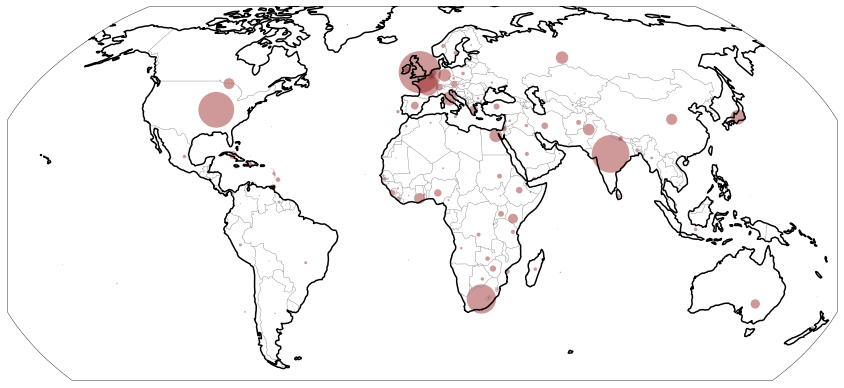

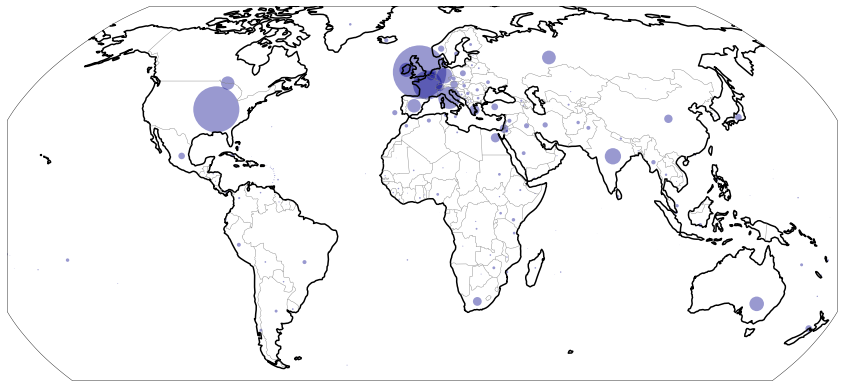

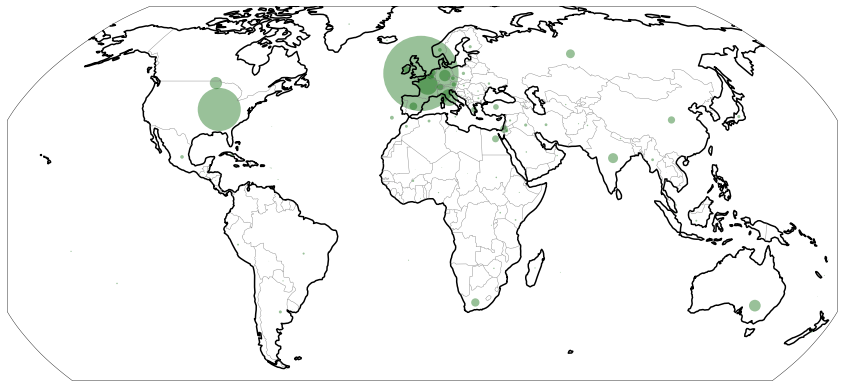

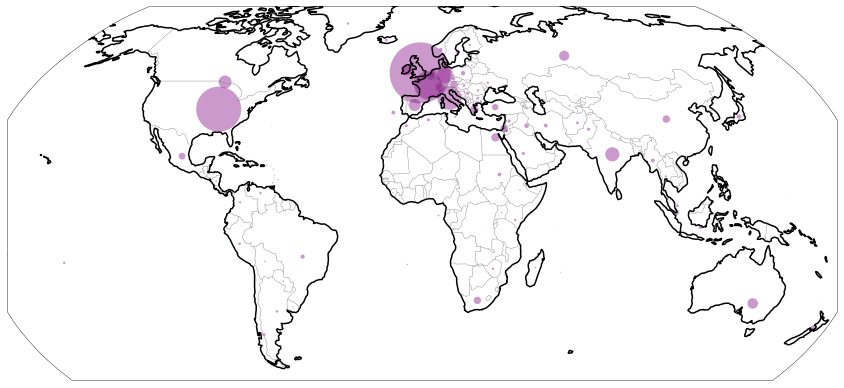

In [77]:
for name, group in corpus_grouped:
    extent = [-170, 170, -60, 80]
    figsz = (12,6)
    projection = ccrs.Robinson()
    hires=False
    tot_occurs = group.occurs_100k.sum()/10000
    nations = group[(group.country_short.notnull())].groupby('country_short')
    nations_tot = [int(i)/tot_occurs for i in nations.occurs_100k.sum()]
    nations_lon = [i for i in nations.lon.apply(np.mean)]
    nations_lat = [i for i in nations.lat.apply(np.mean)]
    color = colors[name]
    figname = 'map-nations-'+name
    bubblemap(figsz, nations_lat, nations_lon, nations_tot, color, extent, projection, hires, figname)

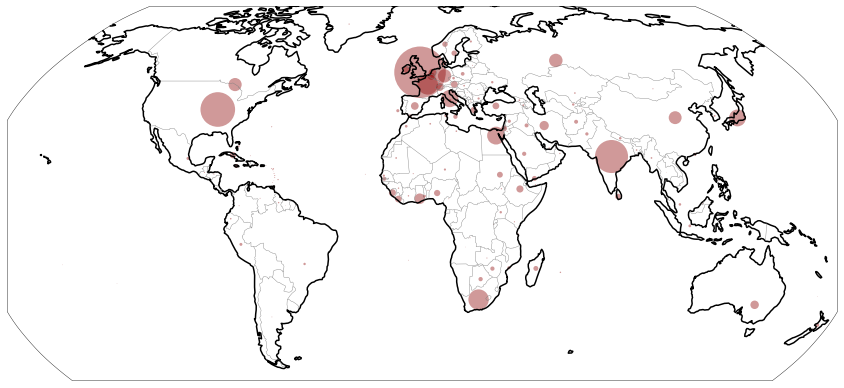

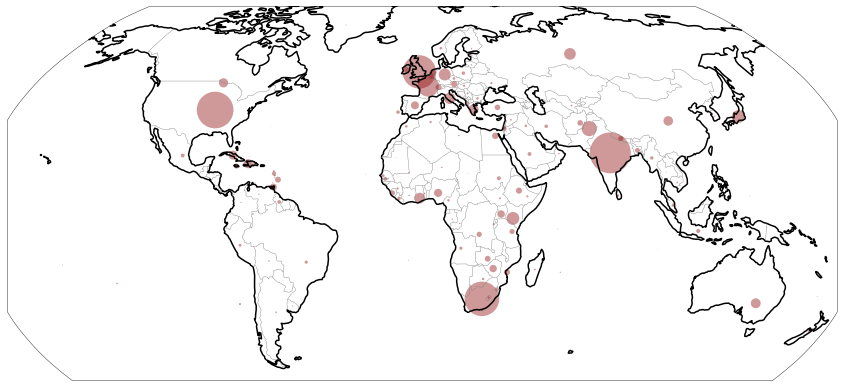

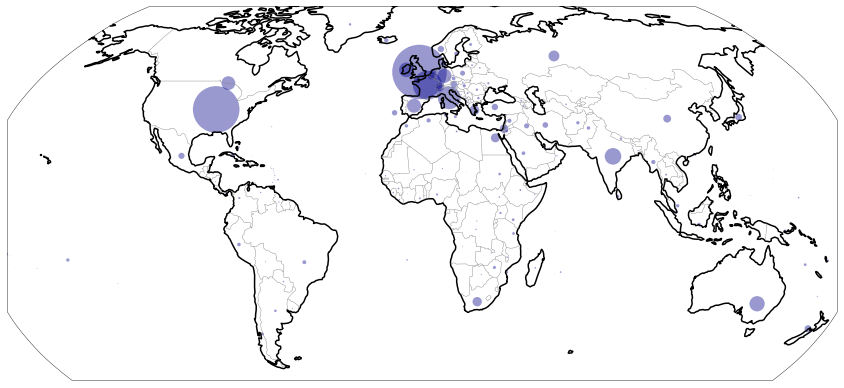

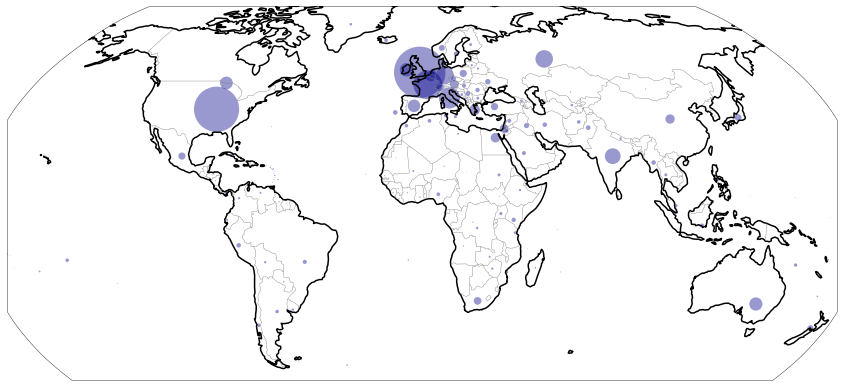

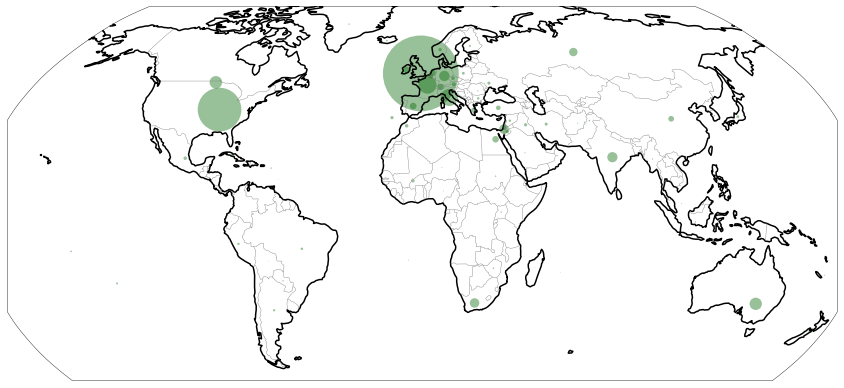

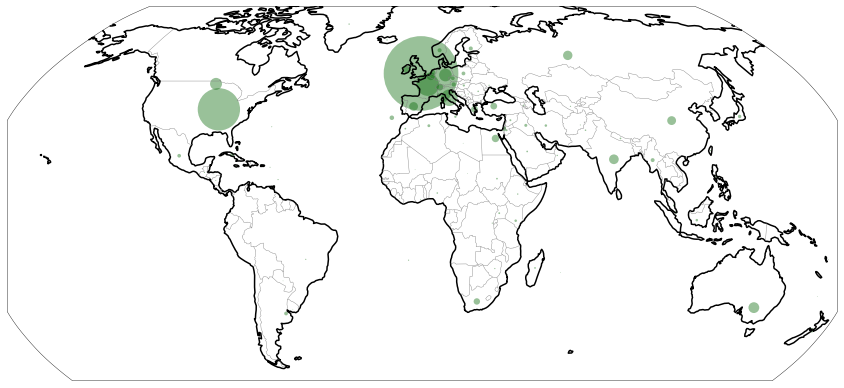

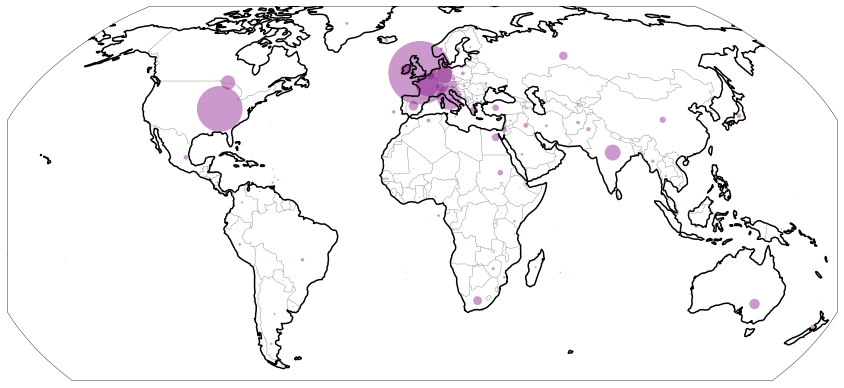

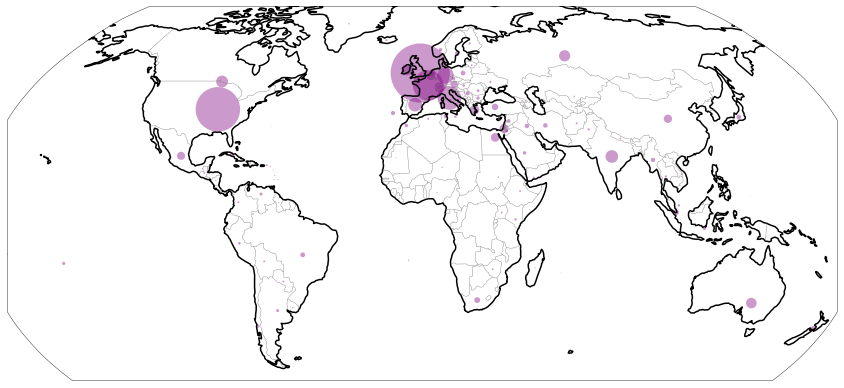

In [78]:
# World maps before and after 1914
# Total bubble areas normalized within each period
for name, group in corpus_grouped:
    pre = group.loc[(group.pub_date<1914)]
    post = group.loc[(group.pub_date>=1914)]
    extent = [-170, 170, -60, 80]
    figsz = (12,6)
    projection = ccrs.Robinson()
    hires=False
    #pre-1914
    tot_occurs = pre.occurs_100k.sum()/10000
    nations = pre[(pre.country_short.notnull())].groupby('country_short')
    nations_tot = [int(i)/tot_occurs for i in nations.occurs_100k.sum()]
    nations_lon = [i for i in nations.lon.apply(np.mean)]
    nations_lat = [i for i in nations.lat.apply(np.mean)]
    color = colors[name]
    figname = 'map-nations-'+name+'-1880-1913'
    bubblemap(figsz, nations_lat, nations_lon, nations_tot, color, extent, projection, hires, figname)
    #post-1914
    tot_occurs = post.occurs_100k.sum()/10000
    nations = post[(post.country_short.notnull())].groupby('country_short')
    nations_tot = [int(i)/tot_occurs for i in nations.occurs_100k.sum()]
    nations_lon = [i for i in nations.lon.apply(np.mean)]
    nations_lat = [i for i in nations.lat.apply(np.mean)]
    color = colors[name]
    figname = 'map-nations-'+name+'-1914-1940'
    bubblemap(figsz, nations_lat, nations_lon, nations_tot, color, extent, projection, hires, figname)    

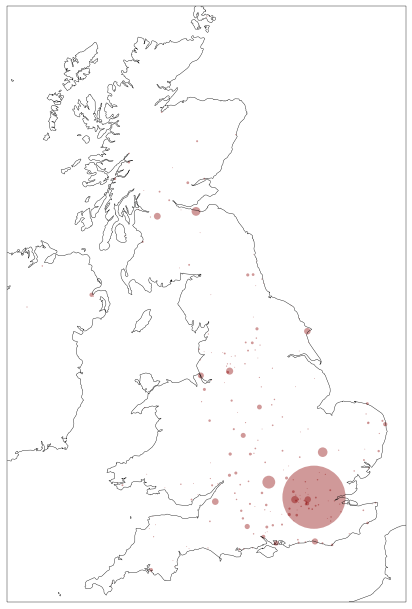

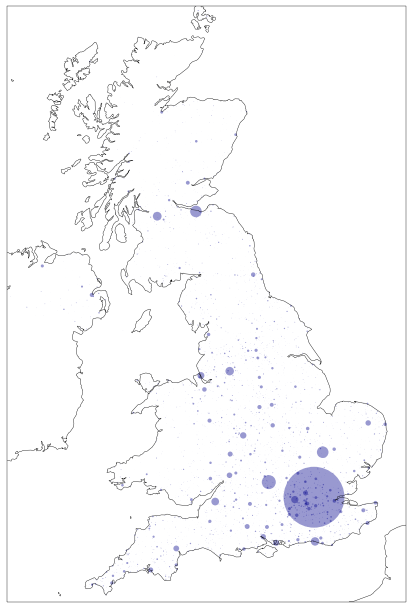

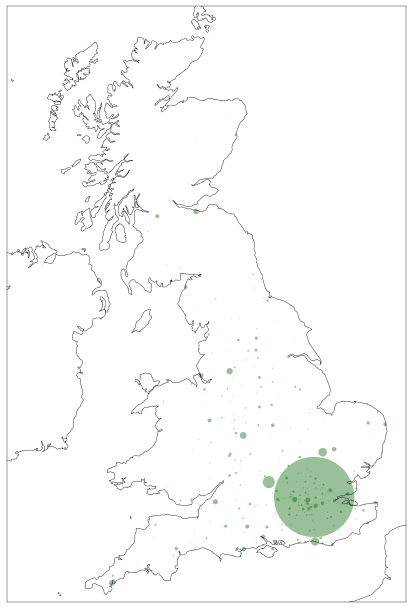

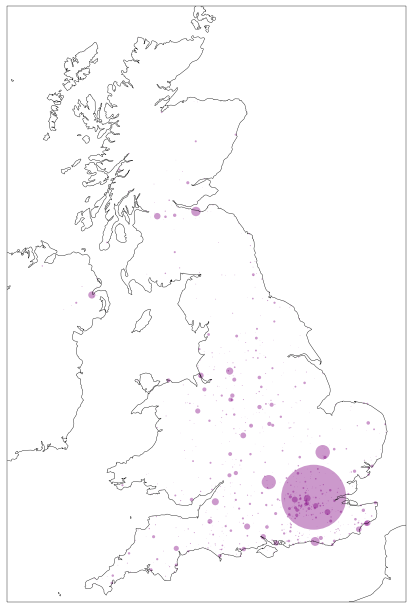

In [79]:
# Prepare and generate GB maps
for name, group in corpus_gb_grouped:
    extent = [-8, 2, 49.5, 59]
    figsz = (6,9)
    projection = ccrs.OSGB()
    hires=True
    tot_occurs = group.occurs_100k.sum()/10000
    cities = group[(group.locality.notnull())].groupby('locality')
    cities_tot = [int(i)/tot_occurs for i in cities.occurs_100k.sum()]
    cities_lon = [i for i in cities.lon.apply(np.mean)]
    cities_lat = [i for i in cities.lat.apply(np.mean)]
    color = colors[name]
    figname = 'map-gb-'+name
    bubblemap(figsz, cities_lat, cities_lon, cities_tot, color, extent, projection, hires, figname)

In [80]:
# A function to plot London city maps. Should roll into bubblemap(), but lazy.
def bubblemap_london(figsz, lats, lons, sizes, color, extent, name):
    '''Takes lists of lats, lons, and sizes.
    figsz is a tuple of dimensions in inches, e.g.: (12,12)
    Saves output file and displays map, but returns nothing.
    '''
    plt.figure(figsize=figsz)
    imagery = MapboxTiles(mapbox_key, 'mapbox.light')
    ax = plt.axes(projection=imagery.crs)
    if extent:
        ax.set_extent(extent)
    ax.add_image(imagery, 14)
    
    plt.scatter(lons, lats, s=sizes, linewidths=0,
                color=color, marker='o', alpha=0.4, transform=ccrs.Geodetic())

    plt.tight_layout()
    plt.savefig(os.path.join(figDir, name)+'.png', dpi=300)

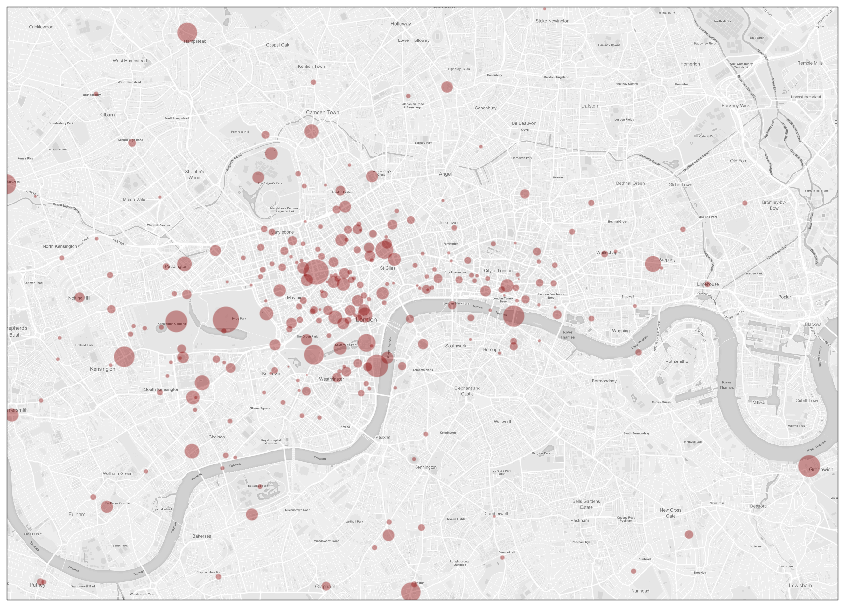

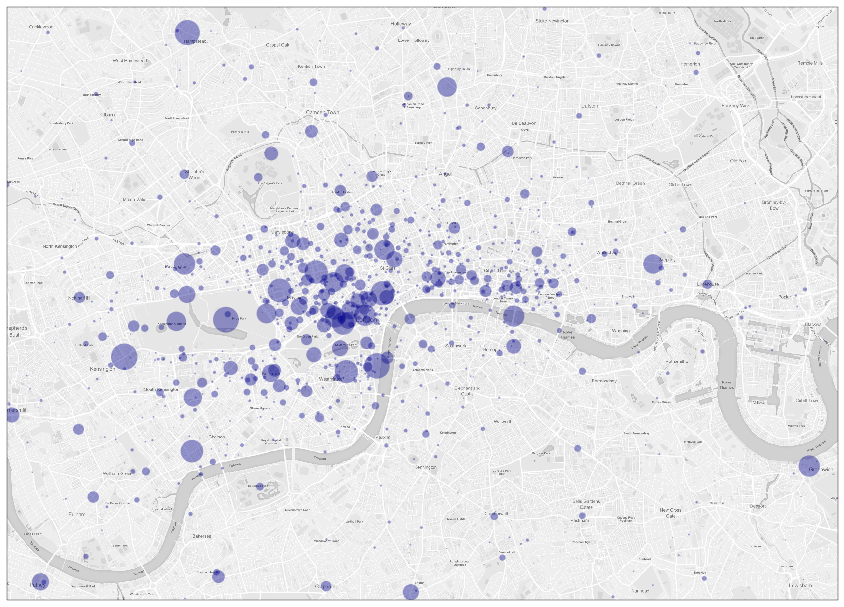

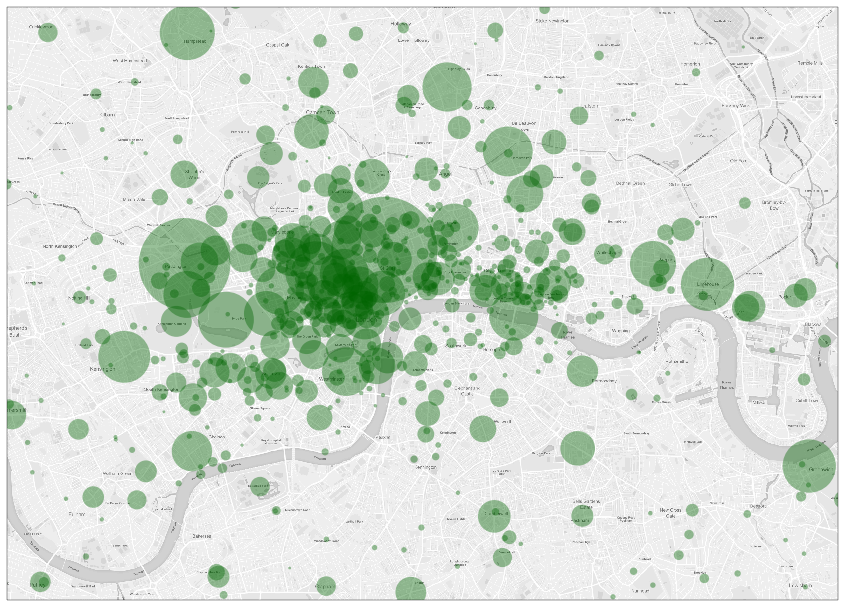

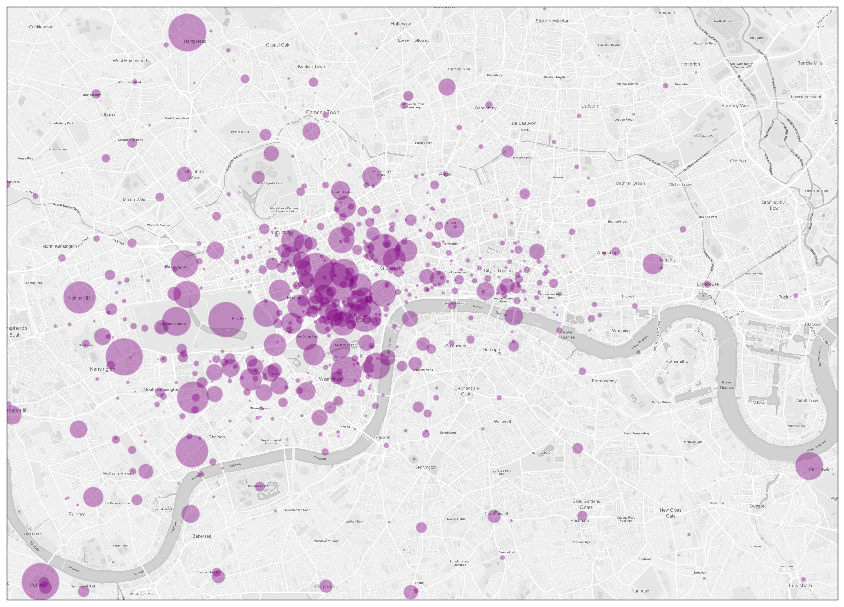

In [81]:
# London maps
for name, group in corpus_london_grouped:
    extent = [-0.225, 0, 51.46, 51.56]
    figsz = (12,9)
    figname = 'map-london-'+name
    london = group.loc[group.formatted_address != 'London, UK']
    latlons = london.groupby(['lat', 'lon']).occurs_100k.sum()/corpus_grouped.get_group(name).occurs_100k.sum()*1000000
    cities_tot = latlons.tolist()
    cities_lon = latlons.index.get_level_values('lon').tolist()
    cities_lat = latlons.index.get_level_values('lat').tolist()
    color = colors[name]
    bubblemap_london(figsz, cities_lat, cities_lon, cities_tot, color, extent, figname)

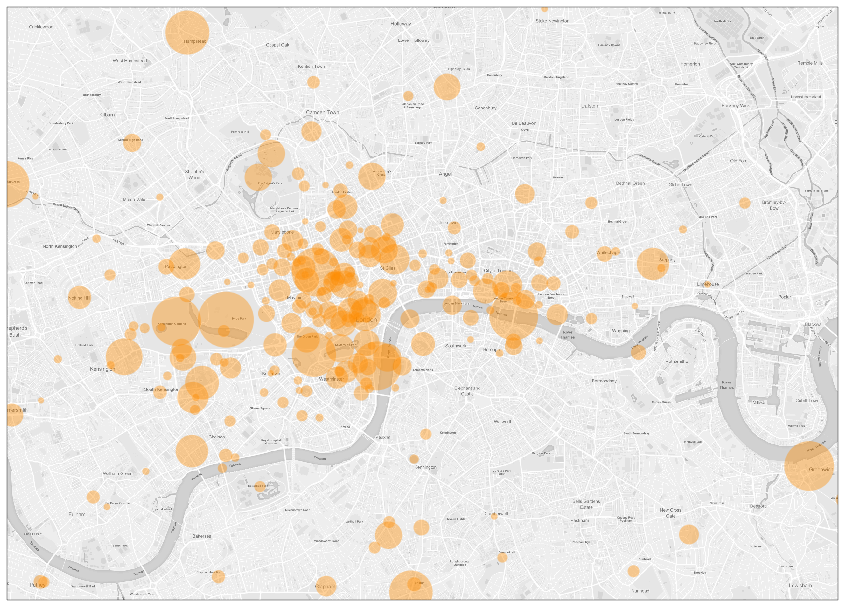

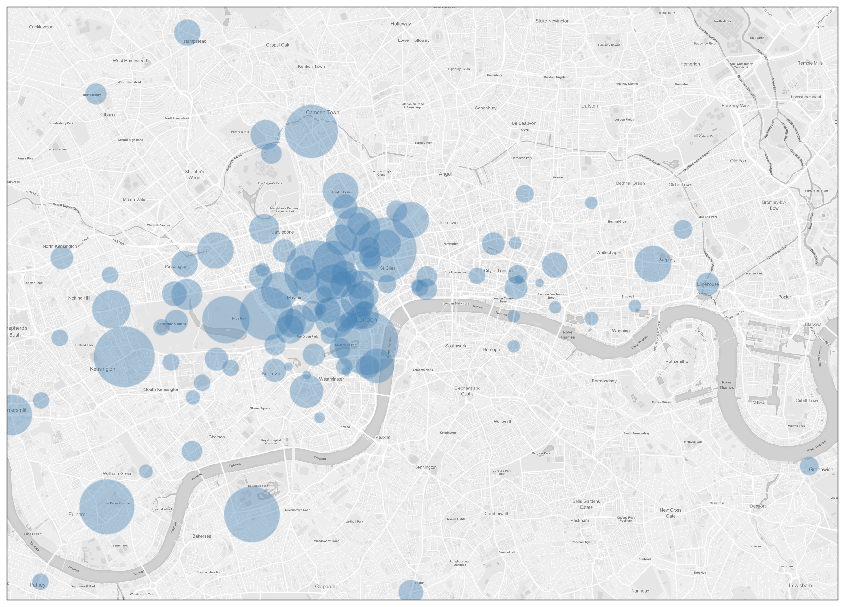

In [82]:
# ditto, just for white/non-white w/i for corpus
group  = corpus_london_grouped.get_group('Foreign')
london = group.loc[group.formatted_address != 'London, UK']
ethnicity = london.groupby('white')
for name, group in ethnicity:
    extent = [-0.225, 0, 51.46, 51.56]
    figsz = (12,9)
    latlons = group.groupby(['lat', 'lon']).occurs_100k.sum()/ethnicity.get_group(name).occurs_100k.sum()*100000
    cities_tot = latlons.tolist()
    cities_lon = latlons.index.get_level_values('lon').tolist()
    cities_lat = latlons.index.get_level_values('lat').tolist()
    color = colors[name]
    figname = 'map-london-Foreign-'+str.lower(name)
    bubblemap_london(figsz, cities_lat, cities_lon, cities_tot, color, extent, figname)

In [83]:
def map_eras(target):
    '''
    Function to map London locations in different eras within a corpus. 
    Takes a subcorpus tag.
    Returns nothing, but outputs maps to the figure directory.
    '''
    group  = corpus_london_grouped.get_group(target)
    london = group.loc[(group.formatted_address != 'London, UK')]
    early = london.loc[(london.pub_date <= 1900)]
    mid   = london.loc[((london.pub_date >= 1901) & (london.pub_date <= 1922))]
    include_late = False
    if london.pub_date.max() > 1922:
        late = london.loc[(london.pub_date >= 1923)]
        include_late = True

    color = colors[target]
    extent = [-0.225, 0, 51.46, 51.56]
    figsz = (12,9)

    latlons = early.groupby(['lat', 'lon']).occurs_100k.sum()/early.occurs_100k.sum()*100000
    cities_tot = latlons.tolist()
    cities_lon = latlons.index.get_level_values('lon').tolist()
    cities_lat = latlons.index.get_level_values('lat').tolist()
    figname = 'map-london-1880-1900-'+target
    bubblemap_london(figsz, cities_lat, cities_lon, cities_tot, color, extent, figname)

    latlons = mid.groupby(['lat', 'lon']).occurs_100k.sum()/mid.occurs_100k.sum()*100000
    cities_tot = latlons.tolist()
    cities_lon = latlons.index.get_level_values('lon').tolist()
    cities_lat = latlons.index.get_level_values('lat').tolist()
    figname = 'map-london-1901-1922-'+target
    bubblemap_london(figsz, cities_lat, cities_lon, cities_tot, color, extent, figname)

    if include_late:
        latlons = late.groupby(['lat', 'lon']).occurs_100k.sum()/late.occurs_100k.sum()*100000
        cities_tot = latlons.tolist()
        cities_lon = latlons.index.get_level_values('lon').tolist()
        cities_lat = latlons.index.get_level_values('lat').tolist()
        figname = 'map-london-1923-1940-'+target
        bubblemap_london(figsz, cities_lat, cities_lon, cities_tot, color, extent, figname)

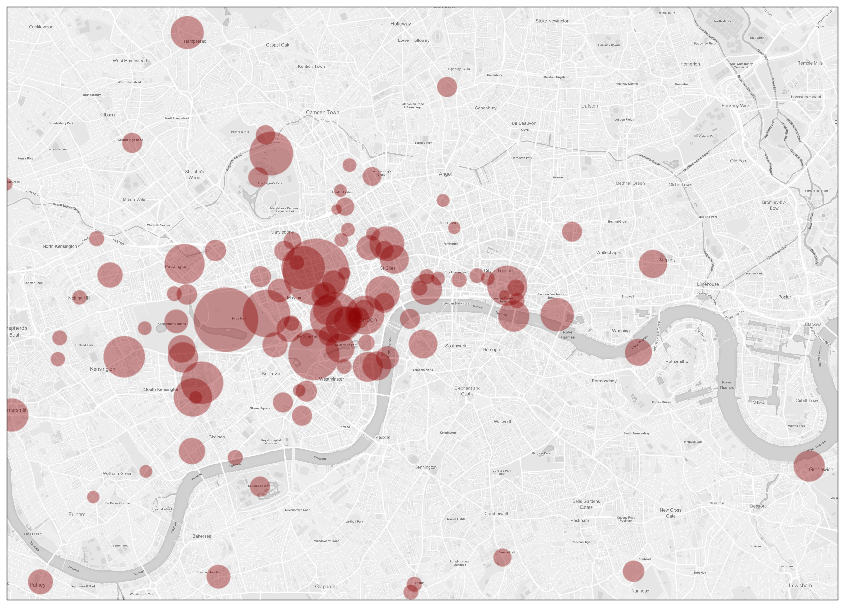

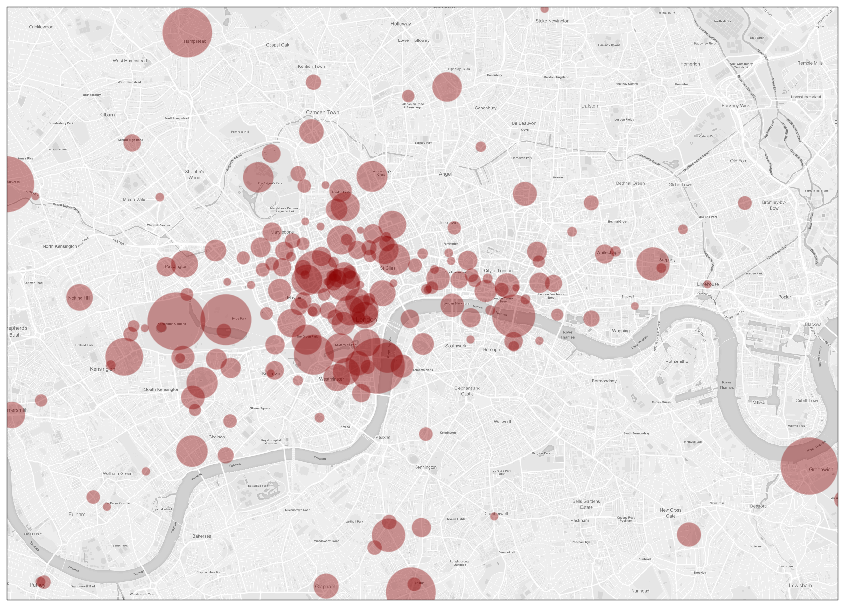

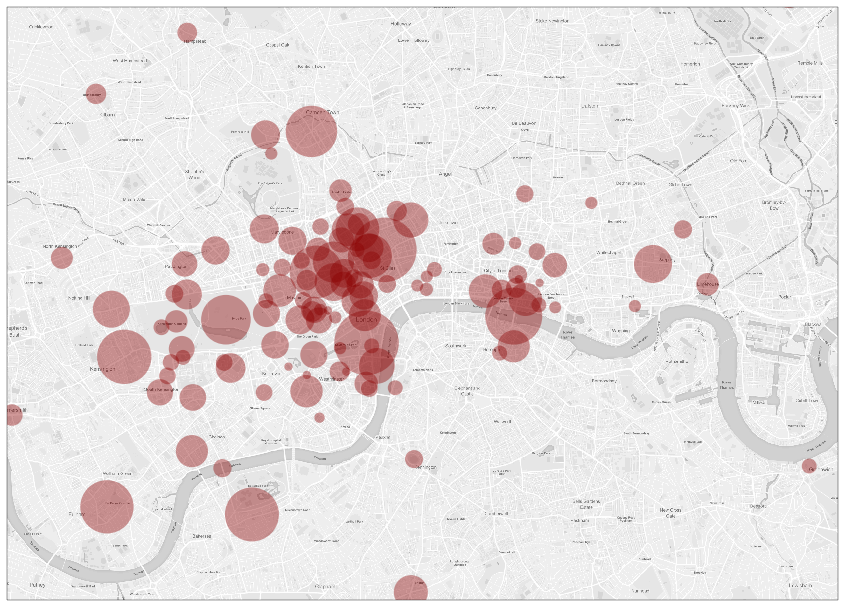

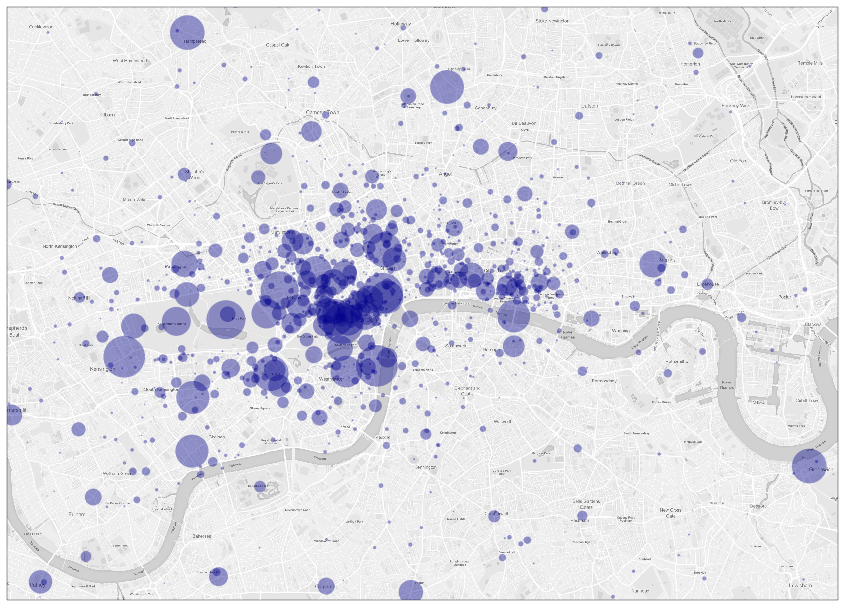

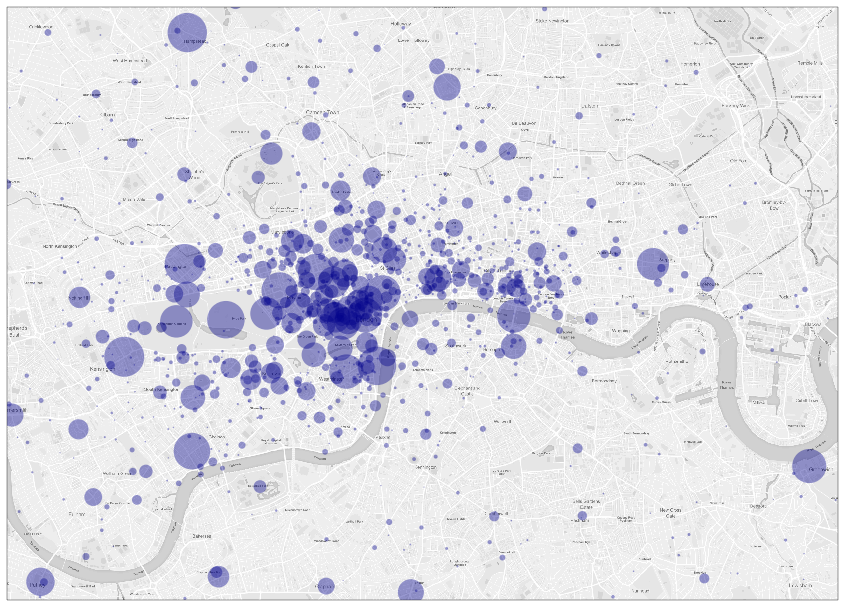

...

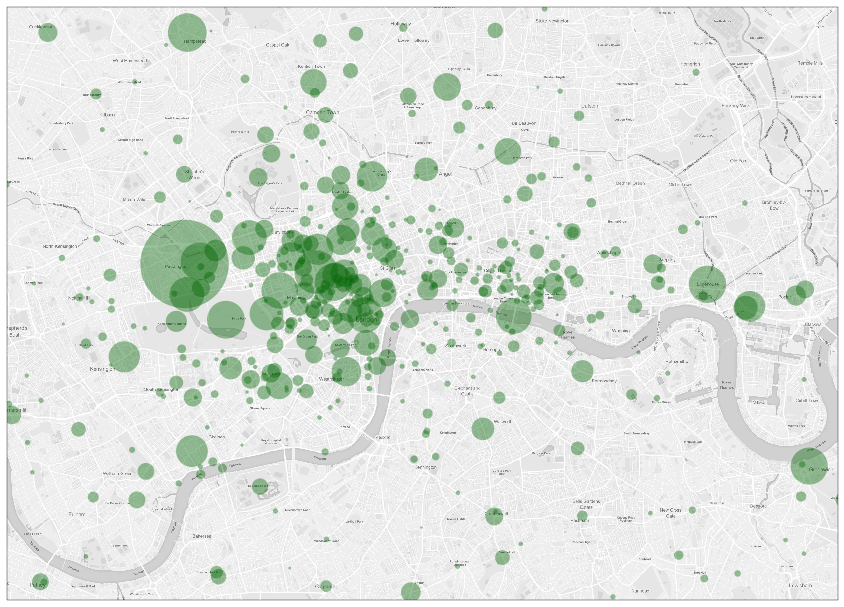

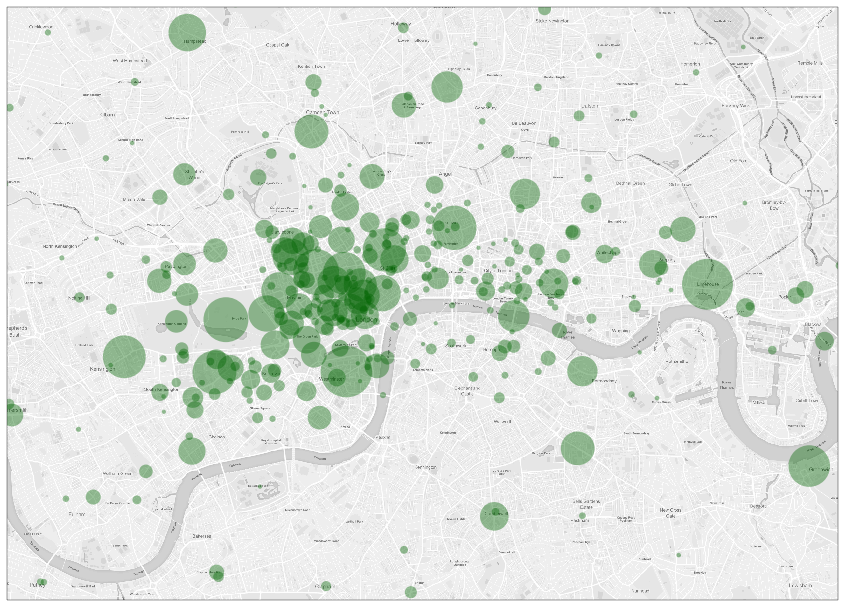

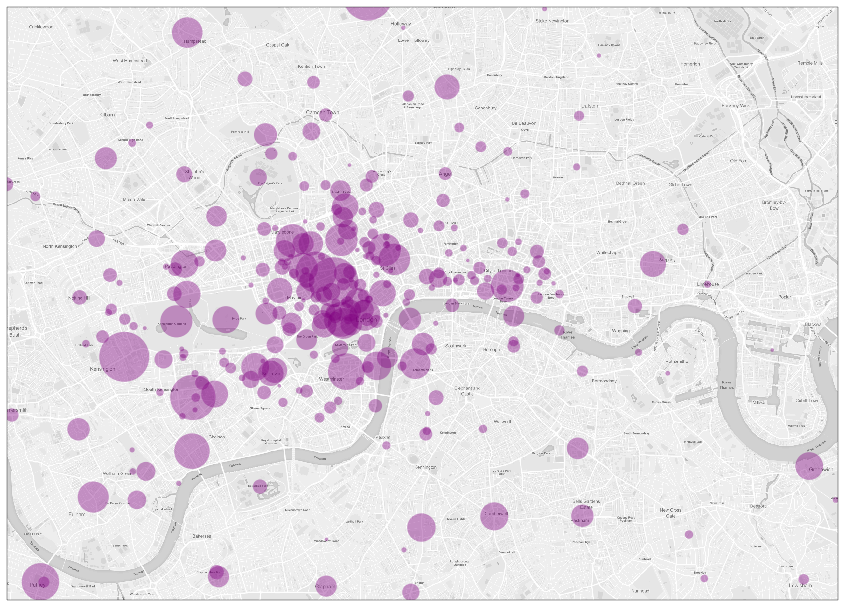

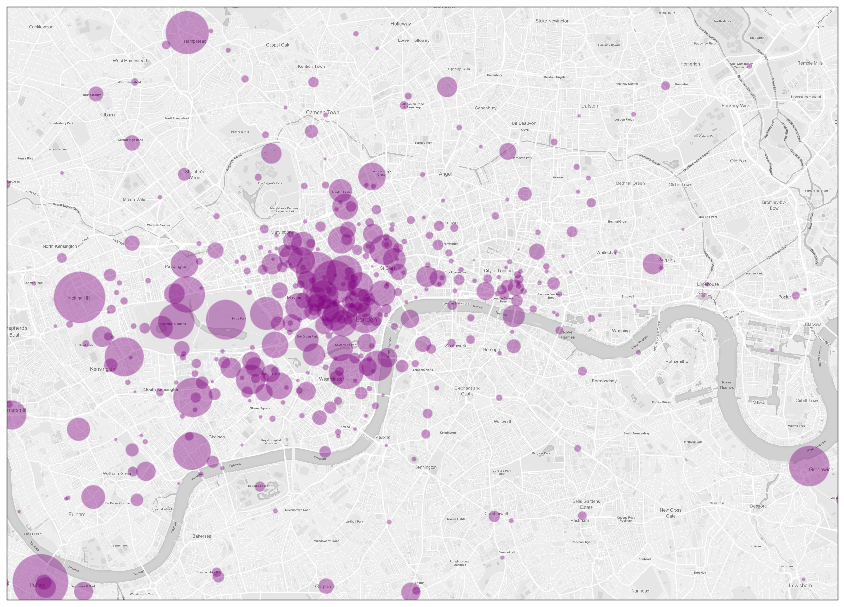

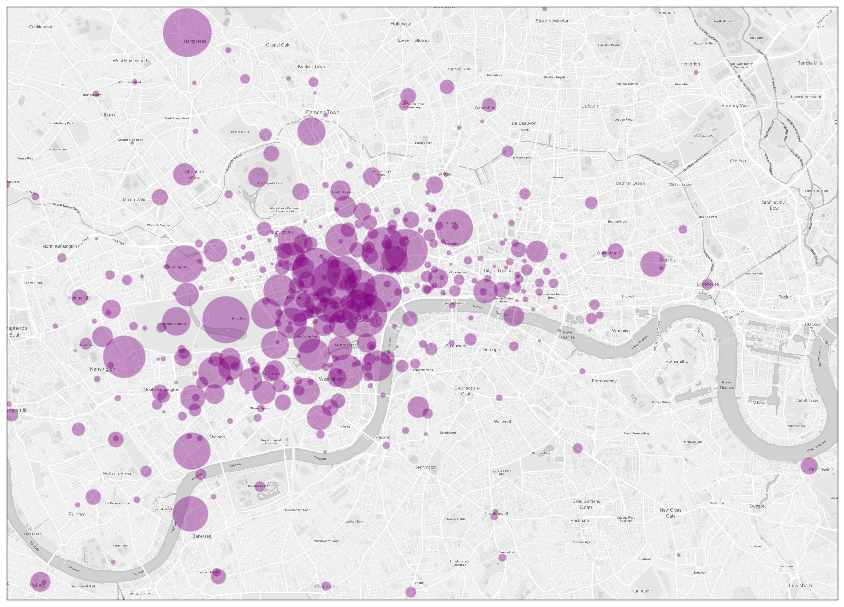

In [84]:
# ditto, for 1880-1900, 1901-22, and 1923-40
for target in corpus_london_grouped.groups.keys():
    map_eras(target)

### Map centers of gravity with uncertainty areas

#### All corpora

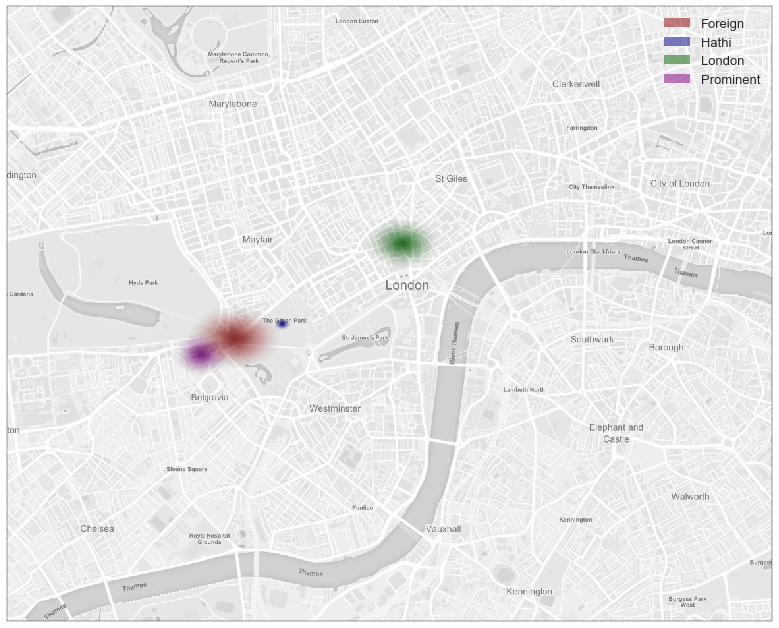

In [85]:
# All corpora
plt.figure(figsize=(12,9))
imagery = MapboxTiles(mapbox_key, 'mapbox.light')
ax = plt.axes(projection=imagery.crs)
#extent = [-0.225, 0, 51.46, 51.56]
extent = [-0.18, -0.08, 51.48, 51.53]
ax.set_extent(extent)
ax.add_image(imagery, 14)

steps = 100 # Number of gradient steps for uncertainty clouds

for name, group in cogg:
    model = sms.DescrStatsW(group[['avg_lat', 'avg_lon']], group['weight'])
    x = model.mean[1]
    y = model.mean[0]
    for i in range(steps):
        low, high = model.tconfint_mean(0.05 + 0.9*i/steps)
        width = high[1]-low[1]
        height = high[0]-low[0]
        #print(name, x,y, width, height)
        lab = None
        if i == 1:
            lab = name
        ax.add_patch(
            Ellipse(
                (x,y), 
                width, 
                height,
                transform=ccrs.Geodetic(), alpha=1/steps, color=colors[name], label = lab) 
        )
    #ax.plot(x, y, transform=ccrs.Geodetic(), marker='o', color='red') # Dot at center
# Build the legend
markers = []
texts = []

# And by ethnicity in Foreign
for name, group in cogg:
    markers.append(Rectangle((0,0), 1, 2, fc=colors[name], alpha=0.5))
    texts.append(name)
plt.legend(markers, texts)
plt.tight_layout()
plt.savefig(os.path.join(figDir, 'cog_by_corpus')+'.png', dpi=300)

#### By era in all corpora

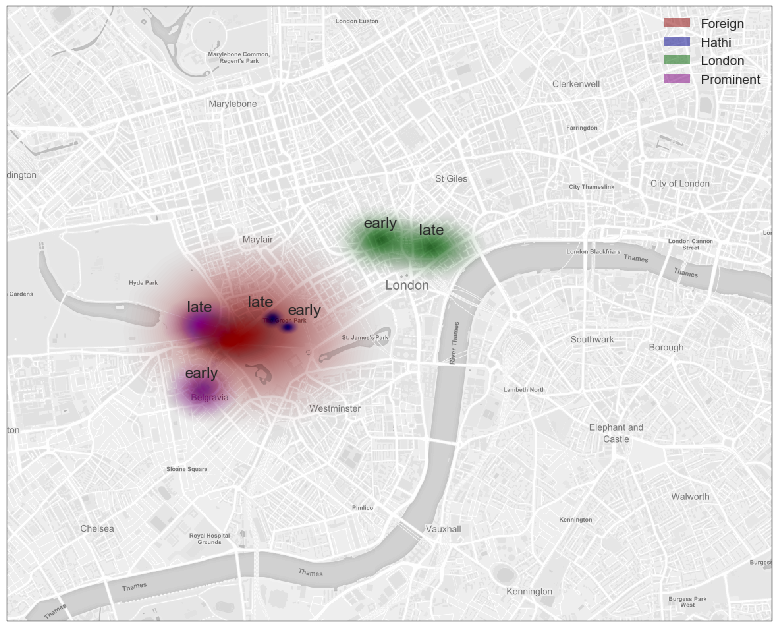

In [86]:
# All corpora by era
plt.figure(figsize=(12,9))
imagery = MapboxTiles(mapbox_key, 'mapbox.light')
ax = plt.axes(projection=imagery.crs)
extent = [-0.18, -0.08, 51.48, 51.53]
ax.set_extent(extent)
ax.add_image(imagery, 14)

steps = 100 # Number of gradient steps for uncertainty clouds

for name, group in cogg:
    for era, subgroup in group.groupby('era'):
        model = sms.DescrStatsW(subgroup[['avg_lat', 'avg_lon']], subgroup['weight'])
        x = model.mean[1]
        y = model.mean[0]
        for i in range(steps):
            low, high = model.tconfint_mean(0.05 + 0.9*i/steps)
            width = high[1]-low[1]
            height = high[0]-low[0]
            lab = None
            if i == 1:
                lab = name+'-'+era
            ax.add_patch(
                Ellipse(
                    (x,y), 
                    width, 
                    height,
                    transform=ccrs.Geodetic(), alpha=1/steps, color=colors[name], label = lab) 
            )
        # add text labels
        if name != 'Foreign':
            if name == 'Hathi':
                if era == 'early':
                    ax.text(x, 1.00002*y, era, ha='left', transform=ccrs.Geodetic())
                else:
                    ax.text(x, 1.00002*y, era, ha='right', transform=ccrs.Geodetic())
            else:
                ax.text(x, 1.00002*y, era, ha='center', transform=ccrs.Geodetic())
            
# Build the legend
markers = []
texts = []
for name, group in cogg:
    markers.append(Rectangle((0,0), 1, 2, fc=colors[name], alpha=0.5))
    texts.append(name)
plt.legend(markers, texts)
plt.tight_layout()
plt.savefig(os.path.join(figDir, 'cog_by_corpus_and_era')+'.png', dpi=300)

#### Ethnicity in Foreign

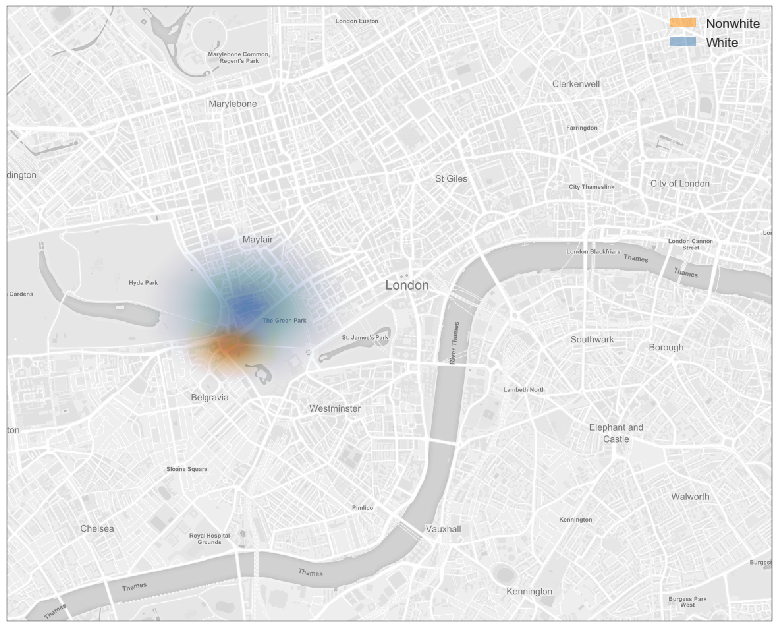

In [87]:
# Ethnicity in Foreign
plt.figure(figsize=(12,9))
imagery = MapboxTiles(mapbox_key, 'mapbox.light')
ax = plt.axes(projection=imagery.crs)
extent = [-0.18, -0.08, 51.48, 51.53]
ax.set_extent(extent)
ax.add_image(imagery, 14)

for name, group in cogg.get_group('Foreign').groupby('ethnicity'):
    model = sms.DescrStatsW(group[['avg_lat', 'avg_lon']], group['weight'])
    x = model.mean[1]
    y = model.mean[0]
    for i in range(steps):
        low, high = model.tconfint_mean(0.05 + 0.9*i/steps)
        width = high[1]-low[1]
        height = high[0]-low[0]
        lab = None
        if i == 1:
            lab = name
        ax.add_patch(
            Ellipse(
                (x,y), 
                width, 
                height,
                transform=ccrs.Geodetic(), alpha=1/steps, color=colors[name], label = lab) 
        )
        
# Build the legend
markers = []
texts = []
for name, group in cogg.get_group('Foreign').groupby('ethnicity'):
    markers.append(Rectangle((0,0), 1, 2, fc=colors[name], alpha=0.5))
    texts.append(name)
plt.legend(markers, texts)
plt.tight_layout()
plt.savefig(os.path.join(figDir, 'cog_by_ethnicity_in_foreign')+'.png', dpi=300)

#### Genre in Foreign

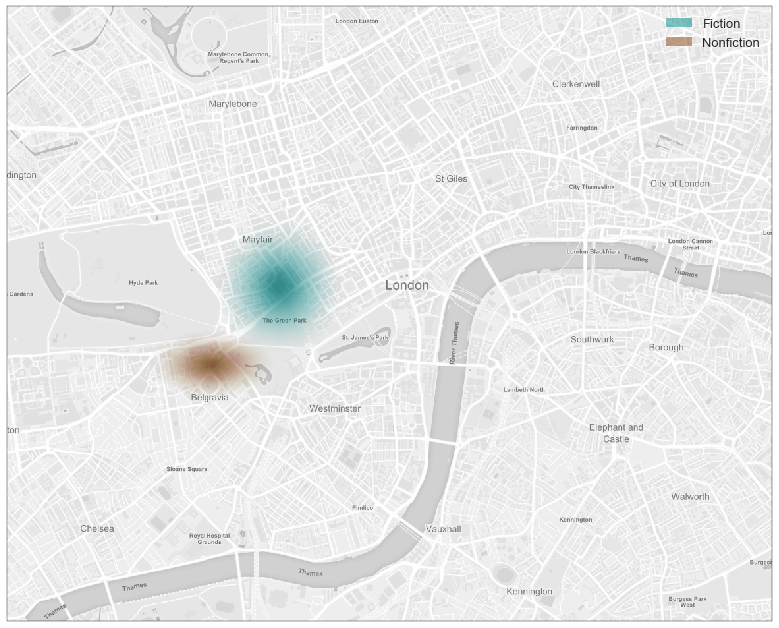

In [88]:
# Genre in foreign
plt.figure(figsize=(12,9))
imagery = MapboxTiles(mapbox_key, 'mapbox.light')
ax = plt.axes(projection=imagery.crs)
extent = [-0.18, -0.08, 51.48, 51.53]
ax.set_extent(extent)
ax.add_image(imagery, 14)

for name, group in cogg.get_group('Foreign').groupby('genre'):
    model = sms.DescrStatsW(group[['avg_lat', 'avg_lon']], group['weight'])
    x = model.mean[1]
    y = model.mean[0]
    for i in range(steps):
        low, high = model.tconfint_mean(0.05 + 0.9*i/steps)
        width = high[1]-low[1]
        height = high[0]-low[0]
        #print(name, x,y, width, height)
        lab = None
        if i == 1:
            lab = name
        ax.add_patch(
            Ellipse(
                (x,y), 
                width, 
                height,
                transform=ccrs.Geodetic(), alpha=1/steps, color=colors[name], label = lab) 
        )
# Build the legend
markers = []
texts = []
for name, group in cogg.get_group('Foreign').groupby('genre'):
    markers.append(Rectangle((0,0), 1, 2, fc=colors[name], alpha=0.5))
    texts.append(name)
plt.legend(markers, texts)
plt.tight_layout()
plt.savefig(os.path.join(figDir, 'cog_by_genre_in_foreign')+'.png', dpi=300)